# Lending Club Data Analysis

In [8]:
loan <- read.csv("loan.csv", stringsAsFactors = FALSE)


In [9]:
head(loan,3)

id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,⋯,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m
1077501,1296599,5000,5000,4975,36 months,10.65,162.87,B,B2,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
1077430,1314167,2500,2500,2500,60 months,15.27,59.83,C,C4,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
1077175,1313524,2400,2400,2400,36 months,15.96,84.33,C,C5,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA


## meaning of the columns

In [10]:
library(readxl)
col.info <- read_excel("LCDataDictionary.xlsx")
col.info

LoanStatNew,Description
User feature (general),NA
addr_state,The state provided by the borrower in the loan application
emp_length,Employment length in years. Possible values are between 0 and 10 where 0 means less than one year and 10 means ten or more years.
emp_title,The job title supplied by the Borrower when applying for the loan.*
home_ownership,"The home ownership status provided by the borrower during registration. Our values are: RENT, OWN, MORTGAGE, OTHER."
member_id,A unique LC assigned Id for the borrower member.
zip_code,The first 3 numbers of the zip code provided by the borrower in the loan application.
NA,NA
User feature (financial specific),NA
Income,NA


## objective
predict int_rate (regression model)

## Clean Data
skip because it is table like

## Explore Data
variable identificaiton  
    a. type of variable  
    b. type of data  
    c. variable category  

## type of variable

* response variable: int_rate

In [11]:
response = loan$int_rate

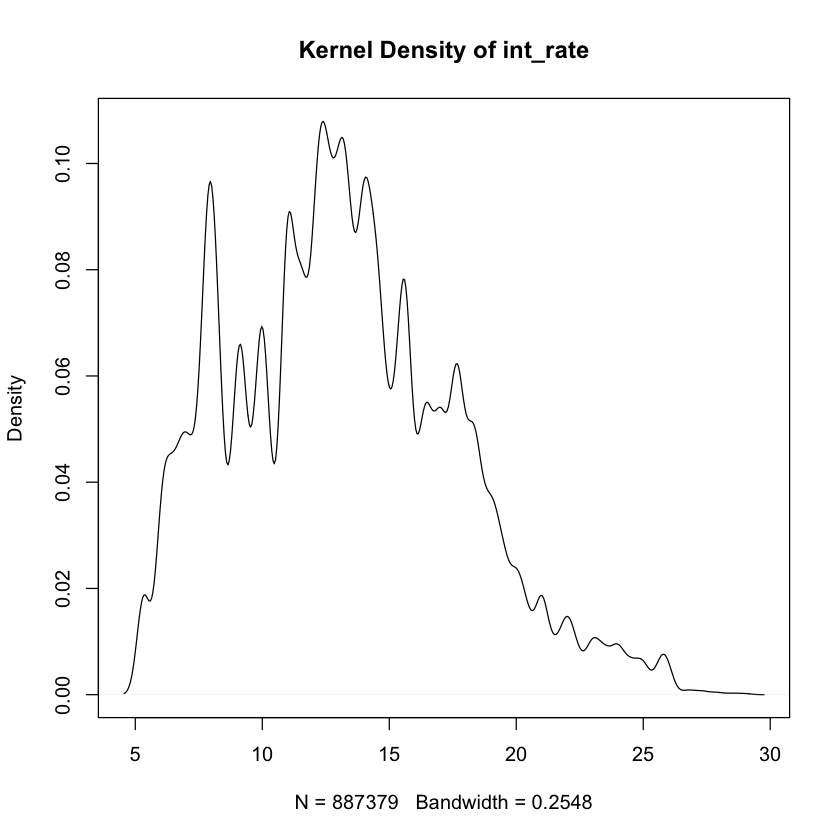

In [12]:
d <- density(response)
plot(d, main="Kernel Density of int_rate")
#polygon(d, col="red", border="blue")

### Notes: 
The density plot has lots of peak and valley, it is not one or two normal distribution add together, the possible reason is the data includes lots of groups in it.


* features: all other variable

In [13]:
features = loan[,-which(names(loan) == "int_rate")]

### data type
* numerical
    + continuous: e.g. int_rate
    + discrete: e.g. inq_fi (Number of personal finance inquires)

* categorical
    + ordinal: e.g. grade
    + nominal: e.g. zip code
### Attention: data type may not like the type it loaded into

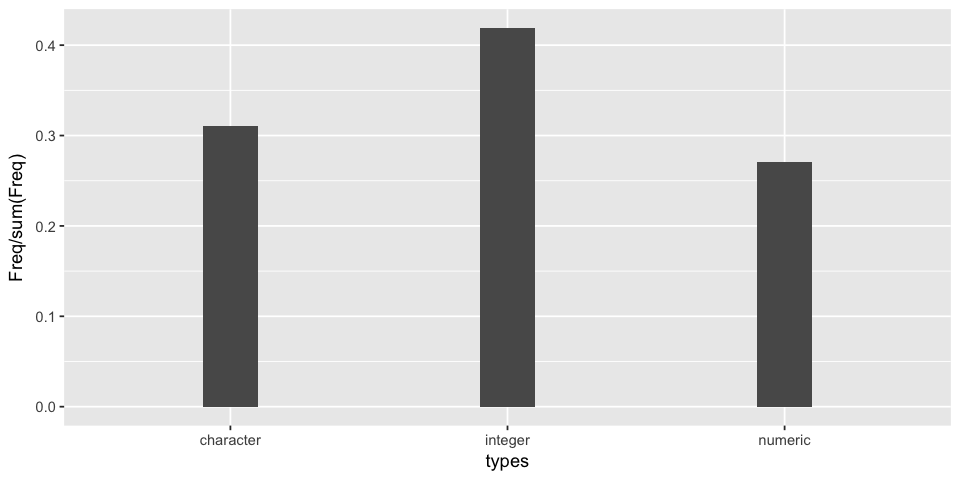

In [14]:
library(ggplot2)
# apply function class to all load columns
types = sapply(loan, class)
# convert types to data.frame
# `table` calculate the frequency
df.types = data.frame(table(types), row.names = NULL)
# visualization
options(repr.plot.width=8, repr.plot.height=4)
ggplot(data = df.types,
       aes(x = types, y = Freq/sum(Freq))) + 
geom_bar(stat = "identity", width = 0.2)

### question to ask: why my integer is different than yours? 



In [8]:
library(zoo)
# zoo is a library for time series data 
# check data type
# User feature (general) -----------------------------------------
# addr_state(categorical: nominal)
# loan$addr_state[1] --- correct
# emp_length(numerical: discrete)
# could be changed to numeric
#
#substr(loan$emp_length[1],1,2) # not numerical
#gsub() function replaces all matches of a string,
# gsub(pattern, replacement, x, ignore.case = FALSE, perl = FALSE,
#     fixed = FALSE, useBytes = FALSE)
#     # deinfe a function extract numbers from string
#     str2num <- function(str){
#         as.numeric(gsub("([^0-9])", "", str))
#     }
#
#     loan$emp_length = sapply(loan$emp_length, str2num)

# emp_title(categorical: nominal
# unique(loan$emp_title) --- correct
# emp_title has upper, lower case and different types of writing, 
# needs more preprocessing

# home_ownership(categorical: nominal)
# loan$home_ownership[1] --- correct

# member_id won't use it


# zip code(categorical: nominal)
# loan$zip_code[1] --- correct

# ------------------------------------------------------------

# user feature(financial specific) ---------------------------

# annual_inc(numerical: continuous)
# loan$annual_inc[1] --- correct

# annual_inc_joint(numerical: continuous)
# unique(loan$annual_inc_joint) --- correct but lots of missing value

# is_inc_v(binary) : missing feature

# verified_status : no use, all feature has same value
# unique(loan$verification_status[1])

# verified_status_joint(categorical: nominal)
# unique(loan$verification_status_joint) --- correct

# dti(numerical: continous)
# loan$dti[6] --- correct

# dti_joint(numerical: continous)
# loan$dti_joint[1] --- missing

# ------------------------------------------------------------

# credit scores ----------------------------------------------

# earliest_cr_line(categorical) could be splitted to year and mon
loan$earliest_cr_line_date = as.Date(as.yearmon(loan$earliest_cr_line, "%b-%Y"))
loan$earliest_cr_line_year = format(loan$earliest_cr_line_date, "%Y")
loan$earliest_cr_line_mon = format(loan$earliest_cr_line_date, "%m")

# fico_range_high: missing
# fico_range_low: missing
# last_fico_range_high: missing
# last_fico_range_low: missing


# inq_fi(numerical : discrete)
# class(loan$inq_fi) --- correct

# inq_last_12m(numerical : discrete)
# class(loan$inq_last_12m) --- correct

# inq_last_6mths(numerical : discrete)
# class(loan$inq_last_6mths) --- correct

# last_credit_pull_d(categorical) could be splitted to year and mon
loan$last_credit_pull_d_date = as.Date(as.yearmon(loan$last_credit_pull_d, "%b-%Y"))
loan$last_credit_pull_d_year = format(loan$last_credit_pull_d_date, "%Y")
loan$last_credit_pull_d_mon = format(loan$last_credit_pull_d_date, "%m")

# ------------------------------------------------------------

# credit lines -----------------------------------------------

# total_acc(numerical : discrete)
# loan$total_acc[1] --- correct

# tot_cur_bal(numerical : continous)
# loan$tot_cur_bal[1] --- correct

# all_util(numerical : continous)
# loan$all_util[1] --- correct

# open_acc(numerical : discrete)
# loan$open_acc[1] --- correct

# open_acc_6m(numerical : discrete)
# loan$open_acc_6m[1]

# total_cu_tl(numerical : discrete)
# loan$total_cu_tl[1] --- correct

# acc_noew_delinq(numerical : discrete)
# loan$total_cu_tl[1] --- correct

# delinq_2yrs(numerical : discrete)
#  unique(loan$delinq_2yrs) --- correct

# mths_since_last_delinq(numerical : discrete)
#  unique(loan$mths_since_last_delinq) --- correct

# collections_12_mths_ex_med(numerical : discrete)
#  unique(loan$collections_12_mths_ex_med) --- correct

# tot_coll_amt(numerical : discrete)
# unique(loan$tot_coll_amt) --- correct

# pub_rec(numerical : discrete)
#  unique(loan$pub_rec) --- correct

# mths_since_last_major_derog(numerical : discrete)
# unique(loan$mths_since_last_major_derog) --- correct

# mths_since_last_record(numerical : discrete)
#  unique(loan$mths_since_last_record) --- correct

# il_util(numerical : continuous)
#  loan$il_util[1] --- correct

# mths_since_rcnt_il(numerical : discrete)
#  unique(loan$mths_since_rcnt_il) ---correct

# open_il_12m(numerical : discrete)
#  unique(loan$open_il_12m) ---correct

# open_il_24m(numerical : discrete)
#  unique(loan$open_il_24m) ---correct

# open_il_6m(numerical : discrete)
#  unique(loan$open_il_6m) ---correct


# total_bal_il(numerical : discrete)
# unique(loan$total_bal_il) --- correct but could be continuous

# max_bal_bc(numerical : continuous)
#  unique(loan$max_bal_bc) --- correct

# open_rv_12m(numerical : discrete)
#  unique(loan$open_rv_12m) --- correct

# open_rv_24m(numerical : discrete)
#  unique(loan$open_rv_24m) --- correct

# revol_bal(numerical : continuous)
#  loan$revol_bal[1] --- correct

# revol_util(numerical : continuous)
#  loan$revol_util[1] --- correct

# total_rev_hi_lim(numerical : continuous)
#  loan$total_rev_hi_lim --- correct

# loan$policy_code(binary) : no use, unique value
#  unique(loan$policy_code)

# url(string) contain loan_id info, which is not useful
#  loan$url[1]

# ------------------------------------------------------------

# loan general feature ---------------------------------------

# application_type(categorical : nominal)
#   unique(loan$application_type) --- correct

# desc(string) might be useful, but need nlp
#   loan$desc[1]

# id : not useful

# purpose(categorical : nominal)
#   unique(loan$purpose) --- correct

# term(categorical : nominal)
#   unique(loan$term) --- correct 

# issue_d(categorical) could be splitted to year and mon
loan$issue_d_date = as.Date(as.yearmon(loan$issue_d, "%b-%Y"))
loan$issue_d_year = format(loan$issue_d_date, "%Y")
loan$issue_d_mon = format(loan$issue_d_date, "%m")


# inital_list_status(binary)
#   unique(loan$initial_list_status)

# ------------------------------------------------------------

# loan payment feature ---------------------------------------

# loan_amnt(numerical : continuous)
#   unique(loan$loan_amnt) --- correct

# installment(numerical : continuous)
#   unique(loan$installment) --- correct

# funded_amnt(numerical : continuous)
#   loan$funded_amnt[1] ---correct

# funded_amnt_inv(numerical : continuous)
#   loan$funded_amnt_inv[1] --- correct

# last_pymnt_amnt(numerical : continuous)
#   loan$last_pymnt_amnt --- correct

# last_pymnt_d(categorical)
loan$last_pymnt_d_date = as.Date(as.yearmon(loan$last_pymnt_d, "%b-%Y"))
loan$last_pymnt_d_year = format(loan$last_pymnt_d_date, "%Y")
loan$last_pymnt_d_mon = format(loan$last_pymnt_d_date, "%m")

# next_pymnt_d(categorical)
loan$next_pymnt_d_date = as.Date(as.yearmon(loan$next_pymnt_d, "%b-%Y"))
loan$next_pymnt_d_year = format(loan$next_pymnt_d_date, "%Y")
loan$next_pymnt_d_mon = format(loan$next_pymnt_d_date, "%m")

# pymnt_plan(binary)
#    unique(loan$pymnt_plan)

# recoveries(numerical : continuous)
#    loan$recoveries[1] --- correct

# total_pymnt(numerical : continuous)
#    loan$total_pymnt[1] --- correct

# total_pymnt_inv(numerical : continuous)
#    loan$total_pymnt_inv[1] --- correct

# total_rec_int(numerical : continuous)
#    loan$total_rec_int[1] --- correct

# total_rec_late_fee(numerical : continuous)
#    loan$total_rec_late_fee[1] --- correct

# total_rec_prncp(numerical : continuous)
#    loan$total_rec_prncp[1] --- correct

# collection_recovery_fee(numerical : continuous)
#    hist(loan$collection_recovery_fee)

# out_prncp(numerical : continuous)
# hist(loan$out_prncp) --- correct, skew

# out_prncp_inv(numerical : continuous)
# hist(loan$out_prncp_inv) --- correct skew

# ------------------------------------------------------------

# Potential response variables -------------------------------

# grade(categorical : ordinal)
# plot(table(loan$grade)) --- correct, skew

# sub_grade(categorical : ordinal)
# plot(table(loan$sub_grade)) --- correct ,skew

# int_rate(numerical : continuous)
# hist(loan$int_rate)

# loan_status(categorical : nominal)
# unique(loan$loan_status) --- correct


Attaching package: ‘zoo’

The following objects are masked from ‘package:base’:

    as.Date, as.Date.numeric



### missing value treatment
* Remove features with too many missing value, or remove all rows with NA if you have a lot of data
* If not missing at random, add new level to represent NA, impute with 0, or generate new feature.
* If missing at random, imputation using summary stats or modeling way.

In [16]:
num.NA <- sort(colSums(sapply(loan, is.na)))
num.NA

id                   member_id 
                          0                           0 
                  loan_amnt                 funded_amnt 
                          0                           0 
            funded_amnt_inv                        term 
                          0                           0 
                   int_rate                 installment 
                          0                           0 
                      grade                   sub_grade 
                          0                           0 
                  emp_title                  emp_length 
                          0                           0 
             home_ownership         verification_status 
                          0                           0 
                    issue_d                 loan_status 
                          0                           0 
                 pymnt_plan                         url 
                          0                           0 
                       desc                     purpose 
                          0                           0 
                      title                    zip_code 
                          0                           0 
                 addr_state                         dti 
                          0                           0 
           earliest_cr_line                   revol_bal 
                          0                           0 
        initial_list_status                   out_prncp 
                          0                           0 
              out_prncp_inv                 total_pymnt 
                          0                           0 
            total_pymnt_inv             total_rec_prncp 
                          0                           0 
              total_rec_int          total_rec_late_fee 
                          0                           0 
                 recoveries     collection_recovery_fee 
                          0                           0 
               last_pymnt_d             last_pymnt_amnt 
                          0                           0 
               next_pymnt_d          last_credit_pull_d 
                          0                           0 
                policy_code            application_type 
                          0                           0 
  verification_status_joint                  annual_inc 
                          0                           4 
                delinq_2yrs              inq_last_6mths 
                         29                          29 
                   open_acc                     pub_rec 
                         29                          29 
                  total_acc              acc_now_delinq 
                         29                          29 
 collections_12_mths_ex_med                  revol_util 
                        145                         502 
               tot_coll_amt                 tot_cur_bal 
                      70276                       70276 
           total_rev_hi_lim      mths_since_last_delinq 
                      70276                      454312 
mths_since_last_major_derog      mths_since_last_record 
                     665676                      750326 
                open_acc_6m                  open_il_6m 
                     866007                      866007 
                open_il_12m                 open_il_24m 
                     866007                      866007 
               total_bal_il                 open_rv_12m 
                     866007                      866007 
                open_rv_24m                  max_bal_bc 
                     866007                      866007 
                   all_util                      inq_fi 
                     866007                      866007 
                total_cu_tl                inq_last_12m 
                     866007                      866007 
         mths_since_rcnt_il        

In [17]:
dfnum.NA <- data.frame(ind = c(1:length(num.NA)),
                       percentage = num.NA/nrow(loan),
                       per80 = num.NA/nrow(loan)>=0.2,
                           name = names(num.NA),
                       row.names = NULL) # convert to data.frame


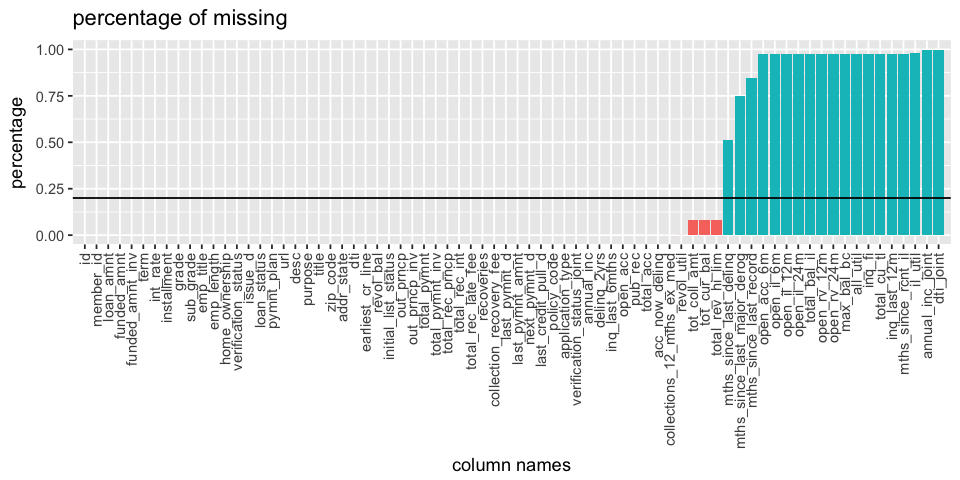

In [18]:
options(repr.plot.width=8, repr.plot.height=4)
ggplot(data = dfnum.NA, aes(x=ind, y=percentage)) + 
  geom_bar(aes(fill=per80), stat="identity") + 
  scale_x_discrete(name ="column names", 
                   limits=dfnum.NA$name)+
  theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none") +
  geom_hline(yintercept = 0.2) + 
  ggtitle("percentage of missing")


In [11]:
# # missing map
library("Amelia")
png("missmap.png", height = 30000, width = 2048)
missmap(loan)
#dev.off()

In [ ]:
# delete feature that has 80% missing
loan[, dfnum.NA$per80] <- NULL


### variable analysis
* univariate analysis
    + continuous
    + categorical
* bi-variate analysis
    + continuous & continuous
    + categorical & categorical
    + continuous & categorical

### common analysis tool:

* common statistics : mean, median, skewness, ...
* data visualization : barplot, histogram, density plot, ...
* hpyothesis test : Chi2-test, anova, t-test, ...
Since we focus on int_rate, which is response, basicly, we can think, what we are doing is try to estimate the density of  P(response|features)P(response|features) 


#### 1. int_rate
since this is continuous variable, we can look at its basic stats, and histogram, density plot, boxplot

In [15]:
# stats:
"range and quantile"
summary(loan$int_rate)
"sd"
sd(loan$int_rate)

[1] "range and quantile"

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
   5.32    9.99   12.99   13.25   16.20   28.99 

[1] "sd"

[1] 4.381867

analysis: positive skew, not strong, so we could use normal to model the curve, but we need more analysis

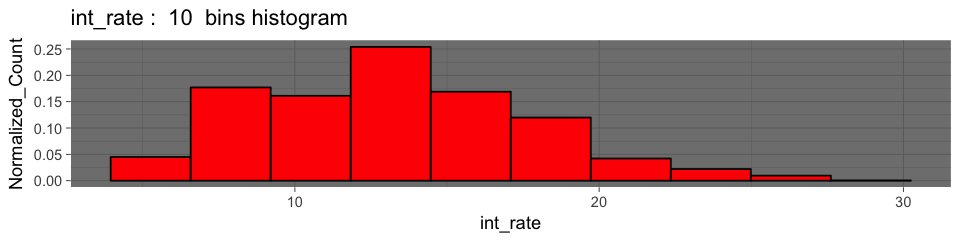

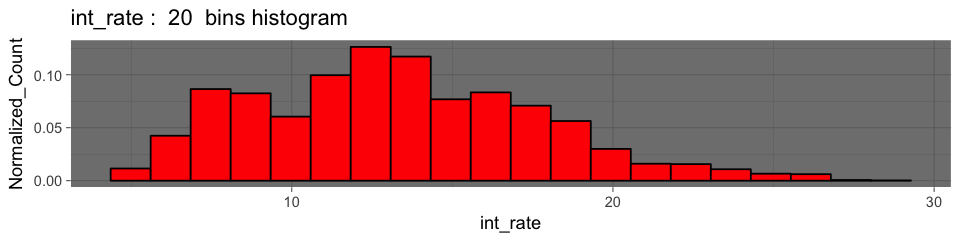

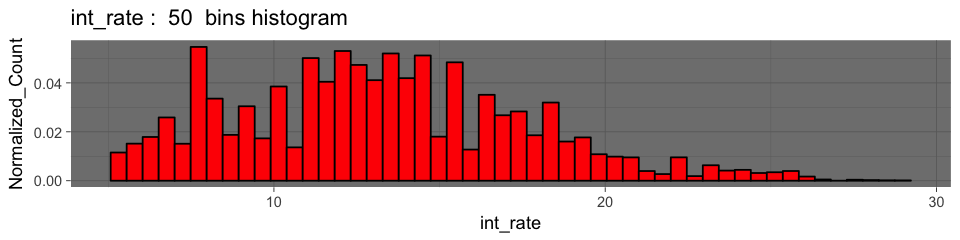

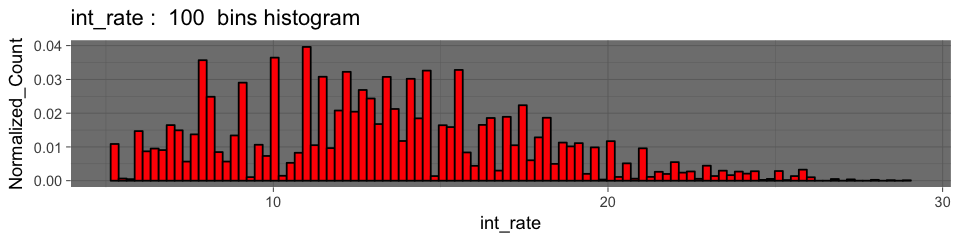

In [16]:
#plot hsitogram with different bins
plothist <- function(data, nbins){
    options(repr.plot.width=8, repr.plot.height=2)
    p <- ggplot(data, aes(x=int_rate))
    p <- p + geom_histogram(aes(y=..count../sum(..count..)),
                           bins = nbins,
                           color = "black",
                           fill="red")
    p + theme_dark() + ylab("Normalized_Count") + ggtitle(paste(paste("int_rate : ", nbins), " bins histogram" ))  
}

plothist(loan,10)
plothist(loan,20)

plothist(loan,50)
plothist(loan,100)

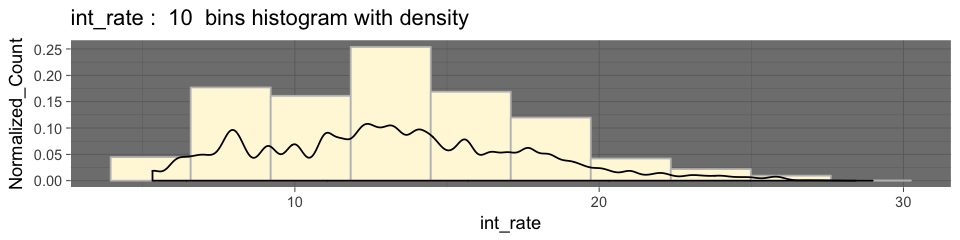

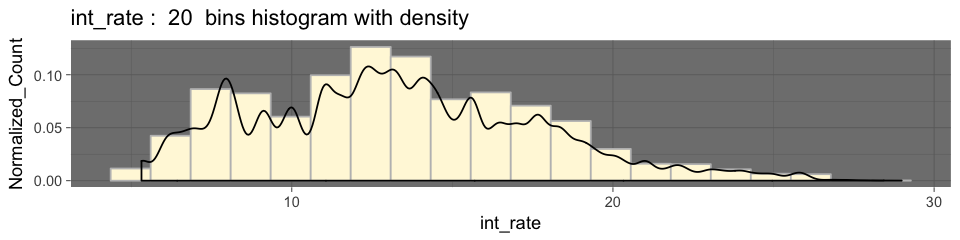

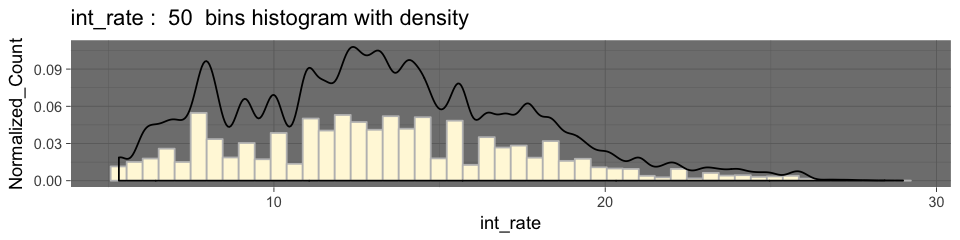

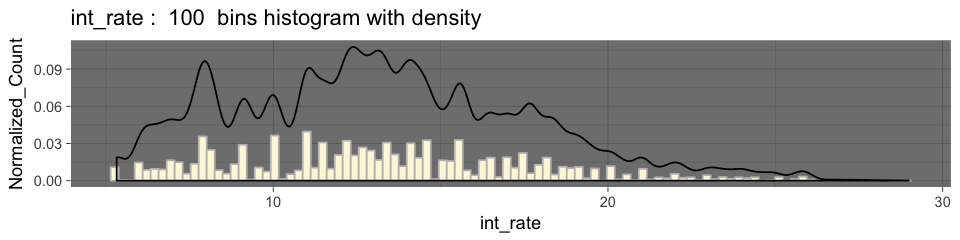

In [17]:
#add density curve on histogram
plothistdensity <- function(data, nbins){
    options(repr.plot.width=8, repr.plot.height=2)
    p <- ggplot(data, aes(x=int_rate, y = ..density..))
    p <- p + geom_histogram(aes(y=..count../sum(..count..)),
                           bins = nbins,
                           color = "grey",
                           fill="cornsilk")
    p <- p + geom_density()
    p + theme_dark() + 
    ylab("Normalized_Count") + 
    ggtitle(paste(paste("int_rate : ", nbins), " bins histogram with density" ))  
}

plothistdensity(loan, 10)
plothistdensity(loan, 20)
plothistdensity(loan, 50)
plothistdensity(loan, 100)


analysis: usually histogram could roughly estimate pdf of a random variable, however, to get more stable and generalize result we could use KDE to estimate density of a random variable. From the density plot, we observe many peaks, which indicates this a multimodal distribution. This means there are different patterns inside the distribution, usually, it is a mixture distribution. This pattern may cause by groups(usage, years, repuations, states, ...) obvious groups in the features are categorical variables



### group variable analysis with int_rate

1. int_rate with grade  
grade: LC assigned loan grade

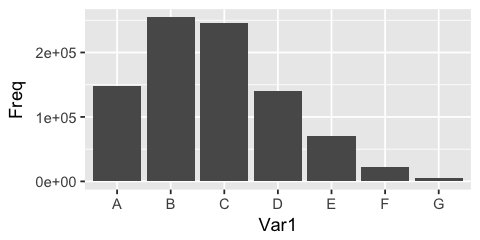

In [18]:
options(repr.plot.width = 4, repr.plot.height = 2)
ggplot(data = data.frame(table(loan$grade)),aes(x=Var1,y = Freq)) + 
geom_bar(stat='identity')

a little bit skew but still normal trends, A,G are less than BC

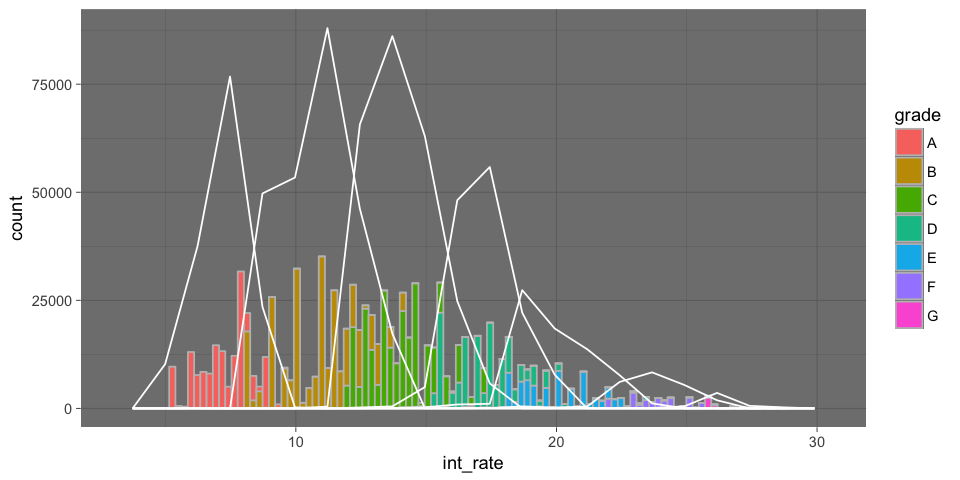

In [19]:
# group histgram 1
options(repr.plot.width = 8,repr.plot.height = 4)
ggplot(data = loan,aes(x= int_rate, fill=grade)) + 
geom_histogram(bins=100,color='grey') + 
theme_dark() + 
geom_freqpoly(bins=20,color='white')

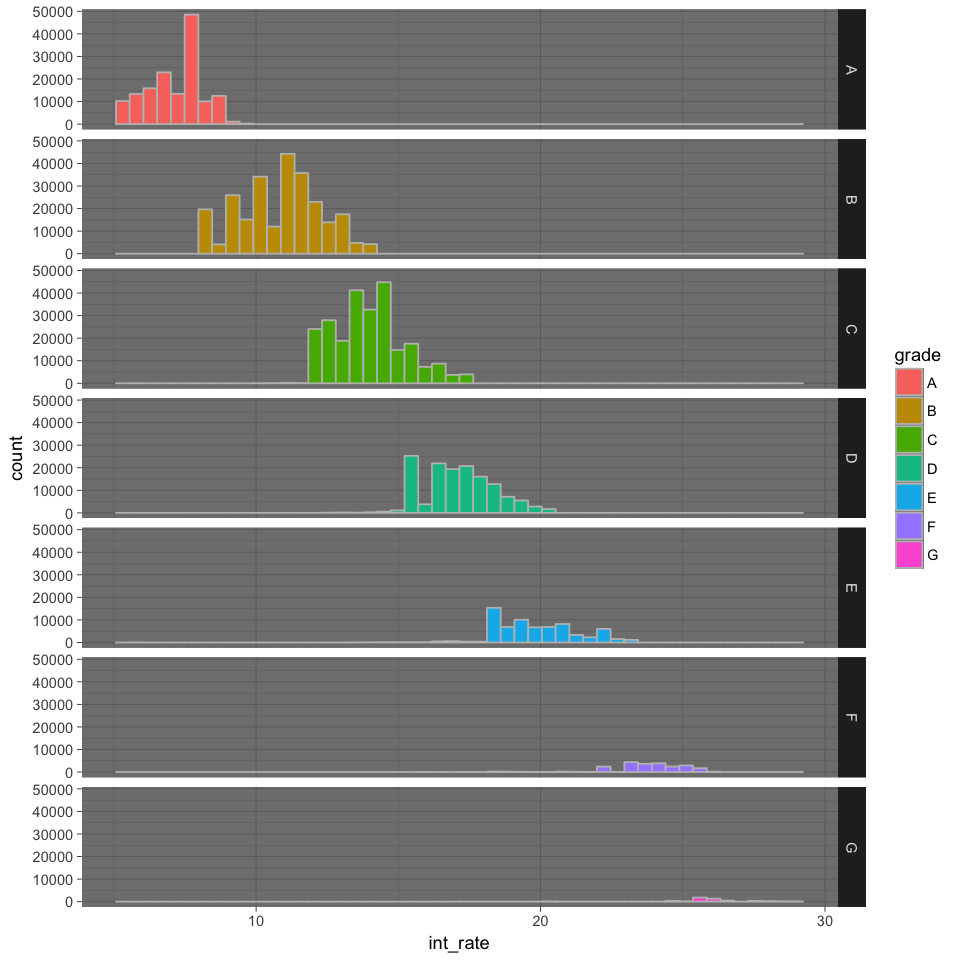

In [20]:
# group histogram in different lines:
options(repr.plot.width = 8,repr.plot.height = 8)
ggplot(data = loan,aes(x=int_rate,fill=grade))+
geom_histogram(bins=50,color='grey')+
facet_grid(grade~.)+
theme_dark()

note: 
facets parameter: a formula with the rows (of the tabular display) on the LHS and the columns (of the tabular display) on the RHS; the dot in the formula is used to indicate there should be no faceting on this dimension (either row or column). The formula can also be provided as a string instead of a classical formula object

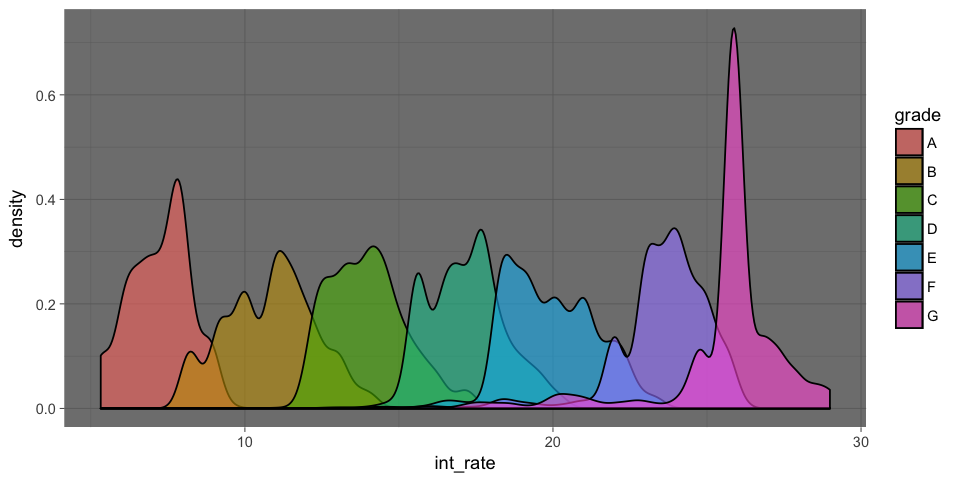

In [21]:
# group density 1
options(repr.plot.width = 8,repr.plot.height = 4)
ggplot(data = loan, aes(x=int_rate,y = ..density..,fill=grade))+
theme_dark()+
geom_density(bw=0.3,alpha=0.6)

note:  
bw is used for smoothing babdwith,if numeric, it means sd of the smoothing kernel,if character, a rule to choose the bandwith,if band width is so large, it will become a kernel shape function
in the constrast, it will not be smooth

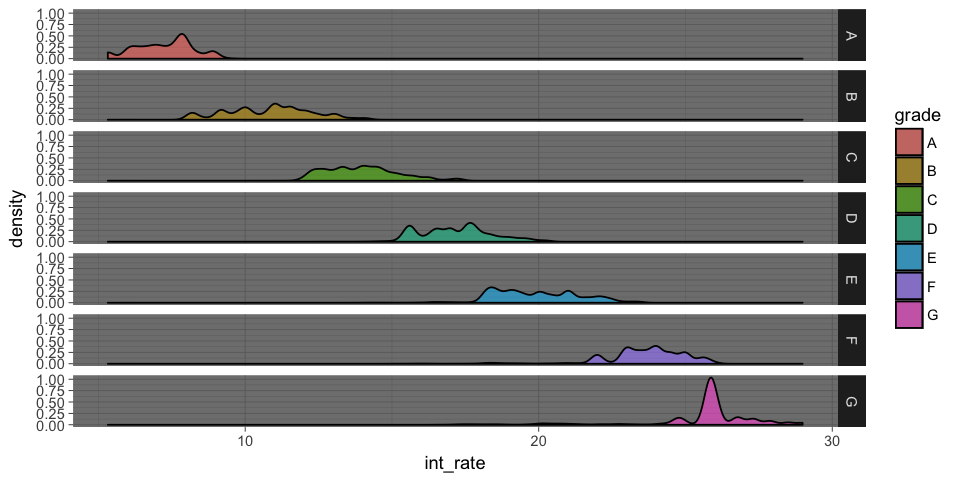

In [22]:
# group density 2
options(repr.plot.width = 8,repr.plot.height = 4)
ggplot(data=loan,aes(x=int_rate,y=..density..,fill=grade))+
geom_density(bw=0.2,alpha = 0.6)+
theme_dark()+
facet_grid(grade~.)
#ggplot(data=loan,aes(x=int_rate,y=..density..,fill=grade))+theme_dark()+facet_grid(grade~.)+geom_density(bw=0.2,alpha = 0.6)

analysis:  
Even we group int_rate by grade, it still shows multimodality inside each group, we can dig into it latter, but, clearly it shows grade was directly related to int_rate

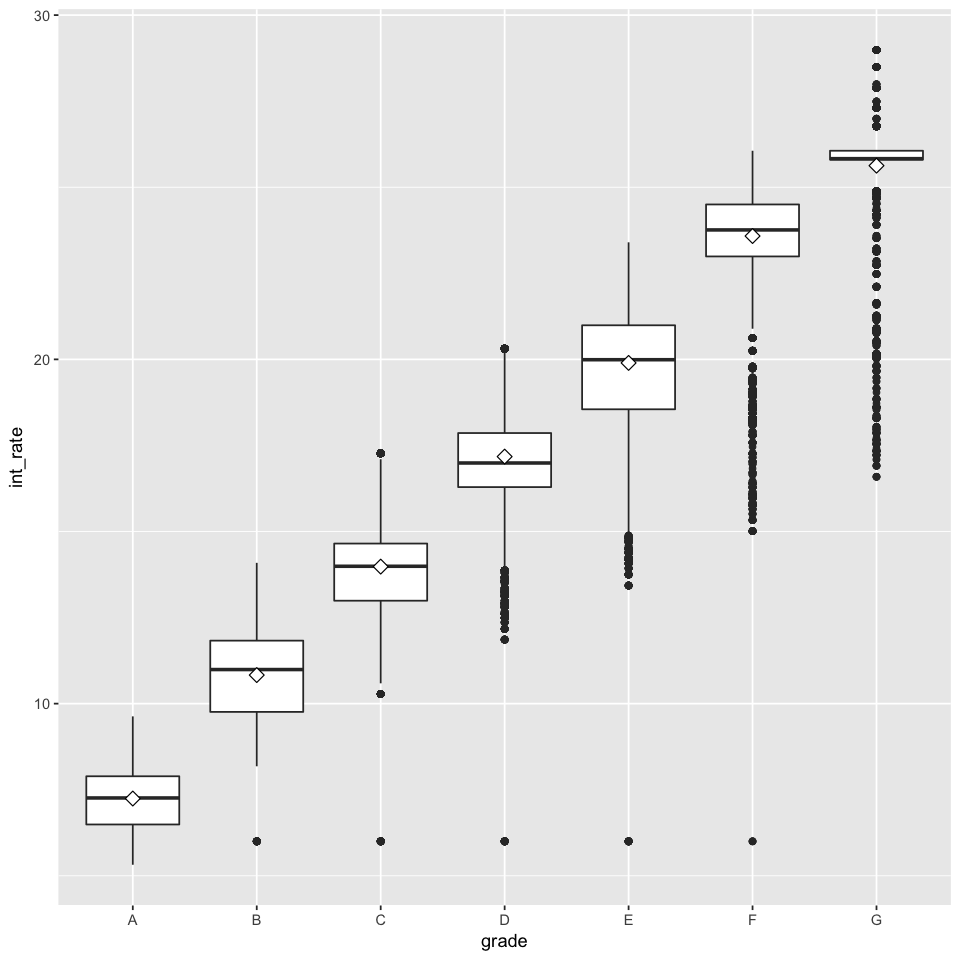

In [23]:
# boxplot 1
options(repr.plot.width=8,repr.plot.height= 8)
ggplot(data = loan,aes(x=factor(grade),y=int_rate))+
geom_boxplot()+
labs(x='grade')+
stat_summary(fun.y='mean',geom='point',shape=23,size=3,fill='white')

box plot shows the skewness, quantile, outliers of each group, but it cannot show the amount of data in each group

In [24]:
table(loan$grade)



     A      B      C      D      E      F      G 
148202 254535 245860 139542  70705  23046   5489 

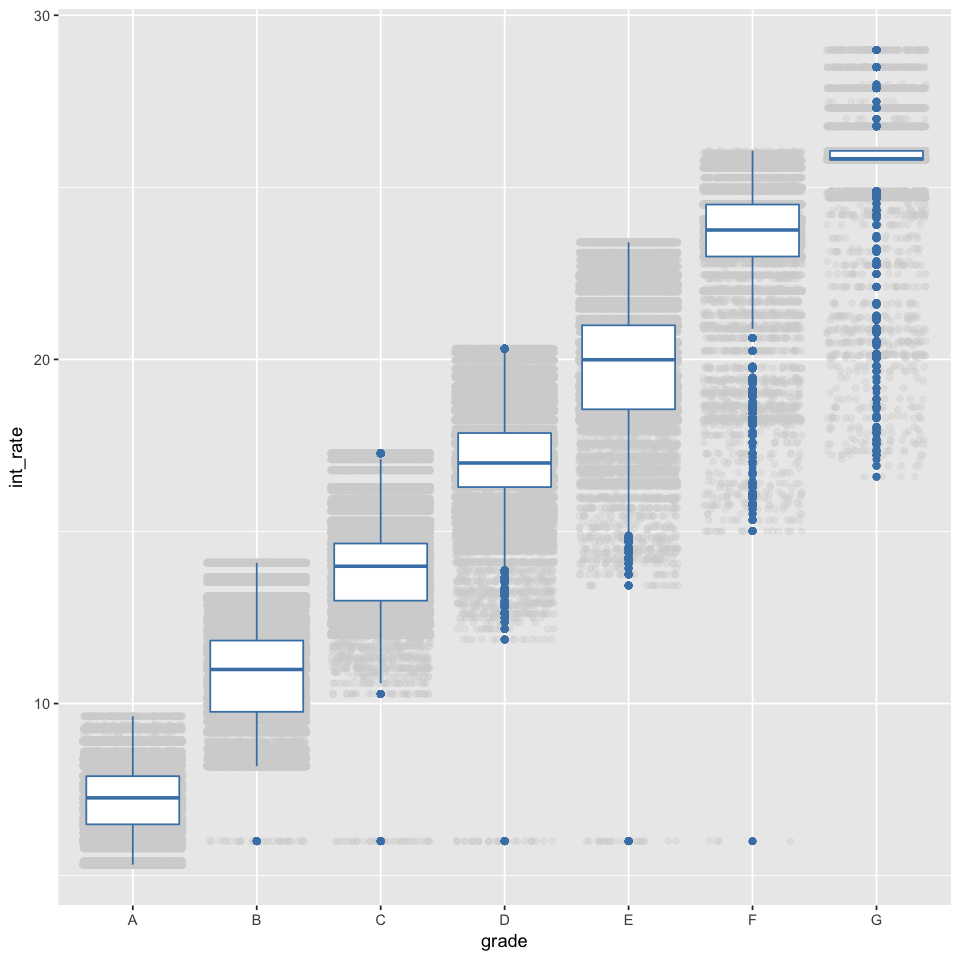

In [25]:
options(repr.plot.width=8, repr.plot.height=8)
ggplot(loan, aes(x=factor(grade), y=int_rate)) + 
geom_jitter(alpha=0.3, color='lightgrey') +
geom_boxplot(color='steelblue') + 
labs(x='grade')

we can also use a violin plot to compare multiple distribution in different group




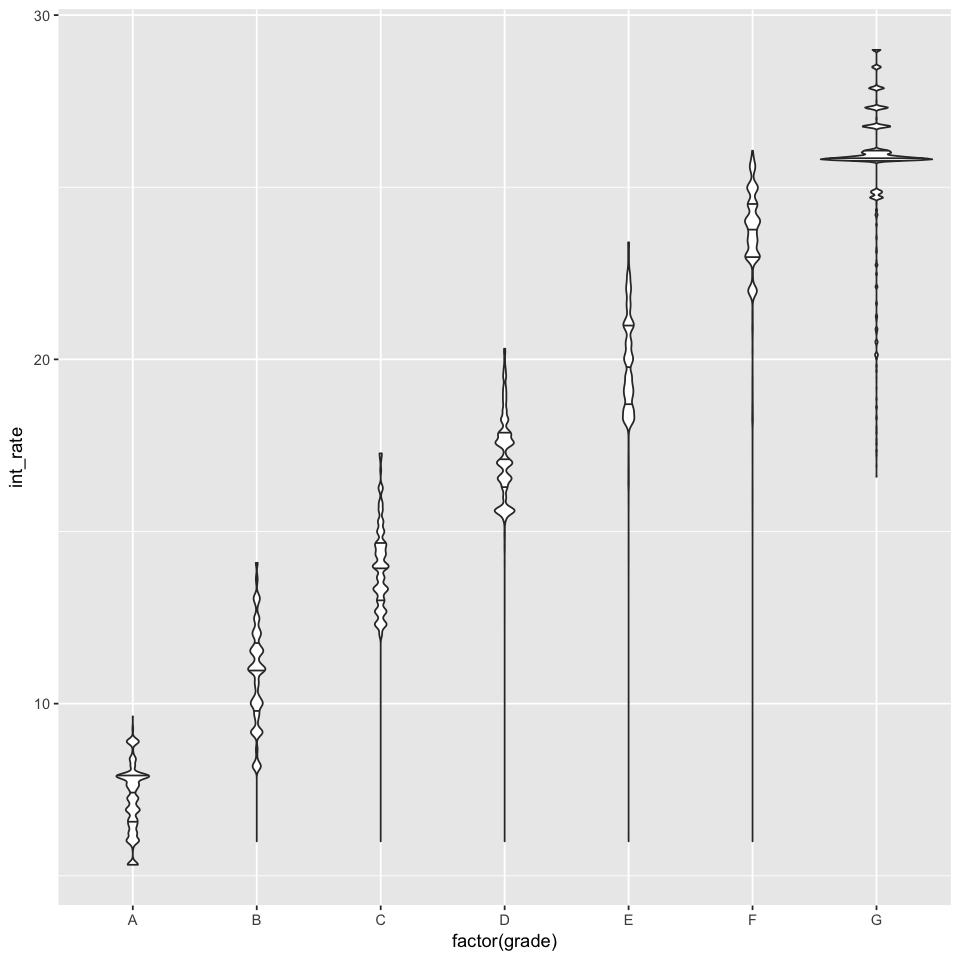

In [26]:
options(repr.plot.width=8, repr.plot.height=8)
ggplot(loan, aes(x=factor(grade), y=int_rate)) +
geom_violin(draw_quantiles = c(0.25,0.5,0.75))

###  2. int_rate with subgrade

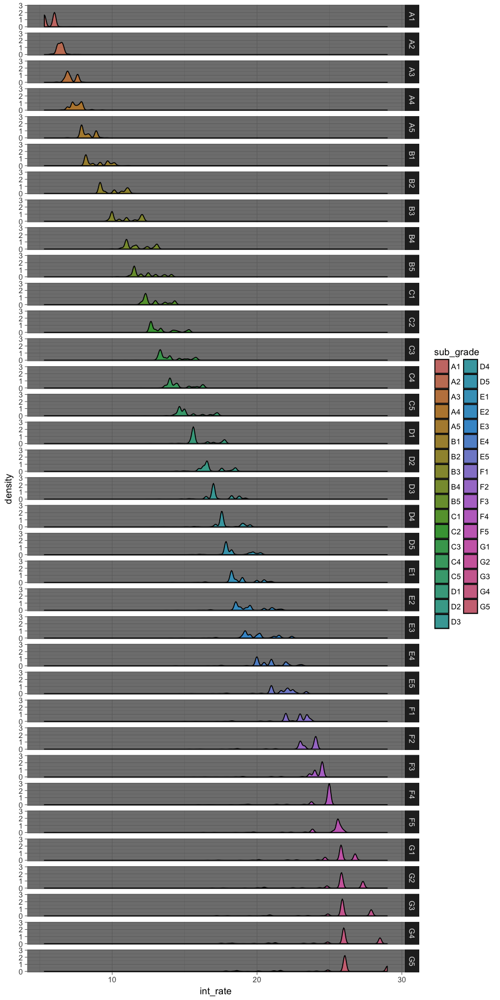

In [27]:
options(repr.plot.width=8, repr.plot.height=16)
ggplot(loan, aes(x=int_rate, y= ..density.., fill=sub_grade)) + 
theme_dark() + 
facet_grid(sub_grade ~ .) +
geom_density(bw = 0.1, alpha= 0.6)

Analysis:  
in some subgrade, it is normal, but most are multimodal distribution

### 3. int_rate with loan_status  
loan_status: Current status of loan

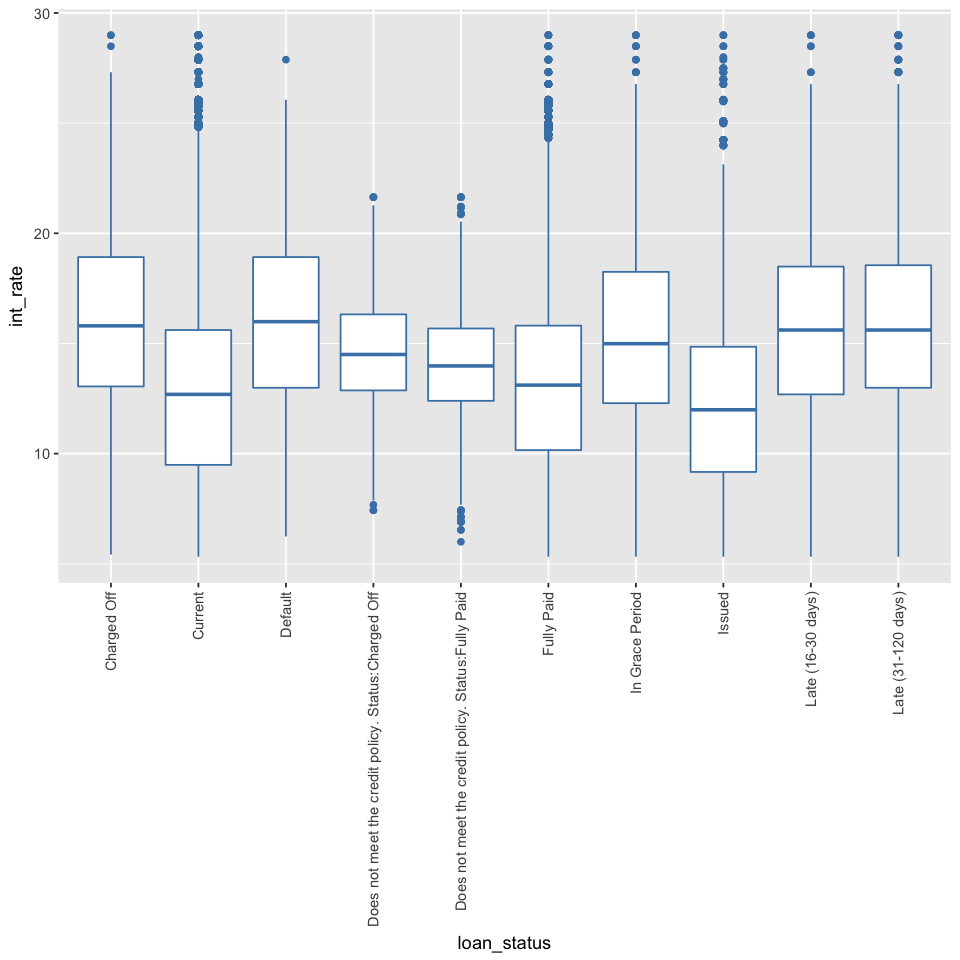

In [28]:
options(repr.plot.width=8, repr.plot.height=8)
ggplot(loan, aes(x=factor(loan_status), y=int_rate)) + 
# geom_jitter(alpha=0.3, color='lightgrey') +
geom_boxplot(color='steelblue') + 
labs(x='loan_status') + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

Analysis:  
1. different loan status has different distribution
2. Charged off, default, in grace period, late(16-30),late(31-120) are similar, we can combine those together to decrease the level of categorical data


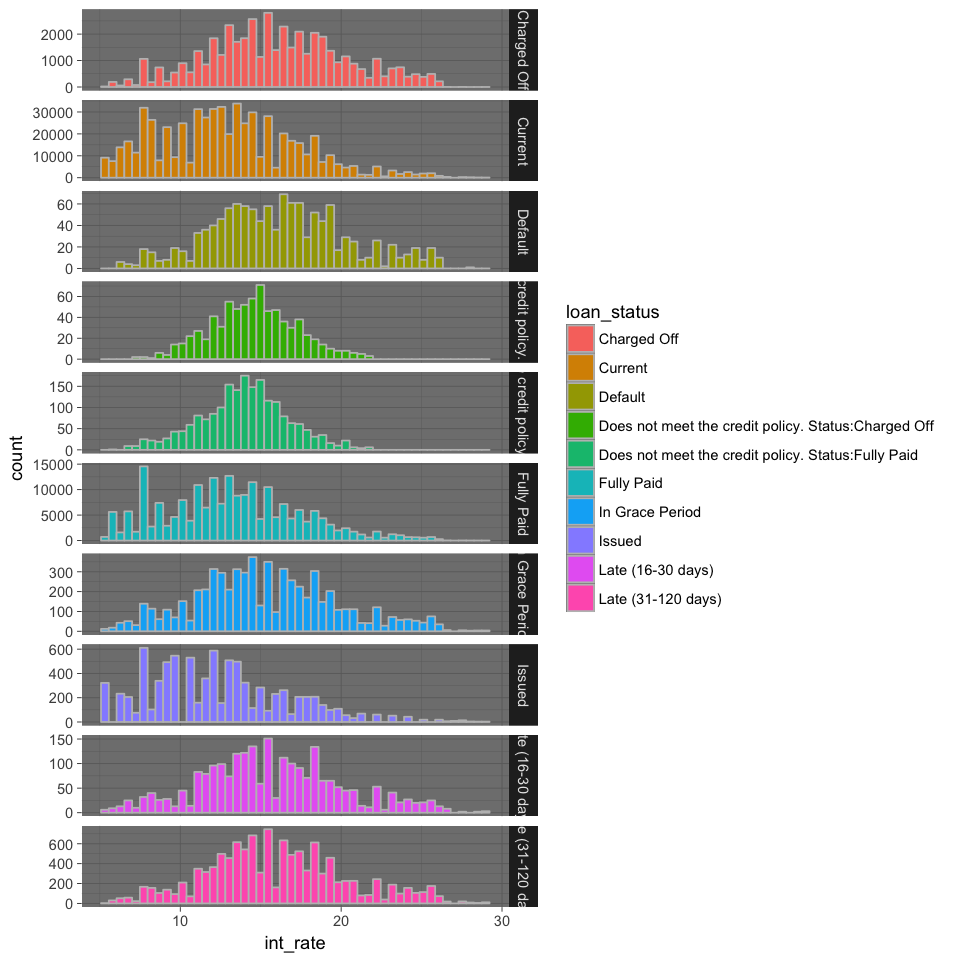

In [29]:
options(repr.plot.width=8, repr.plot.height=8)
ggplot(loan, aes(x=int_rate, fill=loan_status)) + 
geom_histogram(bins = 50, color = "grey") + 
facet_grid(loan_status ~ ., scales = "free") + theme_dark()


note:  
sacles parameter control: Are scales shared across all facets

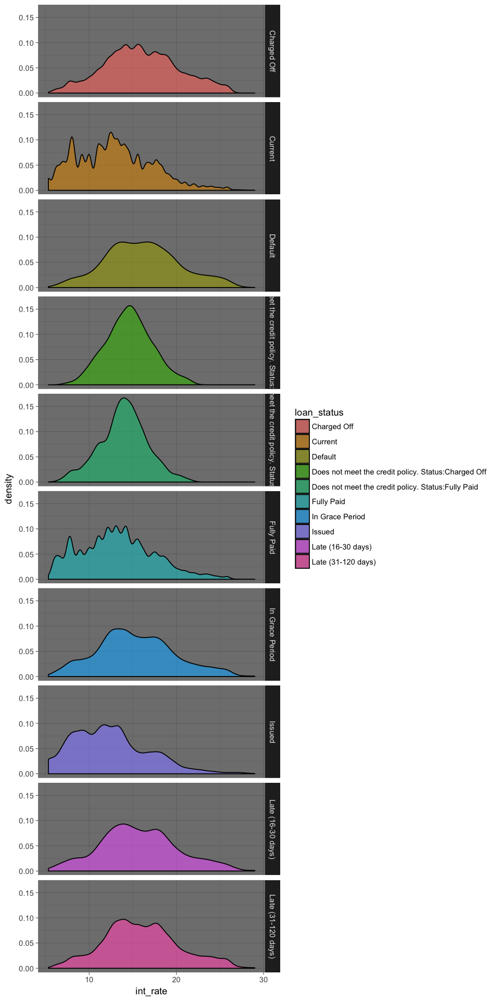

In [30]:
options(repr.plot.width=8, repr.plot.height=16)
ggplot(loan, aes(x=int_rate, y= ..density.., fill=loan_status)) + 
theme_dark() + 
facet_grid(loan_status ~ .) +
geom_density(alpha= 0.6)

Analysis:  
int_rate also influence by loan_status, and within each loan_status group, it appears more like a normal in most cases

### USER FEATURES vs int_rate

##### 4. addr_state with int_rate

In [31]:
# library(choroplethr)
# library(choroplethrMaps)

In [32]:
# sum(is.na(loan$addr_state))/dim(loan)[1]


For each state, use the avg_int_rate as new feature


In [33]:
state.ave.int_rate = as.list(by(loan$int_rate, loan$addr_state, mean))
state.names = names(state.ave.int_rate)
names(state.ave.int_rate) = NULL
state.int_rate.df = data.frame(region = state.names, value = unlist(state.ave.int_rate))

note:  
The with( ) function applys an expression to a dataset. It is similar to DATA= in SAS.

The by( ) function applys a function to each level of a factor or factors.

In [34]:
# adding district of columbia in original data
full.name = c()
for(i in 1:51)
{
    if(i==8){
        full.name <- append(full.name, "district of columbia")
    }else{
        full.name <- append(full.name, tolower(state.name[state.int_rate.df[i,1] == state.abb]))
    }
}

state.int_rate.df$region = full.name


In [35]:
# options(repr.plot.width=16, repr.plot.height=8)
# state_choropleth(state.int_rate.df)

In [36]:
# anova analysis on different groups

aov.res = aov(int_rate ~ factor(addr_state), na.action = na.omit, data = loan)
summary(aov.res)

                       Df   Sum Sq Mean Sq F value Pr(>F)    
factor(addr_state)     50    26795   535.9   27.95 <2e-16 ***
Residuals          887328 17011539    19.2                   
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Analysis: It shows that state has signigicant impact on int_rate, different states has different int_rate


##### 5. emp_length with int_rate
emp_length : Employment length in years. Possible values are between 0 and 10 where 0 means less than one year and 10 means ten or more years.

In [37]:
unique(loan$emp_length)


[1] "10+ years" "< 1 year"  "1 year"    "3 years"   "8 years"   "9 years"  
 [7] "4 years"   "5 years"   "6 years"   "2 years"   "7 years"   "n/a"

In [38]:
# missing values are string 'n/a', not NA in r
loan[which(loan$emp_length == "n/a"), "emp_length"] <- NA

In [39]:
# calculate missing percentage
sum(is.na(loan$emp_length))/dim(loan)[1] 

[1] 0.05051393

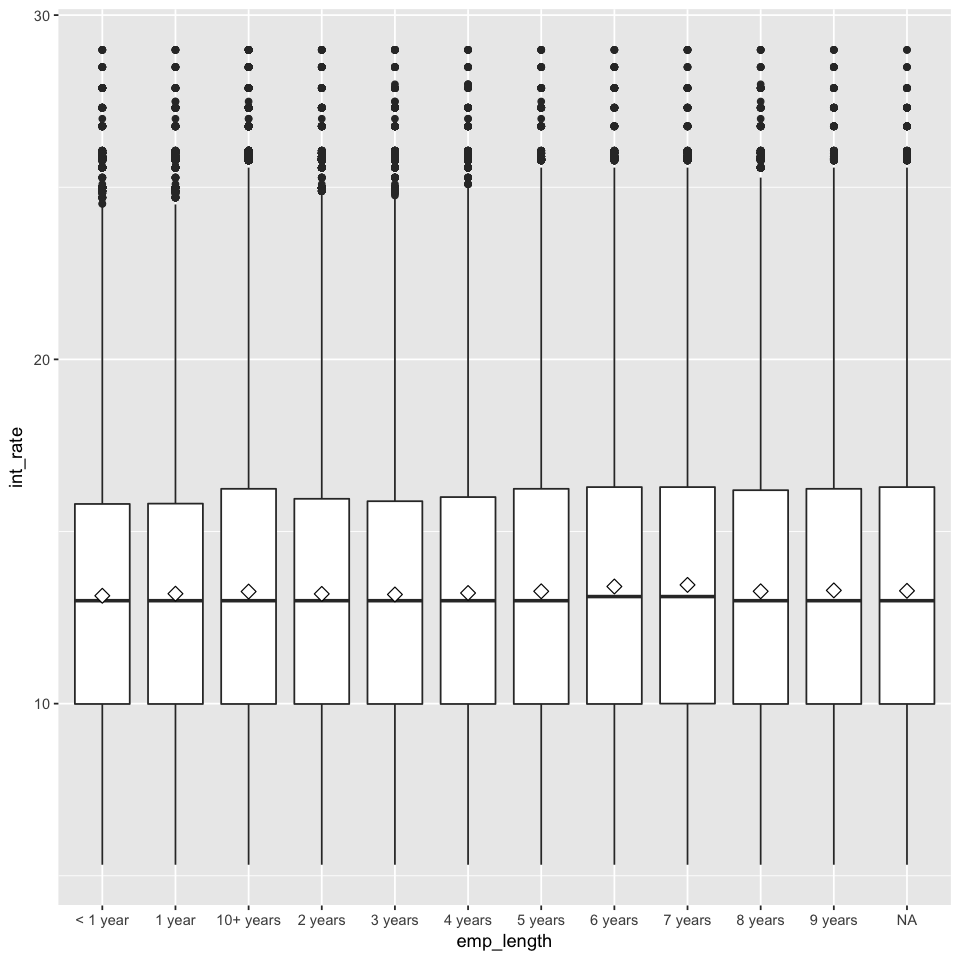

In [40]:
# boxplot 1
options(repr.plot.width=8, repr.plot.height=8)
ggplot(loan, aes(x=factor(emp_length), y=int_rate)) + 
geom_boxplot() + labs(x='emp_length') + 
stat_summary(fun.y="mean", geom="point", shape=23, size=3, fill="white")

In [41]:
# anova analysis on different groups
aov.res = aov(int_rate ~ factor(emp_length), na.action = na.omit, data = loan, )
summary(aov.res)
tukey.res = TukeyHSD(aov.res, conf.level = 0.95)                   # find significance between groups
tukey.res

                       Df   Sum Sq Mean Sq F value Pr(>F)    
factor(emp_length)     10     4781   478.1   24.86 <2e-16 ***
Residuals          842543 16202025    19.2                   
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1
44825 observations deleted due to missingness

  Tukey multiple comparisons of means
    95% family-wise confidence level

Fit: aov(formula = int_rate ~ factor(emp_length), data = loan, na.action = na.omit)

$`factor(emp_length)`
                            diff           lwr         upr     p adj
1 year-< 1 year     0.0599785748 -0.0194618451  0.13941899 0.3470600
10+ years-< 1 year  0.1224584721  0.0632569215  0.18166002 0.0000000
2 years-< 1 year    0.0543729150 -0.0187533651  0.12749920 0.3707992
3 years-< 1 year    0.0373230025 -0.0379529039  0.11259891 0.8845479
4 years-< 1 year    0.0802004846 -0.0011264772  0.16152745 0.0572026
5 years-< 1 year    0.1297404993  0.0497535601  0.20972744 0.0000096
6 years-< 1 year    0.2689271421  0.1825563966  0.35529789 0.0000000
7 years-< 1 year    0.3155473634  0.2301722564  0.40092247 0.0000000
8 years-< 1 year    0.1298512059  0.0440965949  0.21560582 0.0000584
9 years-< 1 year    0.1557726378  0.0631994014  0.24834587 0.0000033
10+ years-1 year    0.0624798973 -0.0021147738  0.12707457

In [42]:
# significant different groups
significant.groups = rownames(tukey.res[[1]])           
sort(significant.groups[tukey.res[[1]][, 4] < 0.05])     

[1] "10+ years-< 1 year" "2 years-10+ years"  "3 years-10+ years" 
 [4] "5 years-< 1 year"   "5 years-3 years"    "6 years-< 1 year"  
 [7] "6 years-1 year"     "6 years-10+ years"  "6 years-2 years"   
[10] "6 years-3 years"    "6 years-4 years"    "6 years-5 years"   
[13] "7 years-< 1 year"   "7 years-1 year"     "7 years-10+ years" 
[16] "7 years-2 years"    "7 years-3 years"    "7 years-4 years"   
[19] "7 years-5 years"    "8 years-< 1 year"   "8 years-3 years"   
[22] "8 years-6 years"    "8 years-7 years"    "9 years-< 1 year"  
[25] "9 years-2 years"    "9 years-3 years"    "9 years-6 years"   
[28] "9 years-7 years"

In [43]:
table(loan$emp_length)



 < 1 year    1 year 10+ years   2 years   3 years   4 years   5 years   6 years 
    70605     57095    291569     78870     70026     52529     55704     42950 
  7 years   8 years   9 years 
    44594     43955     34657 

Analysis:  
we can find that basically, the difference is between 0-5 and 5-10, so we can feature engineering in to 2 groups

In [44]:
# feature engineering : split emp_length to < 5 ; >= 5
loan$emp_length_sim = NA
loan[which(loan$emp_length %in% c('10+ years', '8 years','9 years','5 years','6 years','7 years')), "emp_length_sim"] <- ">= 5"
loan[which(loan$emp_length %in% c('< 1 year', '1 year','2 years','3 years','4 years')), "emp_length_sim"] <- "< 5"

In [45]:
table(loan$emp_length_sim)



   < 5   >= 5 
329125 513429 

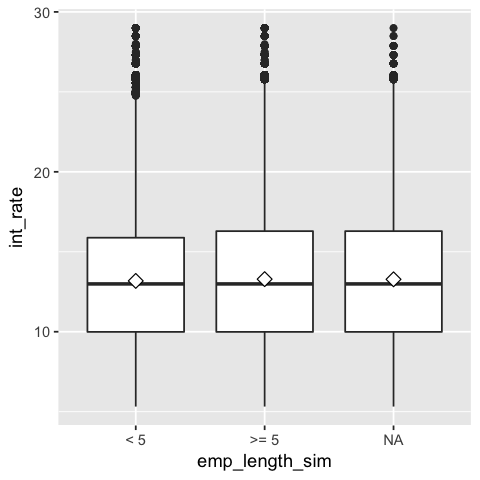

In [46]:
# boxplot 2
options(repr.plot.width=4, repr.plot.height=4)
ggplot(loan, aes(x=factor(emp_length_sim), y=int_rate)) + 
geom_boxplot() + labs(x='emp_length_sim') + 
stat_summary(fun.y="mean", geom="point", shape=23, size=3, fill="white")


In [47]:
# t-test on group means
t.test(int_rate ~ emp_length_sim, data = loan, na.action = na.omit) # significant


	Welch Two Sample t-test

data:  int_rate by emp_length_sim
t = -11.374, df = 709990, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -0.13010148 -0.09185434
sample estimates:
 mean in group < 5 mean in group >= 5 
          13.17751           13.28849 


##### 5. emp_title with int_rate
nominal


In [48]:
# display top ten emp_title
loan$emp_title = tolower(loan$emp_title)          # convert all string to lowercase
sort(table(loan$emp_title), decreasing = T)[1:100]   # possible text processing, na exists as a level

ERROR: Error in tolower(loan$emp_title): invalid multibyte string 4874


In [49]:
library(stringi)

In [50]:
loan$emp_title = tolower(stri_unescape_unicode(loan$emp_title))
sort(table(loan$emp_title), decreasing = T)[1:100]

Warning message in stri_unescape_unicode(loan$emp_title):
“invalid escape sequence detected. Setting NA”


                                          teacher                  manager 
                   51457                    16619                    14963 
                   owner         registered nurse               supervisor 
                    8586                     7721                     6937 
                  driver                    sales                       rn 
                    6215                     6208                     6017 
          office manager          project manager          general manager 
                    4687                     4625                     4256 
            truck driver                 director                 engineer 
                    3566                     3427                     3186 
               president            sales manager           vice president 
                    3094                     2713                     2633 
          police officer       operations manager            store manager 
           

In [51]:
# convert " " to NA
loan$emp_title[which(loan$emp_title == '')]=NA

In [52]:
# percentage of missing 
sum(is.na(loan$emp_title))/length(loan$emp_title)

[1] 0.05798875

In [53]:
# how many titles we have?
length(unique(loan$emp_title))

[1] 261558

In [54]:
# most of emp_title are unique
quantile(table(loan$emp_title))

   0%   25%   50%   75%  100% 
    1     1     1     1 16619 

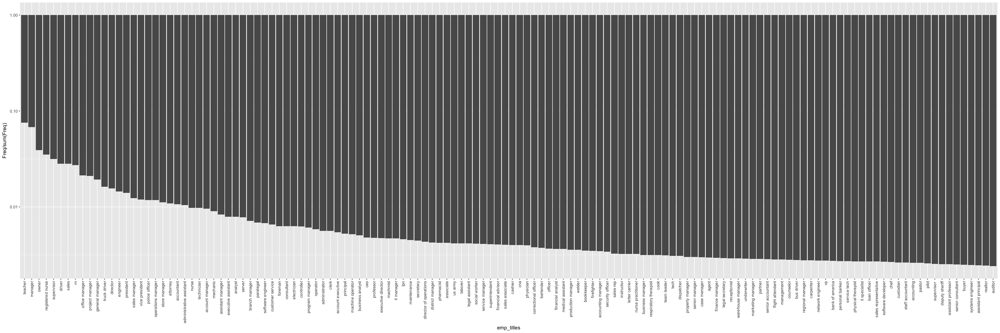

In [55]:
# bar plot
emp_title.pop = sort(table(loan$emp_title)[which(table(loan$emp_title)>500)],decreasing=T)
emp_title.pop = as.data.frame(emp_title.pop)

options(repr.plot.width=30,repr.plot.height=10)
ggplot(emp_title.pop,aes(x=Var1,y=Freq/sum(Freq))) +
geom_bar(stat='identity') + #identity means the height represents values in the data
scale_y_log10()+
scale_x_discrete(name ="emp_titles", limits=emp_title.pop$Var1)+
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5), legend.position = "none")

Analysis:
# possible feature engineering : binning
# binning emp_title by range of average int_rate

In [56]:
# generate new feature emp_title
emp_title.avg_rate = as.list(by(loan$int_rate,loan$emp_title,median))
emp_title.avg_rate = unlist(emp_title.avg_rate)
loan$gen_emp_title_avg_rate = unlist(apply(loan,1,function(x){return (emp_title.avg_rate[x['emp_title']])}))

Warning message in min(x):
“no non-missing arguments to min; returning Inf”Warning message in max(x):
“no non-missing arguments to max; returning -Inf”Warning message in max(x):
“no non-missing arguments to max; returning -Inf”

ERROR: Error in plot.window(...): need finite 'xlim' values


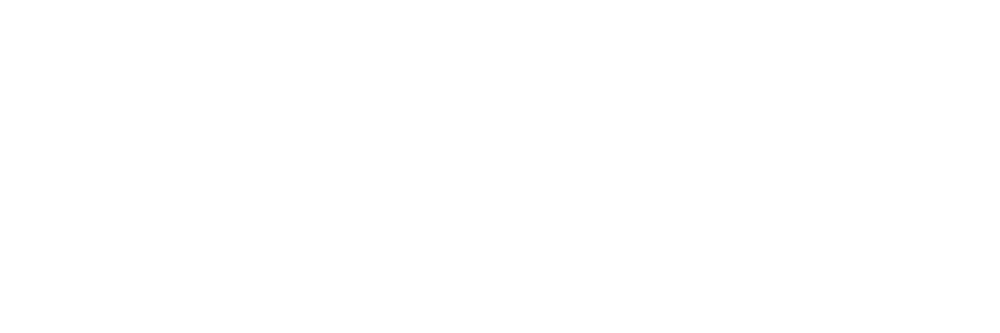

In [57]:
plot(table(loan$gen_empt_title_ave_rate))

##### 6. 6. home_ownership with int_rate¶
nominal

In [58]:
unique(loan$home_ownership)



[1] "RENT"     "OWN"      "MORTGAGE" "OTHER"    "NONE"     "ANY"

In [59]:
# missing value percentage
sum(loan$home_ownership == "NONE") / dim(loan)[1]


[1] 5.634571e-05

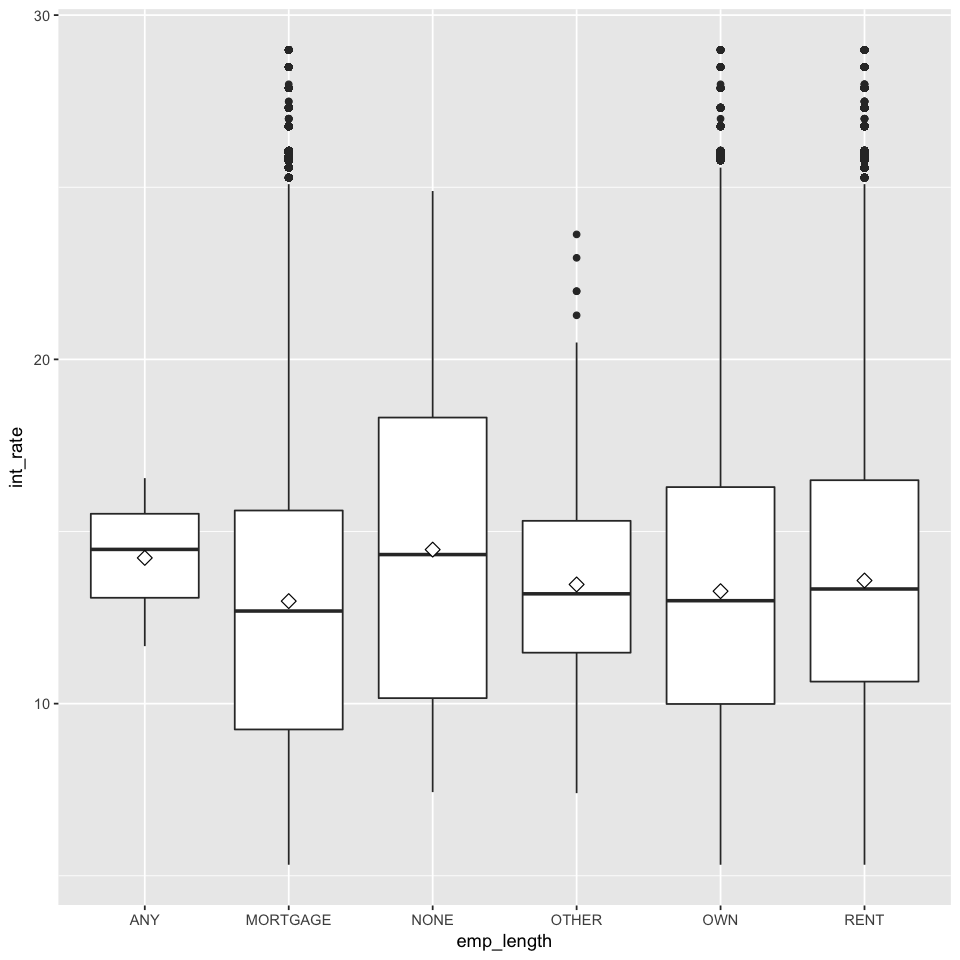

In [60]:
# boxplot 1
options(repr.plot.width=8, repr.plot.height=8)
ggplot(loan, aes(x=factor(home_ownership), y=int_rate)) + 
#geom_jitter(alpha=0.3, color='lightgrey') +
geom_boxplot() + labs(x='emp_length') + 
stat_summary(fun.y="mean", geom="point", shape=23, size=3, fill="white")

In [61]:
# binning "ANY", "NONE", "OTHER"
loan$gen_home_ownership = loan$home_ownership
loan$gen_home_ownership[loan$home_ownership %in% c("ANY", "NONE", "OTHER")] = "others"

Analysis:  
we can observe rough trend, that mortage < own < rent



##### 7. zip code with int_rate


In [62]:
sum(is.na(loan$zip_code))/dim(loan)[1]


[1] 0

In [52]:
table(loan$zip_code, loan$addr_state)


       
          AK   AL   AR   AZ   CA   CO   CT   DC   DE   FL   GA   HI   IA   ID
  007xx    0    0    0    0    0    0    0    0    0    1    0    0    0    0
  008xx    0    0    0    0    0    0    0    0    0    0    0    0    0    0
  010xx    0    0    0    0    0    0    1    0    0    0    0    0    0    0
  011xx    0    0    0    0    0    0    1    0    0    0    0    0    0    0
  012xx    0    0    0    0    0    0    0    0    0    0    0    0    0    0
  013xx    0    0    0    0    0    0    0    0    0    0    0    0    0    0
  014xx    0    0    0    0    0    0    0    0    0    0    0    0    0    0
  015xx    0    0    0    0    0    0    0    0    0    0    0    0    0    0
  016xx    0    0    0    0    0    0    0    0    0    0    0    0    0    0
  017xx    0    0    0    0    1    0    0    0    0    0    0    0    0    0
  018xx    0    0    0    0    0    0    0    0    0    0    0    0    0    0
  019xx    0    0    0    0    0    0    0    0    0    

In [63]:
# possible : feature engineering combine zip_code and addr_state to generate more accurate address
loan$gen_add_state_zip = paste(loan$addr_state, as.character(loan$zip_code))
add_state_zip.ave_rate = as.list(by(loan$int_rate, loan$gen_add_state_zip, median))
add_state_zip.ave_rate = unlist(add_state_zip.ave_rate)
loan$gen_add_state_zip_ave_rate = unlist(apply(loan, 1, function(x){return(add_state_zip.ave_rate[x["gen_add_state_zip"]])}))

Analysis:  
possible : feature engineering combine zip_code and addr_state to generate more accurate address


### USER FEATURES (financial specific) vs int_rate

##### 7. annual_inc with int_rate
The self-reported annual income provided by the borrower during registration.

In [64]:
# check missing values
length(which(is.na(loan$annual_inc) | (loan$annual_inc == 0)))/dim(loan)[1]


[1] 6.761485e-06

In [65]:
# use mean to substitute missing values
loan$annual_inc[which(is.na(loan$annual_inc) | (loan$annual_inc == 0))] = mean(loan$annual_inc, na.rm=T)


In [66]:
range(loan$annual_inc)


[1]    1200 9500000

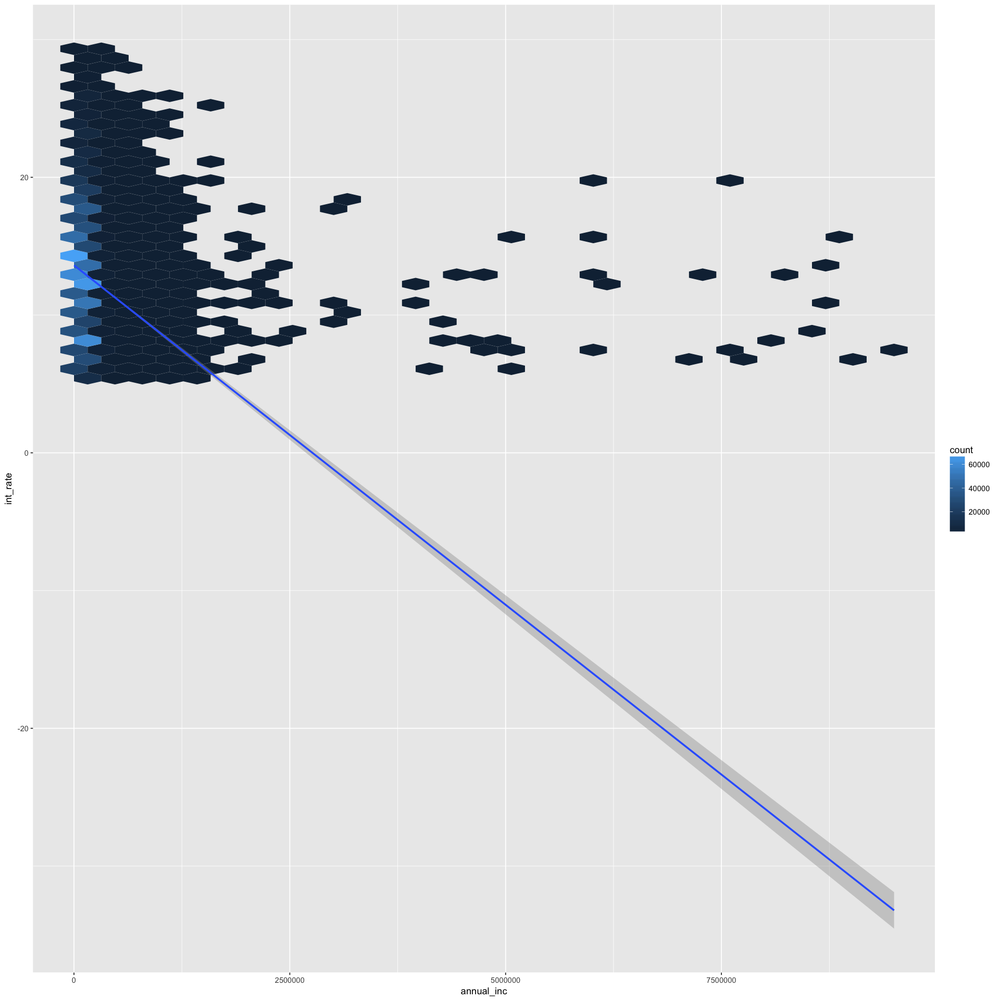

In [67]:
# linear relationship
options(repr.plot.width=16, repr.plot.height=16)
ggplot(loan, aes(x = annual_inc, y=int_rate)) + geom_hex() + stat_smooth(method=lm)

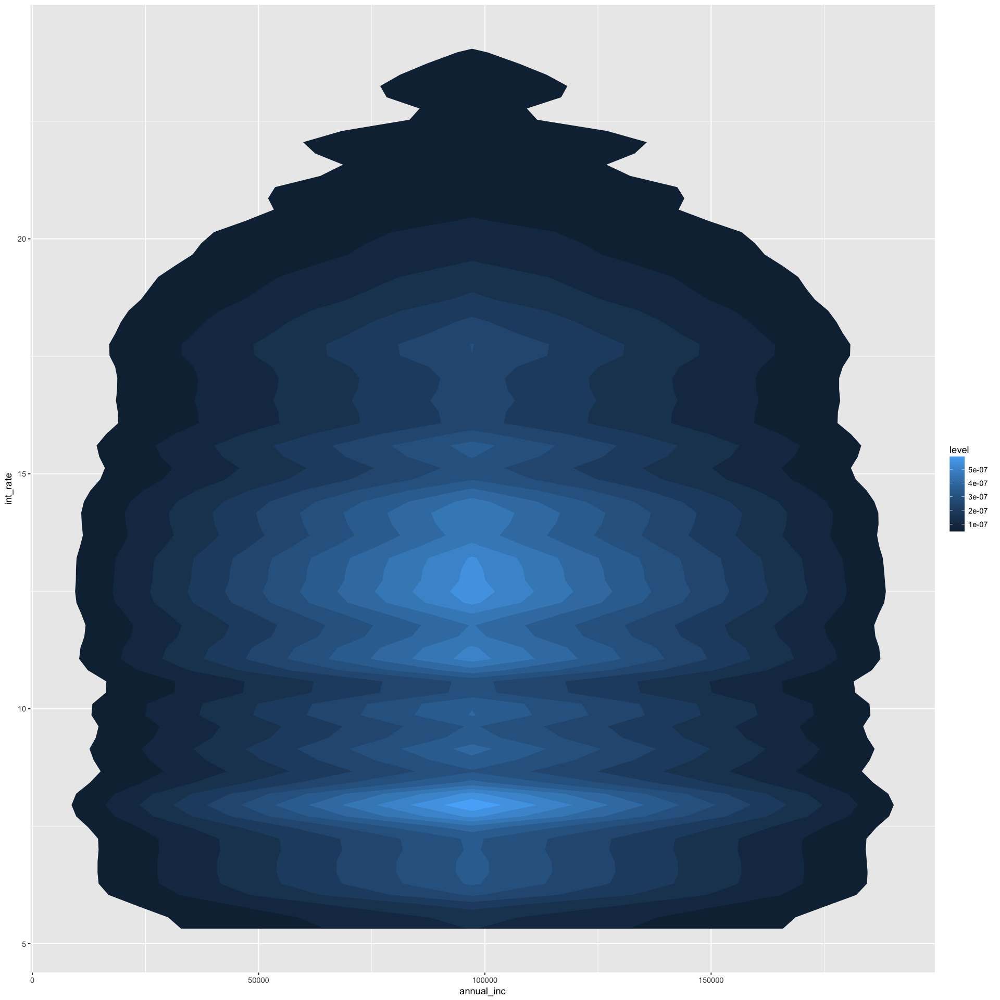

In [68]:
ggplot(loan, aes(x = annual_inc, y=int_rate)) + 
stat_density_2d(aes(fill = ..level..), geom = "polygon")

In [69]:
cor(loan$annual_inc, loan$int_rate)


[1] -0.07278456

Analysis:  
it is like a log normal, so take log and do it again

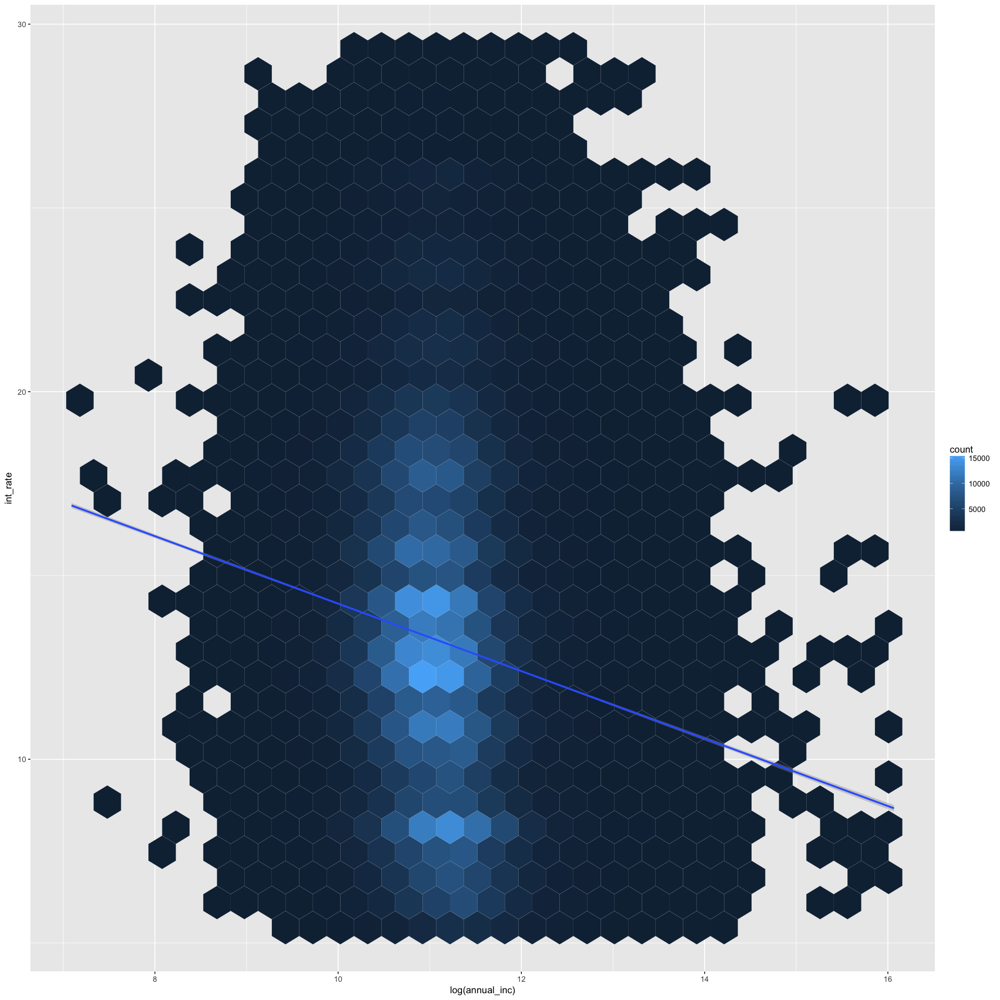

In [70]:
# linear relationship in log scale : possible feature engineering
options(repr.plot.width=16, repr.plot.height=16)
ggplot(loan, aes(x = log(annual_inc), y=int_rate)) + geom_hex() + stat_smooth(method=lm)


In [71]:
# possible feature
cor(log(loan$annual_inc), loan$int_rate)

[1] -0.110645

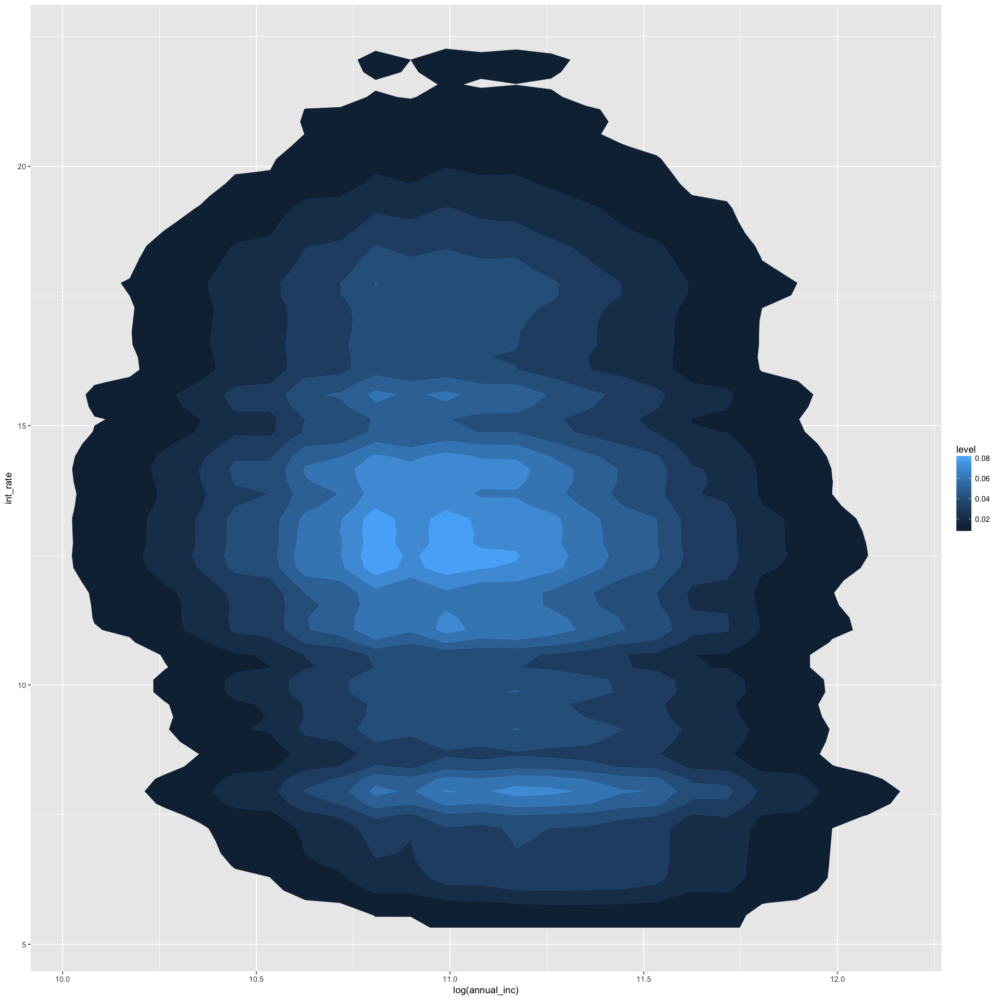

In [72]:
ggplot(loan, aes(x = log(annual_inc), y=int_rate)) + 
stat_density_2d(aes(fill = ..level..), geom = "polygon")


In [73]:
loan$gen_log_annual_inc = log(loan$annual_inc)

##### 8. annual_inc_joint with int_rate

In [74]:
sum(is.na(loan$annual_inc_joint))/dim(loan)[1]


[1] 0.9994241

Analysis:  
drop this feature, too many missing values

##### 9. verified_status_joint with int_rate¶


In [75]:
# check missing values
sum(is.na(loan$verification_status))/dim(loan)[1]


[1] 0

In [76]:
unique(loan$verification_status)


[1] "Verified"        "Source Verified" "Not Verified"

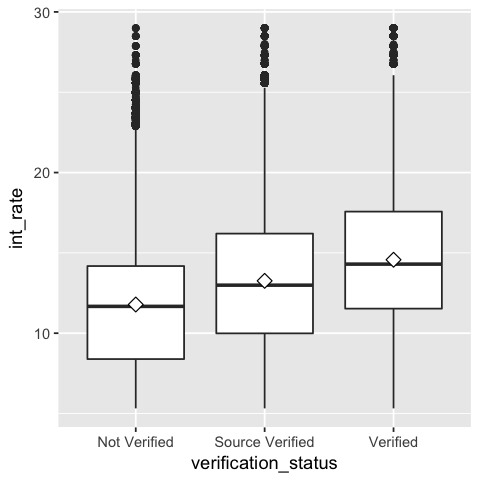

In [77]:
# boxplot 1
options(repr.plot.width=4, repr.plot.height=4)
ggplot(loan, aes(x=factor(verification_status), y=int_rate)) + 
geom_boxplot() + labs(x='verification_status') + 
stat_summary(fun.y="mean", geom="point", shape=23, size=3, fill="white")

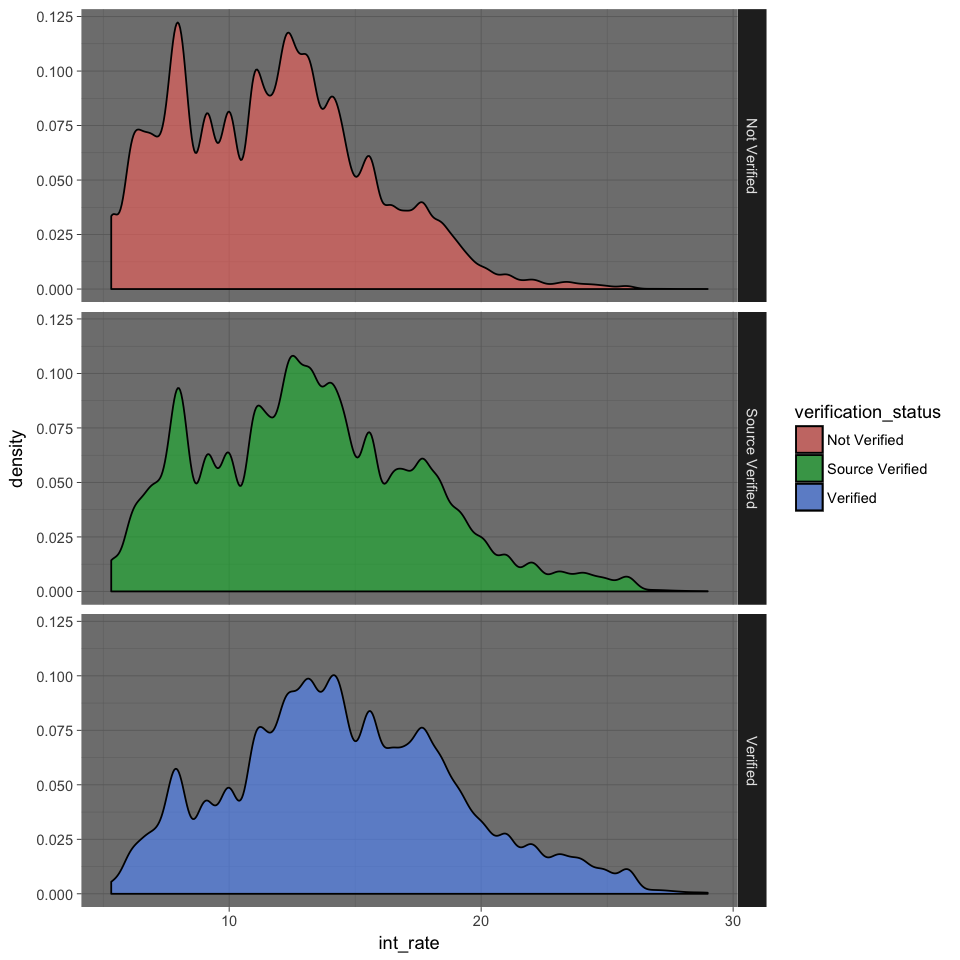

In [78]:
# density plot for each group
options(repr.plot.width=8, repr.plot.height=8)
ggplot(loan, aes(x=int_rate, y= ..density.., fill=verification_status)) + 
theme_dark() + 
facet_grid(verification_status ~ .) +
geom_density(alpha= 0.6)

In [79]:
table(loan$verification_status)



   Not Verified Source Verified        Verified 
         266750          329558          291071 

In [80]:
aov.res = aov(int_rate ~ factor(verification_status), na.action = na.omit, data = loan, )
summary(aov.res)


                                Df   Sum Sq Mean Sq F value Pr(>F)    
factor(verification_status)      2  1080177  540089   30032 <2e-16 ***
Residuals                   887376 15958157      18                   
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

In [81]:
tukey.res = TukeyHSD(aov.res, conf.level = 0.95)                   # find significance between groups
tukey.res

  Tukey multiple comparisons of means
    95% family-wise confidence level

Fit: aov(formula = int_rate ~ factor(verification_status), data = loan, na.action = na.omit)

$`factor(verification_status)`
                                 diff      lwr      upr p adj
Source Verified-Not Verified 1.472698 1.446812 1.498583     0
Verified-Not Verified        2.785659 2.759019 2.812299     0
Verified-Source Verified     1.312962 1.287681 1.338243     0


In [82]:
significant.groups = rownames(tukey.res[[1]])           
sort(significant.groups[tukey.res[[1]][, 4] < 0.05])   

[1] "Source Verified-Not Verified" "Verified-Not Verified"       
[3] "Verified-Source Verified"

Analysis:  
significant difference between groups, verified and source verified seems to similar but tukey test telling us 3 groups are significant different

##### 10. dti 
dti : A ratio calculated using the borrower’s total monthly debt payments on the total debt obligations, excluding mortgage and the requested LC loan, divided by the borrower’s self-reported monthly income.

In [83]:
# missing percentage
sum(is.na(loan$dti))/dim(loan)[1]


[1] 0

In [84]:
quantile(loan$dti)
# 9999 is missing

0%     25%     50%     75%    100% 
   0.00   11.91   17.65   23.95 9999.00

In [85]:
# missing percentage
sum(is.na(loan$dti)|loan$dti==9999)/dim(loan)[1]

[1] 2.253828e-06

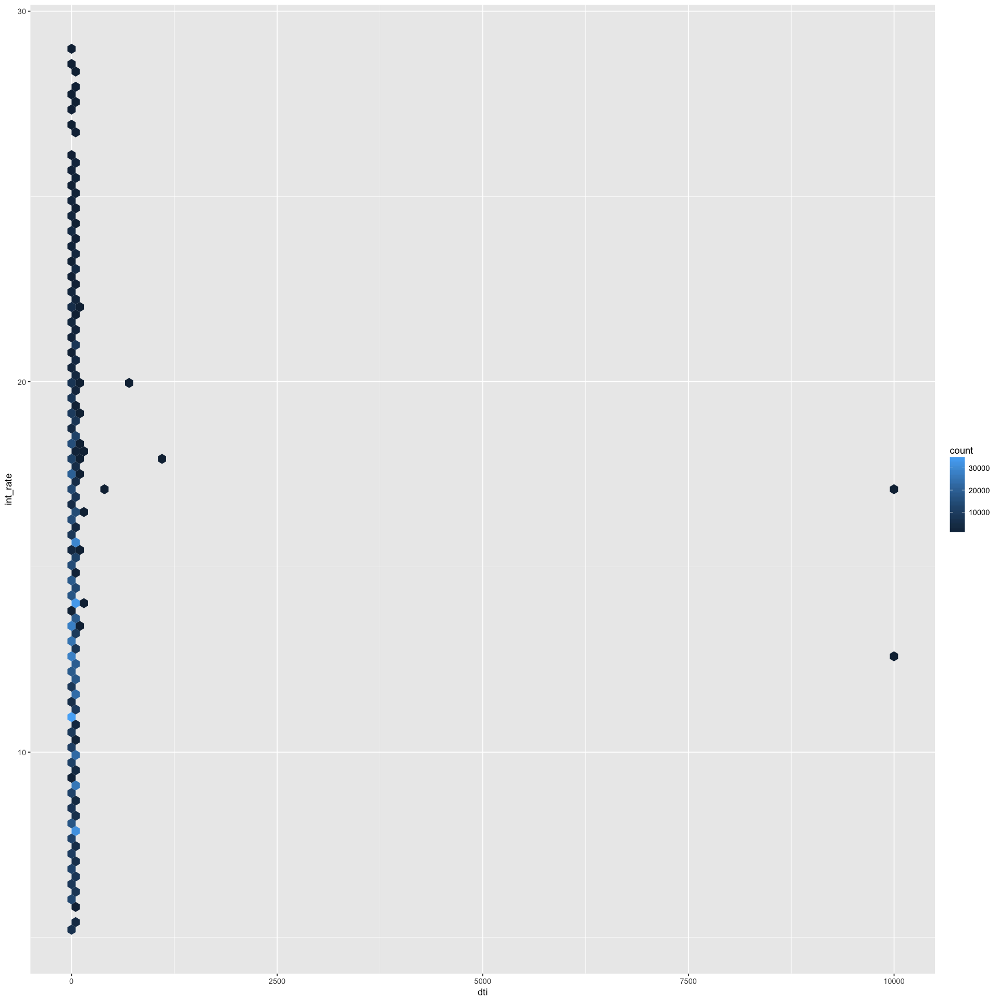

In [86]:
options(repr.plot.width=16, repr.plot.height=16)
ggplot(loan, aes(x = dti, y=int_rate)) + geom_hex(bins=100) #+ stat_smooth(method=lm)


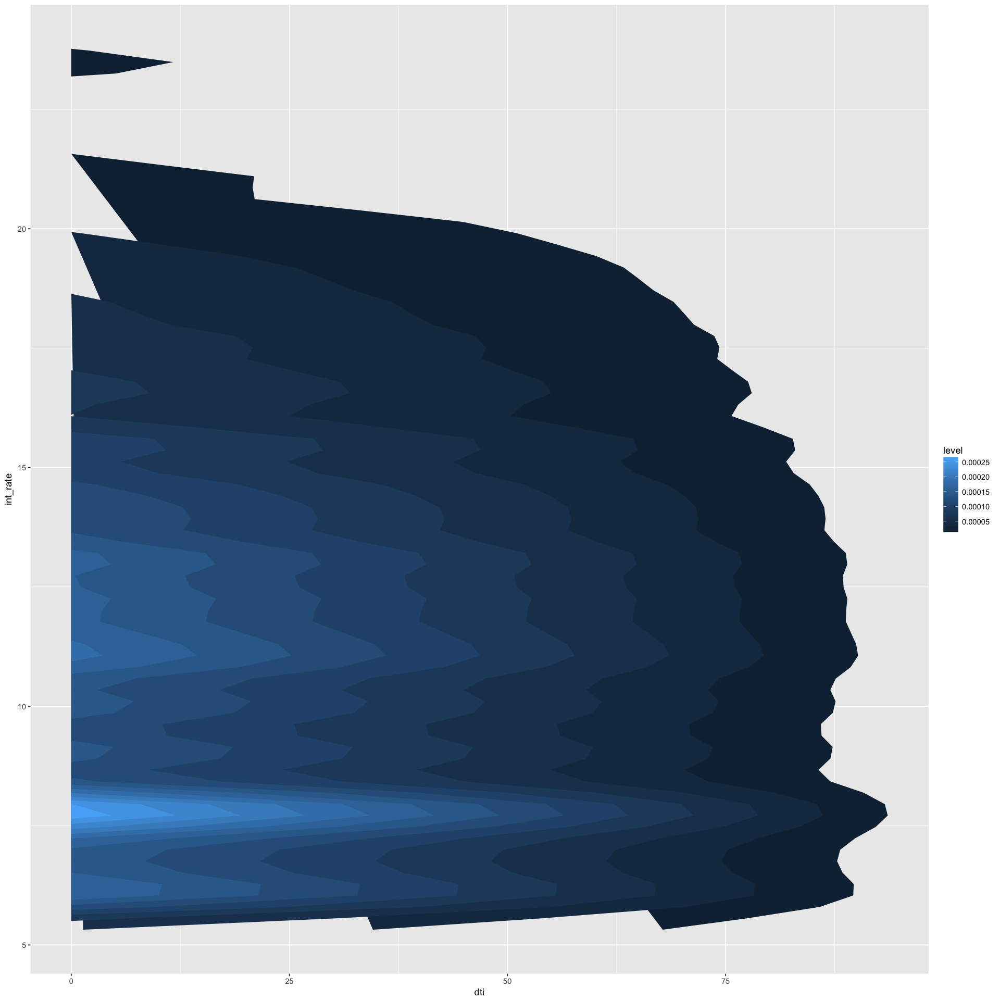

In [87]:
ggplot(loan, aes(x = dti, y=int_rate)) + 
stat_density_2d(aes(fill = ..level..), geom = "polygon")

In [88]:
# weak linear relationship
cor(loan$dti, loan$int_rate)

[1] 0.07990255

Analysis:  
weak linear relationship, looks even no relationship, or needs grouping



In [89]:
loan$dti[which(loan$dti == NA)] <- 9999

In [90]:
loan$dti_group <- with(loan,ifelse(dti <=100,1,ifelse(dti <= 200,2,3)))


In [91]:
table(loan$dti_group)


     1      2      3 
887368      6      5 

In [92]:
loan$annual_inc[which(loan$dti_group!=1)]
loan$emp_title[which(loan$dti_group!=1)]
loan$home_ownership[which(loan$dti_group!=1)]

[1]  1770.00 20000.00 17000.00 75027.59 27000.00  8700.00 75027.59  5000.00
 [9]  1200.00  9745.00 12000.00

[1] NA                   NA                   "partner"           
 [4] NA                   "manager"            NA                  
 [7] NA                   "distributer"        NA                  
[10] NA                   "instructional aide"

[1] "MORTGAGE" "MORTGAGE" "RENT"     "MORTGAGE" "RENT"     "MORTGAGE"
 [7] "MORTGAGE" "MORTGAGE" "RENT"     "MORTGAGE" "MORTGAGE"

In [93]:
quantile(loan$annual_inc)

0%     25%     50%     75%    100% 
   1200   45000   65000   90000 9500000

In [94]:
loan$total_acc[which(loan$dti_group!=1)]
loan$addr_state[which(loan$dti_group!=1)]
loan$purpose[which(loan$dti_group!=1)]

[1] 25 28 17 11 16 26 20 62 13 53 42

[1] "TX" "TX" "NV" "TX" "MD" "CA" "TX" "TX" "TX" "ME" "KY"

[1] "credit_card"        "debt_consolidation" "debt_consolidation"
 [4] "debt_consolidation" "debt_consolidation" "debt_consolidation"
 [7] "credit_card"        "other"              "debt_consolidation"
[10] "debt_consolidation" "home_improvement"

In [95]:
loan$grade[which(loan$dti_group!=1)]
loan$sub_grade[which(loan$dti_group!=1)]
loan$loan_status[which(loan$dti_group!=1)]
loan$loan_amnt[which(loan$dti_group!=1)]


[1] "D" "D" "E" "D" "E" "D" "C" "D" "E" "D" "C"

[1] "D5" "D2" "E1" "D3" "E1" "D1" "C2" "D3" "E4" "D5" "C4"

[1] "Current" "Current" "Issued"  "Current" "Current" "Current" "Current"
 [8] "Current" "Current" "Current" "Current"

[1]  6550 15000 28000 20000 20000 15000  3700 19000 12000 12000  5000

Analysis:  
for those dti ratio > 100, only 9 points, and they are all low income people, they have same emp_title, 4 from TX, 1 from NV, 1 from CA, and their home either mortaged or rent, and they all have more than 10 credit lines. maybe we need to delete those 9 points or set an indicator for the dti ratio > 100?


##### 11. dti_joint with int_rate



In [96]:
# drop this feature
sum(is.na(loan$dti_joint))/dim(loan)[1]

[1] 0.9994264

##### 12. earliest_cr_line with int_rate
earliest_cr_line : The month the borrower's earliest reported credit line was opened

time series

In [97]:
# missing percentage
sum(is.na(loan$earliest_cr_line))/dim(loan)[1]

[1] 0

In [98]:
length(unique(loan$earliest_cr_line))

[1] 698

In [99]:
# transform into time series data
library(zoo)
loan$earliest_cr_line_date = as.Date(as.yearmon(loan$earliest_cr_line,'%b-%Y'))


Attaching package: ‘zoo’

The following objects are masked from ‘package:base’:

    as.Date, as.Date.numeric



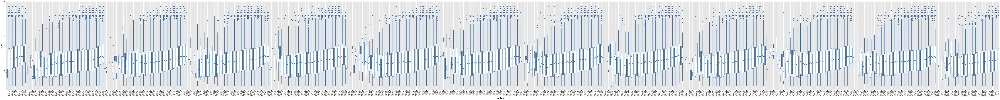

In [100]:
# box plot
options(repr.plot.width = 80,repr.plot.height=8)
ggplot(loan,aes(x=factor(earliest_cr_line),y=int_rate))+
geom_boxplot(color='steelblue')+
labs(x='emp_length_sim')+
theme(axis.text.x = element_text(angle=90,hjust=1,vjust=0.5),legend.position="none")



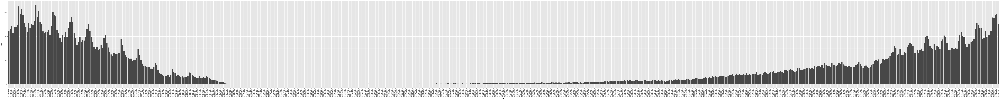

In [101]:
# bar plot
options(repr.plot.width=80 ,repr.plot.height = 8)
ggplot(as.data.frame(table(loan$earliest_cr_line_date)),aes(x=Var1,y=Freq))+
geom_bar(stat='identity')+
theme(axis.text.x=element_text(angle=90,hjust=1,vjust=0.5),legend.position='none')

In [102]:
# time series features for peak at every sep or august for count

##### 13. inq_fi with int_rate
inq_fi : number of personal finance inquiries 

In [103]:
# missing percentage
sum(is.na(loan$inq_fi))/dim(loan)[1]

[1] 0.9759156

In [104]:
unique(loan$inq_fi)

[1] NA  1  0  2  3  6  4  5  8 16  7  9 10 13 11 17 12 14 15

In [105]:
# drop this feature

##### 14. inq_last_12m with int_rate
inq_last_12m : number of credit inquiries in past 12 month

In [106]:
# missing percentage
sum(is.na(loan$inq_last_12m))/dim(loan)[1]
# drop this feature

[1] 0.9759156

##### 14. inq_last_6mths with int_rate
inq_last_6mths : number of inquiries in past 6 month (excluding auto and mortgage inquiries)

In [107]:
# missing percentage
sum(is.na(loan$inq_last_6mths))/dim(loan)[1]

[1] 3.268051e-05

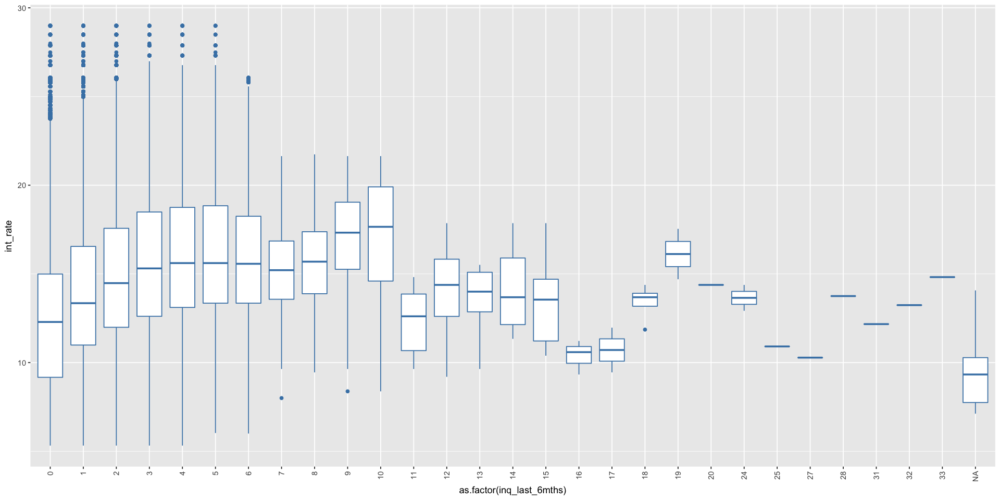

In [108]:
# box plot
options(repr.plot.width=16,repr.plot.height=8)
ggplot(loan,aes(x=as.factor(inq_last_6mths),y=int_rate))+
geom_boxplot(color='steelblue')+
labs('x= number of inquiries in past 6 month')+
theme(axis.text.x=element_text(angle=90,hjust=1,vjust=0.5),legend.position='none')

In [109]:
# lots of factor only have 1 point
table(loan$inq_last_6mths)


     0      1      2      3      4      5      6      7      8      9     10 
497905 241494  94117  37398  10758   3985   1231    195    122     50     24 
    11     12     13     14     15     16     17     18     19     20     24 
    15     15      6      6      9      3      2      4      2      1      2 
    25     27     28     31     32     33 
     1      1      1      1      1      1 

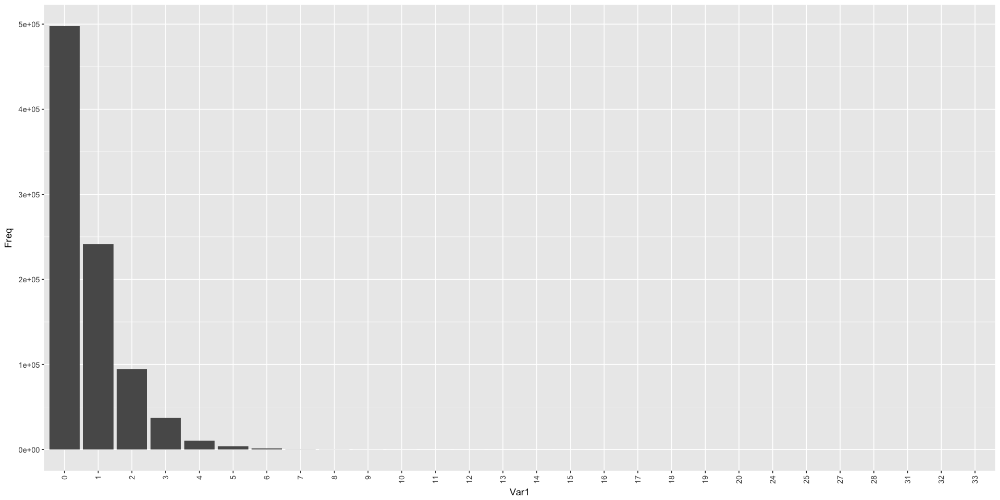

In [110]:
# bar plot
options(repr.plot.width=16,repr.plot.height=8)
ggplot(as.data.frame(table(loan$inq_last_6mths)),aes(x=Var1,y=Freq))+
geom_bar(stat='identity')+
theme(axis.text.x=element_text(angle=90,hjust=1,vjust=0.5),legend.position='none')


In [111]:
# feature engineering: bin>4 => 5
loan$gen_inq_last_6mths = loan$inq_last_6mths
loan$gen_inq_last_6mths[loan$inq_last_6mths>4] = 5

##### 15. last_credit_pull_d with int_rate
last_credit_pull_d  : the most recent month LC pulled credit for this loan


In [112]:
# missing percentage
sum(is.na(loan$last_credit_pull_d_date))/dim(loan)[1]

Warning message in is.na(loan$last_credit_pull_d_date):
“is.na() applied to non-(list or vector) of type 'NULL'”

[1] 0

In [113]:
# transform to date
library(zoo)
loan$last_credit_pull_d_date = as.Date(as.yearmon(loan$last_credit_pull_d,'%b-%Y'))

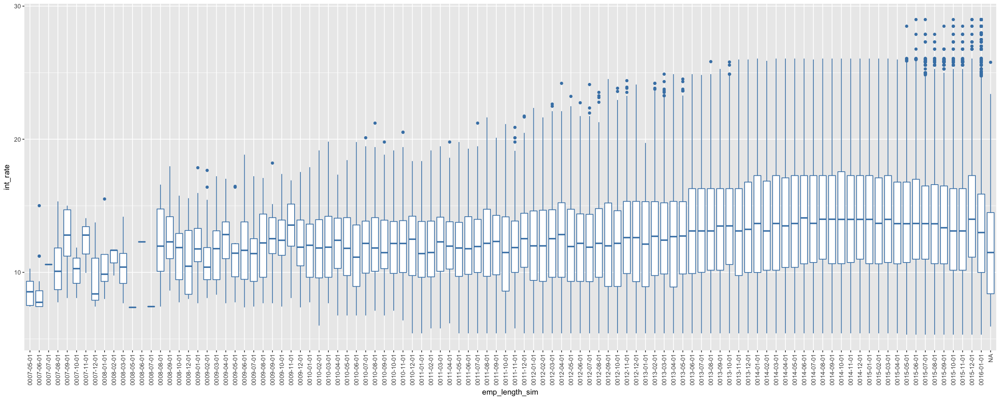

In [114]:
# box plot
options(repr.plot.width=20, repr.plot.height=8)
ggplot(loan, aes(x=factor(last_credit_pull_d_date), y=int_rate)) + 
geom_boxplot(color='steelblue') + labs(x='emp_length_sim') + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

In [115]:
table(loan$last_credit_pull_d_date)


0007-05-01 0007-06-01 0007-07-01 0007-08-01 0007-09-01 0007-10-01 0007-11-01 
        10         16          1         17          5          3          3 
0007-12-01 0008-01-01 0008-02-01 0008-03-01 0008-05-01 0008-06-01 0008-07-01 
         3          4          3          8          1          1          1 
0008-08-01 0008-09-01 0008-10-01 0008-12-01 0009-01-01 0009-02-01 0009-03-01 
        15          9         13          7         40         21         17 
0009-04-01 0009-05-01 0009-06-01 0009-07-01 0009-08-01 0009-09-01 0009-10-01 
        25         14         20         21         33         21         54 
0009-11-01 0009-12-01 0010-01-01 0010-02-01 0010-03-01 0010-04-01 0010-05-01 
        53         75         36         88         74         79         64 
0010-06-01 0010-07-01 0010-08-01 0010-09-01 0010-10-01 0010-11-01 0010-12-01 
        67        140         73        121        123        127        159 
0011-01-01 0011-02-01 0011-03-01 0011-04-01 0011-05-01 0011-06-

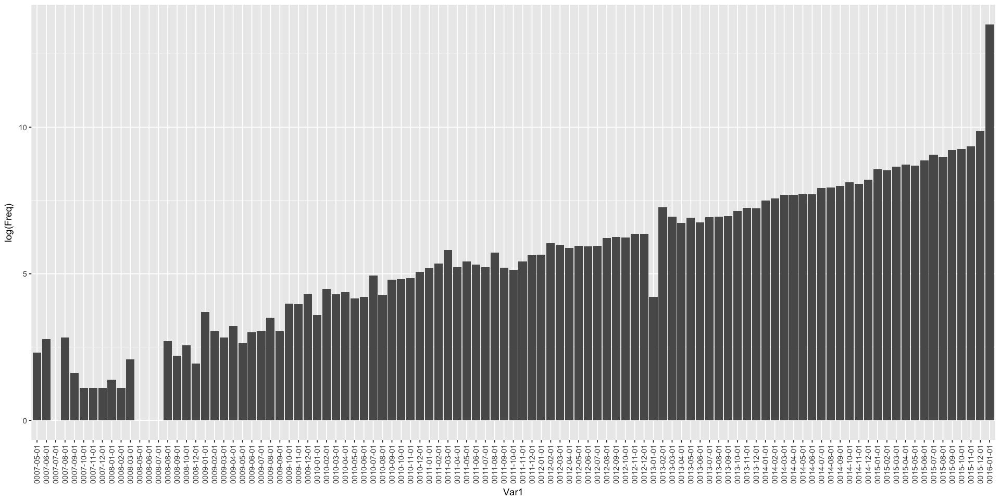

In [116]:
# barplot
options(repr.plot.width=16, repr.plot.height=8)
ggplot(as.data.frame(table(loan$last_credit_pull_d_date)), aes(x=Var1, y=log(Freq))) + 
geom_bar(stat="identity") + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

In [117]:
# this feature seems not very useful for the int_rate

##### 16. total_acc with int_rate
total_acc  : the total number of credit lines currently in the borrower's credit file


In [118]:
# missing percentage
sum(is.na(loan$total_acc))/dim(loan)[1]

[1] 3.268051e-05

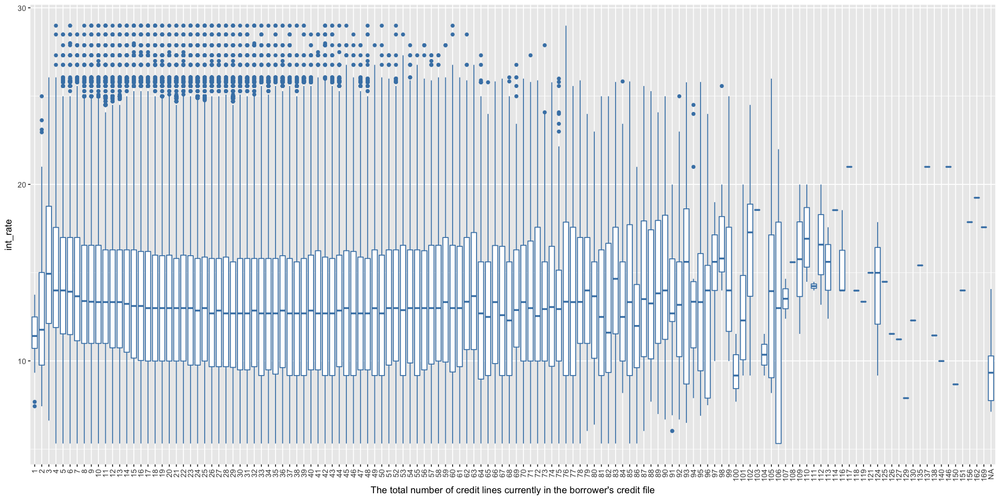

In [119]:
# boxplot
options(repr.plot.width=16, repr.plot.height=8)
ggplot(loan, aes(x=factor(total_acc), y=int_rate)) + 
geom_boxplot(color='steelblue') + labs(x="The total number of credit lines currently in the borrower's credit file") + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

In [120]:
# lots of level only has 1 point
table(loan$total_acc)


    1     2     3     4     5     6     7     8     9    10    11    12    13 
   21    62   472  2873  4645  6804  9364 11994 14684 17416 19938 22125 24720 
   14    15    16    17    18    19    20    21    22    23    24    25    26 
26289 27944 29126 30768 31108 31574 32118 32009 32259 31315 31039 29721 29018 
   27    28    29    30    31    32    33    34    35    36    37    38    39 
27624 26150 25021 23795 21999 20958 19099 17887 16456 15206 14094 12586 11870 
   40    41    42    43    44    45    46    47    48    49    50    51    52 
10710  9806  8923  8036  7389  6583  5881  5362  4745  4204  3883  3368  3039 
   53    54    55    56    57    58    59    60    61    62    63    64    65 
 2690  2348  2081  1849  1618  1509  1356  1159  1161  1133  1877   518   461 
   66    67    68    69    70    71    72    73    74    75    76    77    78 
  374   331   324   285   250   215   158   186   152   136   105   101    96 
   79    80    81    82    83    84    85    86    

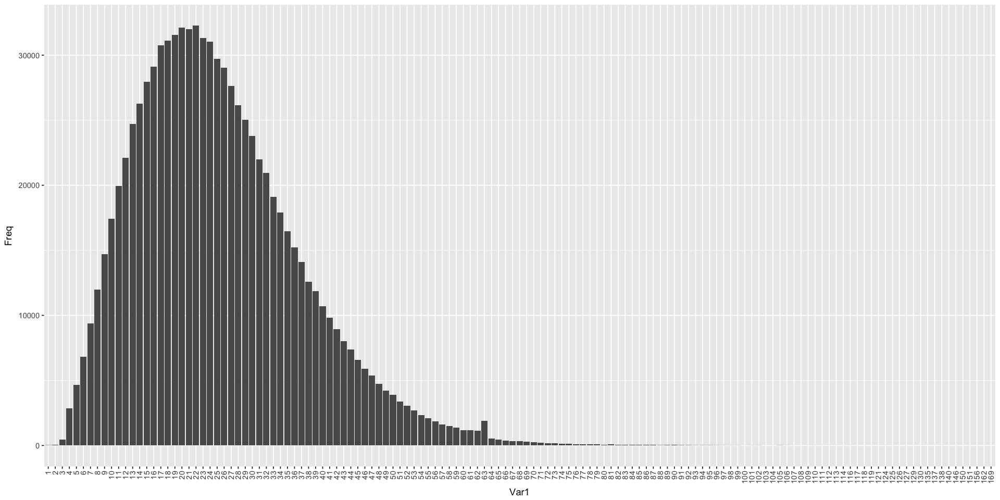

In [121]:
# barplot
options(repr.plot.width=16, repr.plot.height=8)
ggplot(as.data.frame(table(loan$total_acc)), aes(x=Var1, y=Freq)) + 
geom_bar(stat="identity") + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")
# little bit skewness

In [122]:
# could be modeled as log normal,,,

##### 17. total_cur_bal with int_rate
total_cur_bal  : total current balance of all accounts

In [123]:
# missing percentage
sum(is.na(loan$tot_cur_bal))/dim(loan)[1]

[1] 0.07919502

Warning message:
“Removed 70276 rows containing non-finite values (stat_binhex).”Warning message:
“Removed 70276 rows containing non-finite values (stat_smooth).”

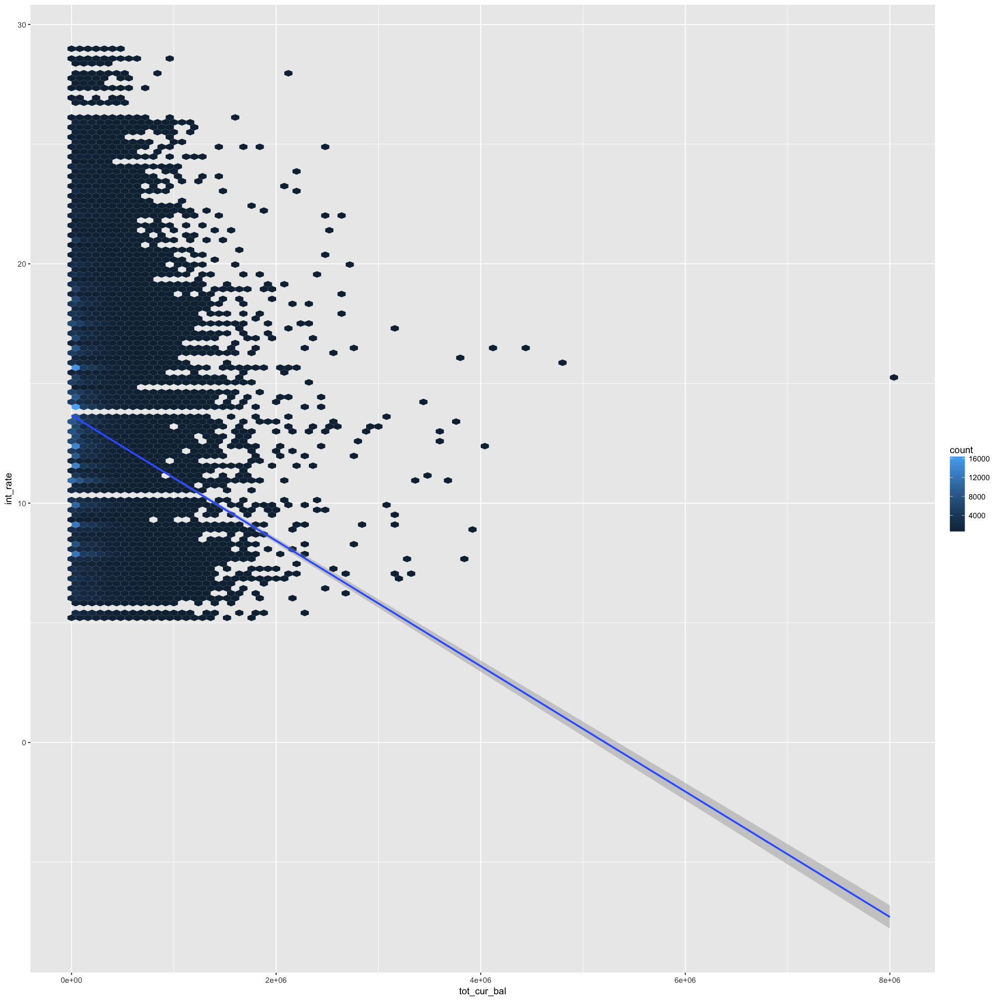

In [124]:
# linear relationship
options(repr.plot.width=16, repr.plot.height=16)
ggplot(loan, aes(x = tot_cur_bal, y=int_rate)) + geom_hex(bins=100) + stat_smooth(method=lm)
# more or less we can try log transformation. 

Warning message:
“Removed 70402 rows containing non-finite values (stat_binhex).”Warning message:
“Removed 70402 rows containing non-finite values (stat_smooth).”

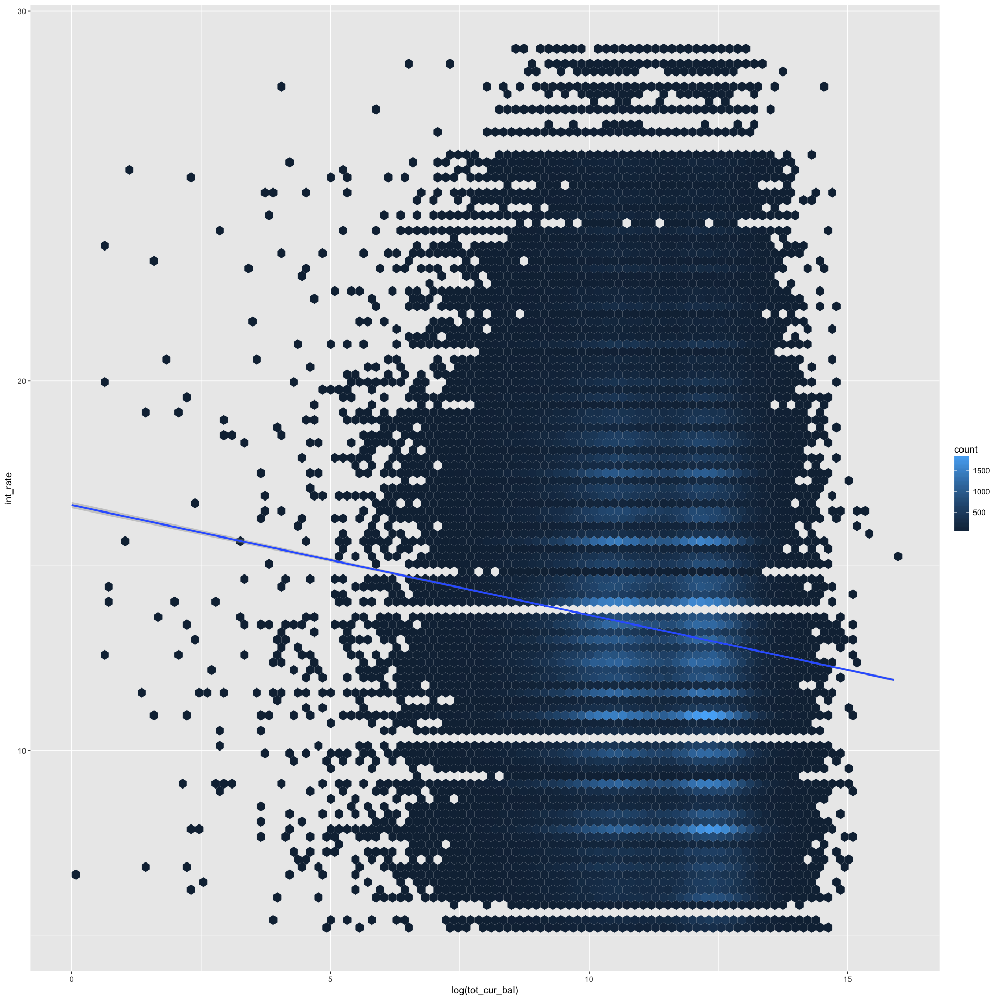

In [125]:
options(repr.plot.width=16, repr.plot.height=16)
ggplot(loan, aes(x = log(tot_cur_bal), y=int_rate)) + geom_hex(bins=100) + stat_smooth(method=lm)

In [126]:
# feature engineering: log transformation
loan$gen_log_tot_cur_bal = log(loan$tot_cur_bal)

##### 18. all_util with int_rate
all_util : Balance to credit limit on all trades

In [127]:
# missing percentage
sum(is.na(loan$all_util))/dim(loan)[1]
# drop this feature

[1] 0.9759156

##### 19. open_acc with int_rate
open_acc : The number of open credit lines in the borrower's credit file.

In [128]:
# missing percentage

sum(is.na(loan$open_acc))/dim(loan)[1]

[1] 3.268051e-05

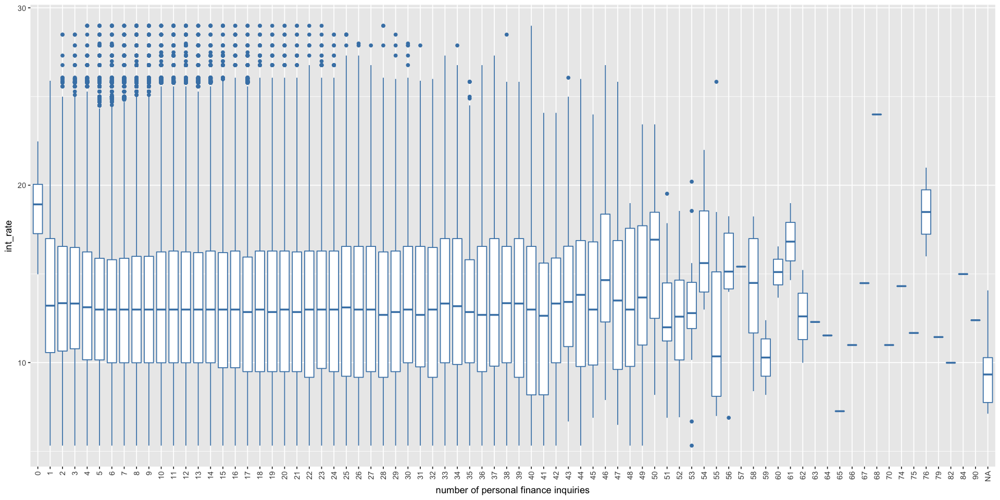

In [129]:
# box plot
options(repr.plot.width=16, repr.plot.height=8)
ggplot(loan, aes(x=factor(open_acc), y=int_rate)) + 
geom_boxplot(color='steelblue') + labs(x='number of personal finance inquiries') + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

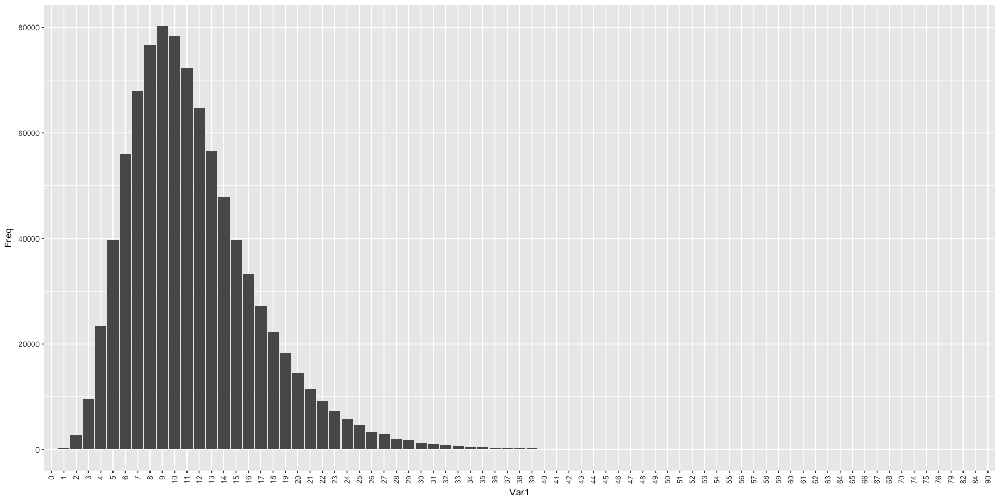

In [130]:
# barplot
options(repr.plot.width=16, repr.plot.height=8)
ggplot(as.data.frame(table(loan$open_acc)), aes(x=Var1, y=Freq)) + 
geom_bar(stat="identity") + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

In [131]:
# similar as total_acc, can be modeled as log normal, too

##### 20. open_acc_6m with int_rate
open_acc_6m : Number of open trades in last 6 months

In [132]:
# missing percentage
sum(is.na(loan$open_acc_6m))/dim(loan)[1]
# drop feature

[1] 0.9759156

##### 21. total_cu_tl with int_rate
total_cu_tl : Number of finance trades

In [133]:
# missing percentage
sum(is.na(loan$total_cu_tl))/dim(loan)[1]
# drop feature

[1] 0.9759156

##### 22. acc_now_deling with int_rate
acc_now_deling : The number of accounts on which the borrower is now delinquent.


In [134]:
# missing percentage
sum(is.na(loan$acc_now_delinq))/dim(loan)[1]

[1] 3.268051e-05

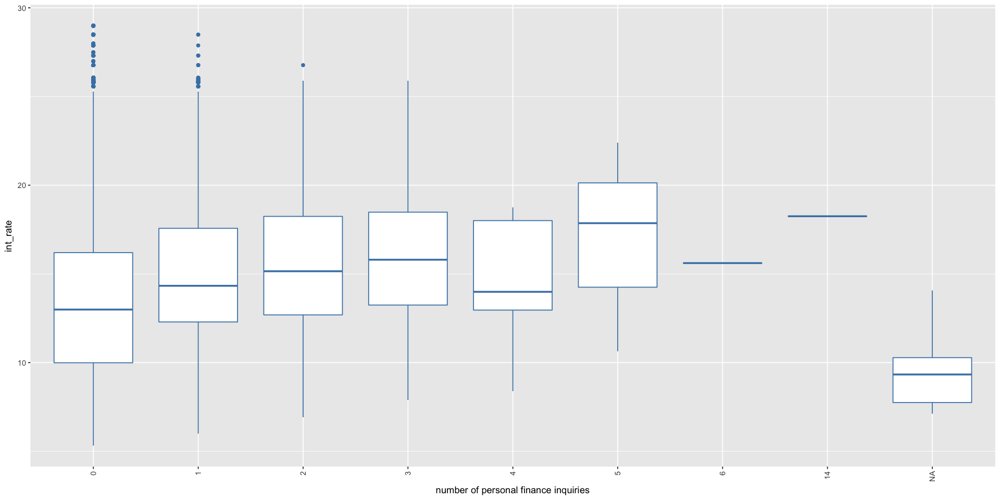

In [135]:
# box plot
options(repr.plot.width=16, repr.plot.height=8)
ggplot(loan, aes(x=factor(acc_now_delinq), y=int_rate)) + 
geom_boxplot(color='steelblue') + labs(x='number of personal finance inquiries') + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

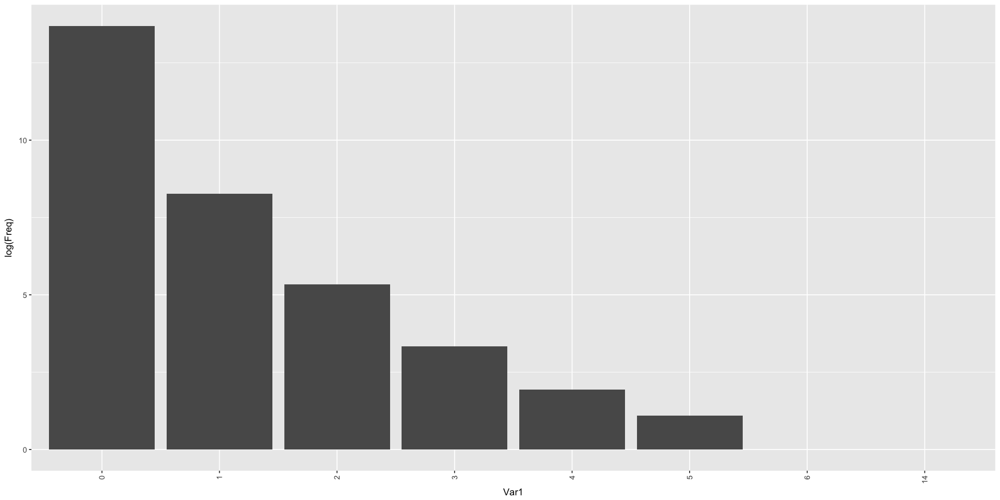

In [136]:
# bar plot
options(repr.plot.width=16, repr.plot.height=8)
ggplot(as.data.frame(table(loan$acc_now_delinq)), aes(x=Var1, y=log(Freq))) + 
geom_bar(stat="identity") + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

In [137]:
table(loan$acc_now_delinq)


     0      1      2      3      4      5      6     14 
883236   3866    208     28      7      3      1      1 

In [138]:
# annova
aov.res = aov(int_rate ~ factor(acc_now_delinq), na.action = na.omit, data = loan, )
summary(aov.res)
tukey.res = TukeyHSD(aov.res, conf.level = 0.95)                   # find significance between groups
tukey.res
significant.groups = rownames(tukey.res[[1]])           
sort(significant.groups[tukey.res[[1]][, 4] < 0.05])   

                           Df   Sum Sq Mean Sq F value Pr(>F)    
factor(acc_now_delinq)      7    12725  1817.9   94.75 <2e-16 ***
Residuals              887342 17025096    19.2                   
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1
29 observations deleted due to missingness

  Tukey multiple comparisons of means
    95% family-wise confidence level

Fit: aov(formula = int_rate ~ factor(acc_now_delinq), data = loan, na.action = na.omit)

$`factor(acc_now_delinq)`
            diff         lwr       upr     p adj
1-0   1.70348438   1.4894984  1.917470 0.0000000
2-0   2.43956941   1.5189349  3.360204 0.0000000
3-0   2.92232353   0.4133524  5.431295 0.0098677
4-0   1.48410924  -3.5337733  6.501992 0.9864684
5-0   3.72791877  -3.9370061 11.392844 0.8214732
6-0   2.37125210 -10.9047721 15.647276 0.9994325
14-0  5.01125210  -8.2647721 18.287276 0.9470459
2-1   0.73608503  -0.2088799  1.681050 0.2608250
3-1   1.21883915  -1.2991614  3.736840 0.8250802
4-1  -0.21937514  -5.2417786  4.803028 1.0000000
5-1   2.02443439  -5.6434508  9.692320 0.9931548
6-1   0.66776772 -12.6099659 13.945501 0.9999999
14-1  3.30776772  -9.9699659 16.585501 0.9952113
3-2   0.48275412  -2.1897175  3.155226 0.9993888
4-2  -0.95546016  -6.0570593  4.146139 0.9992254
5-2   1.28834936  -6.4316

[1] "1-0" "2-0" "3-0"

In [139]:
# analysis: number increase, generally int_rate increase, and the data points that larger than 1 is very rare
# feature engineering: bin > 1
loan$gen_acc_now_delinq = loan$acc_now_delinq
loan$gen_acc_now_delinq[loan$acc_now_delinq>=1] = 1

In [140]:
# t-test on group means
t.test(int_rate ~ gen_acc_now_delinq, data = loan, na.action = na.omit) # significant


	Welch Two Sample t-test

data:  int_rate by gen_acc_now_delinq
t = -27.347, df = 4157, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -1.876601 -1.625528
sample estimates:
mean in group 0 mean in group 1 
       13.23875        14.98981 


##### 23. delinq_2yrs with int_rate
delinq_2yrs : The number of 30+ days past-due incidences of delinquency in the borrower's credit file for the past 2 years

In [141]:
# missing percentage
sum(is.na(loan$delinq_2yrs))/dim(loan)[1]

[1] 3.268051e-05

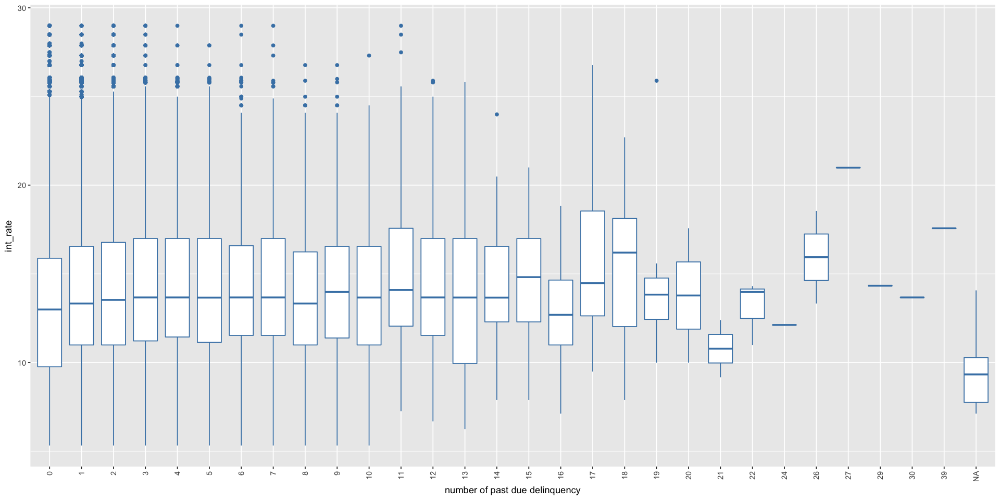

In [142]:
# boxplot
options(repr.plot.width=16, repr.plot.height=8)
ggplot(loan, aes(x=factor(delinq_2yrs), y=int_rate)) + 
geom_boxplot(color='steelblue') + labs(x='number of past due delinquency') + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

In [143]:
table(loan$delinq_2yrs)


     0      1      2      3      4      5      6      7      8      9     10 
716961 113224  33551  11977   5327   2711   1471    784    461    284    192 
    11     12     13     14     15     16     17     18     19     20     21 
   121     89     64     45     28     17     10     11      8      2      2 
    22     24     26     27     29     30     39 
     3      1      2      1      1      1      1 

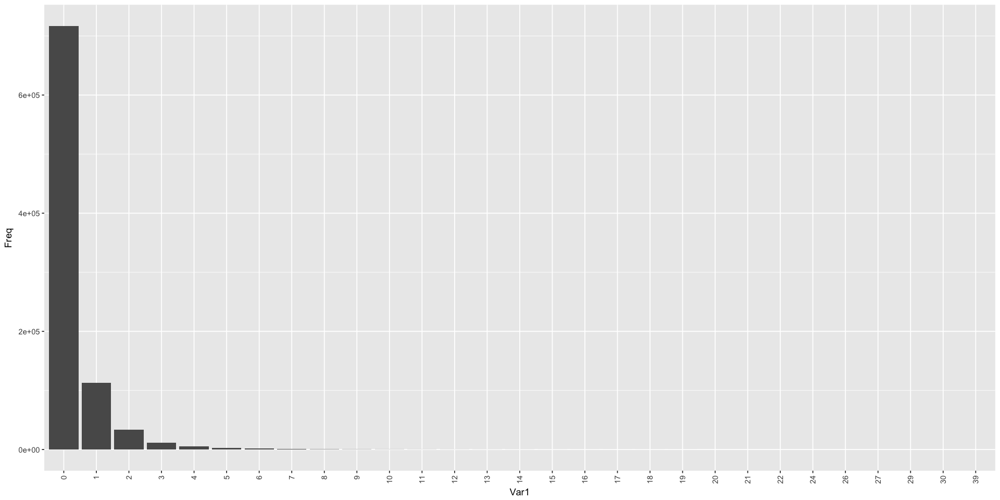

In [144]:
# bar plot
options(repr.plot.width=16, repr.plot.height=8)
ggplot(as.data.frame(table(loan$delinq_2yrs)), aes(x=Var1, y=Freq)) + 
geom_bar(stat="identity") + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

In [145]:
# annova
aov.res = aov(int_rate ~ factor(delinq_2yrs), na.action = na.omit, data = loan, )
summary(aov.res)
tukey.res = TukeyHSD(aov.res, conf.level = 0.95)                   # find significance between groups
tukey.res
significant.groups = rownames(tukey.res[[1]])           
sort(significant.groups[tukey.res[[1]][, 4] < 0.05])   

                        Df   Sum Sq Mean Sq F value Pr(>F)    
factor(delinq_2yrs)     28    71906  2568.1   134.3 <2e-16 ***
Residuals           887321 16965914    19.1                   
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1
29 observations deleted due to missingness

  Tukey multiple comparisons of means
    95% family-wise confidence level

Fit: aov(formula = int_rate ~ factor(delinq_2yrs), data = loan, na.action = na.omit)

$`factor(delinq_2yrs)`
              diff           lwr        upr     p adj
1-0    0.601048080  5.488632e-01  0.6532330 0.0000000
2-0    0.835976908  7.448277e-01  0.9271261 0.0000000
3-0    0.989038978  8.386908e-01  1.1393871 0.0000000
4-0    1.010607721  7.861985e-01  1.2350169 0.0000000
5-0    0.992981940  6.789821e-01  1.3069818 0.0000000
6-0    1.025360145  5.994545e-01  1.4512657 0.0000000
7-0    1.071206205  4.880916e-01  1.6543208 0.0000000
8-0    0.648618469 -1.116443e-01  1.4088813 0.2465604
9-0    0.969064605  5.605334e-04  1.9375687 0.0496349
10-0   0.819881800 -3.579470e-01  1.9977106 0.6936216
11-0   1.510216683  2.661068e-02  2.9938227 0.0397012
12-0   1.286554319 -4.432882e-01  3.0163969 0.5489191
13-0   0.555558883 -1.484318e+00  2.5954361 0.9999999
14-0   0.873902633 -1.558761e+00  3.3065659 0.9999685
15-0 

[1] "1-0"  "11-0" "2-0"  "2-1"  "3-0"  "3-1"  "4-0"  "4-1"  "5-0"  "5-1" 
[11] "6-0"  "7-0"  "9-0"

In [146]:
# analysis: bin >1 into 2: maybe we will only choose 1 between delinq_2yrs and acc_now_delinq
loan$gen_delinq_2yrs = loan$delinq_2yrs
loan$gen_delinq_2yrs[loan$delinq_2yrs>1] = 2

##### 24. mths_since_last_delinq with int_rate
mths_since_last_delinq : The number of months since the borrower's last delinquency.

In [147]:
# missing percentage
sum(is.na(loan$mths_since_last_delinq))/dim(loan)[1]
# drop

[1] 0.5119706

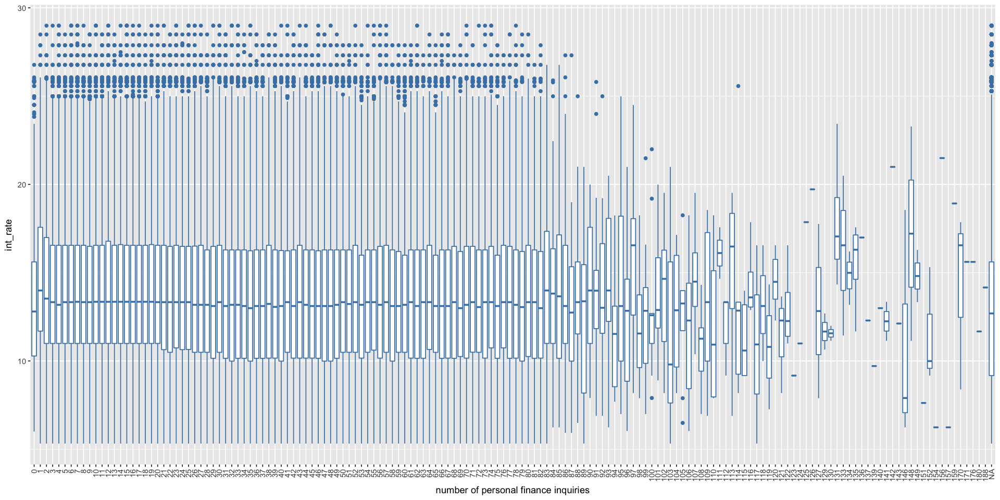

In [148]:
# boxplot
options(repr.plot.width=16, repr.plot.height=8)
ggplot(loan, aes(x=factor(mths_since_last_delinq), y=int_rate)) + 
geom_boxplot(color='steelblue') + labs(x='number of personal finance inquiries') + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

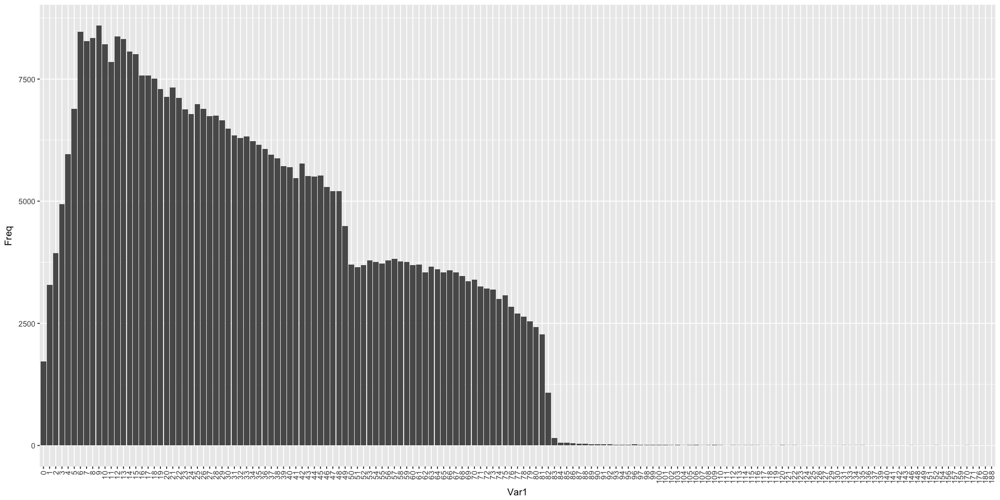

In [149]:
# bar plot
options(repr.plot.width=16, repr.plot.height=8)
ggplot(as.data.frame(table(loan$mths_since_last_delinq)), aes(x=Var1, y=Freq)) + 
geom_bar(stat="identity") + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

##### 25. collections_12_mths_ex_med with int_rate
collections_12_mths_ex_med : Number of collections in 12 months excluding medical collections

In [150]:
# missing percentage
sum(is.na(loan$collections_12_mths_ex_med))/dim(loan)[1]

[1] 0.0001634026

In [151]:
table(loan$collections_12_mths_ex_med)


     0      1      2      3      4      5      6      7     10     14     16 
875553  10824    732     88     23      7      2      1      1      1      1 
    20 
     1 

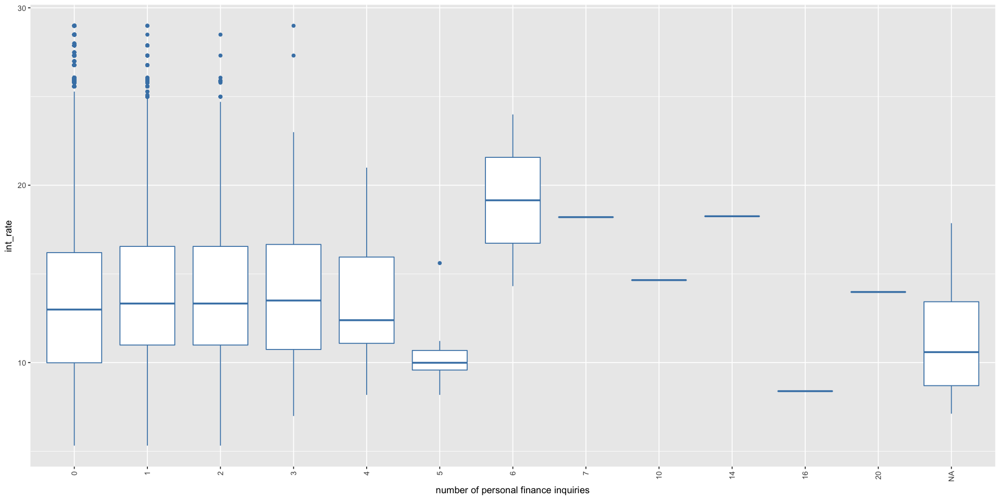

In [152]:
# boxplot
options(repr.plot.width=16, repr.plot.height=8)
ggplot(loan, aes(x=factor(collections_12_mths_ex_med), y=int_rate)) + 
geom_boxplot(color='steelblue') + labs(x='number of personal finance inquiries') + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

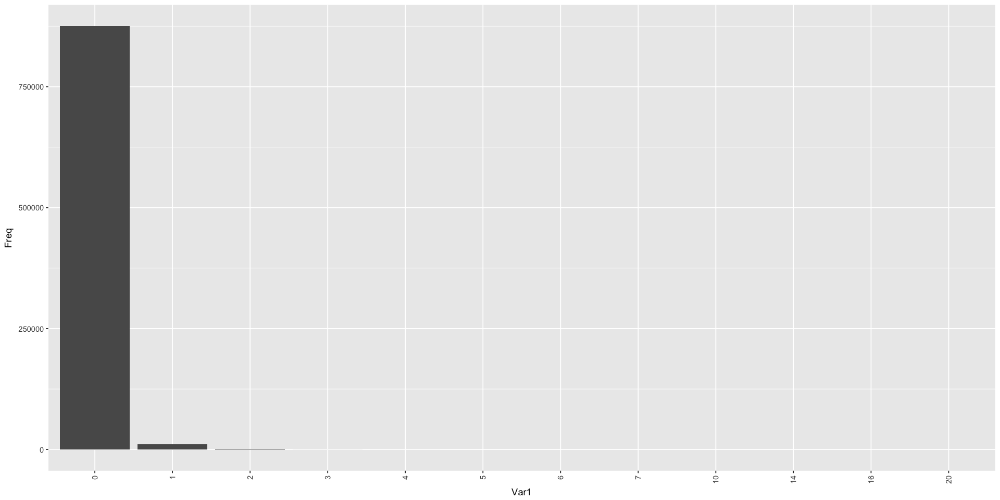

In [153]:
# barplot
options(repr.plot.width=16, repr.plot.height=8)
ggplot(as.data.frame(table(loan$collections_12_mths_ex_med)), aes(x=Var1, y=Freq)) + 
geom_bar(stat="identity") + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

In [154]:
# not affect int_rate compared with other features, maybe drop


##### 26. tot_coll_amt with int_rate
tot_coll_amt : Total collection amounts ever owed

In [155]:
# missing percentage
sum(is.na(loan$tot_coll_amt))/dim(loan)[1]

[1] 0.07919502

Warning message:
“Removed 70276 rows containing non-finite values (stat_binhex).”

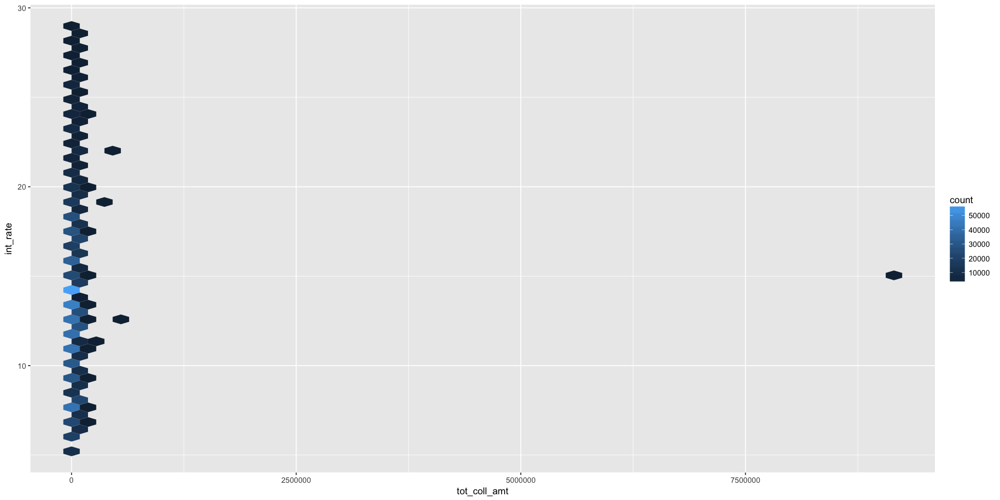

In [156]:
options(repr.plot.width=16, repr.plot.height=8)
ggplot(loan, aes(x=tot_coll_amt, y=int_rate)) + geom_hex(bins=50)

In [157]:
# generate feature log tot_coll_amt
loan$gen_log_tot_coll_amt = log(loan$tot_coll_amt)

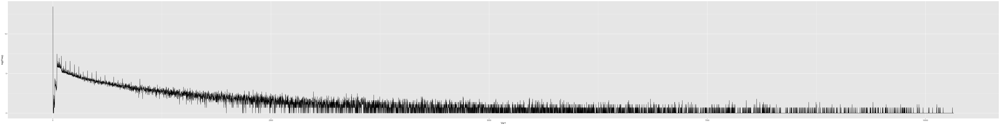

In [158]:
options(repr.plot.width=64, repr.plot.height=8)
tot_coll_amt.data = as.data.frame(table(loan$tot_coll_amt))
tot_coll_amt.data = as.data.frame(sapply(tot_coll_amt.data[, 1:2], as.numeric))
ggplot(tot_coll_amt.data, aes(x=Var1, y=log(Freq))) + 
geom_line()

##### 27. pub_rec with int_rate
pub_rec : Number of derogatory public records

In [159]:
# missing percentage
sum(is.na(loan$pub_rec))/dim(loan)[1]

[1] 3.268051e-05

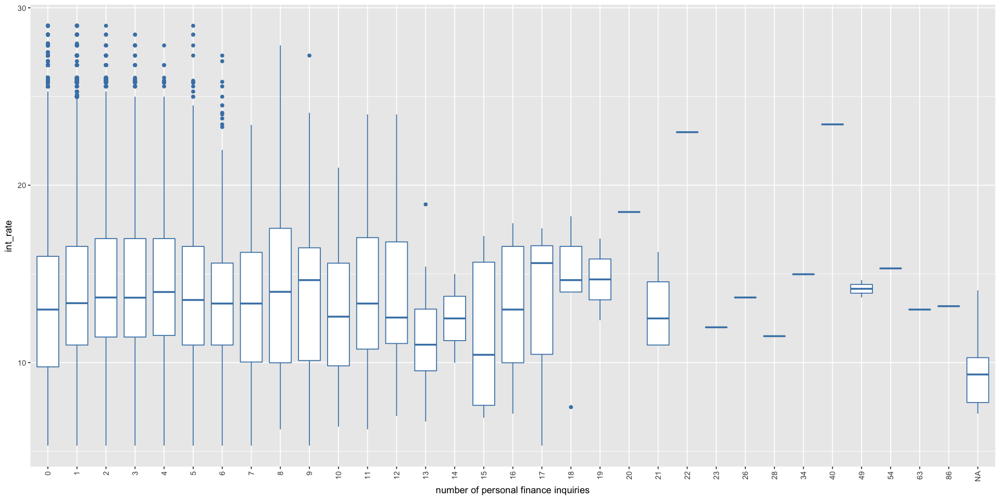

In [160]:
# boxplot
options(repr.plot.width=16, repr.plot.height=8)
ggplot(loan, aes(x=factor(pub_rec), y=int_rate)) + 
geom_boxplot(color='steelblue') + labs(x='number of personal finance inquiries') + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

In [161]:
table(loan$pub_rec)


     0      1      2      3      4      5      6      7      8      9     10 
751572 113266  14854   4487   1564    757    385    170    113     50     42 
    11     12     13     14     15     16     17     18     19     20     21 
    23     16     12      2      6      5      3      5      2      1      4 
    22     23     26     28     34     40     49     54     63     86 
     1      1      1      1      1      1      2      1      1      1 

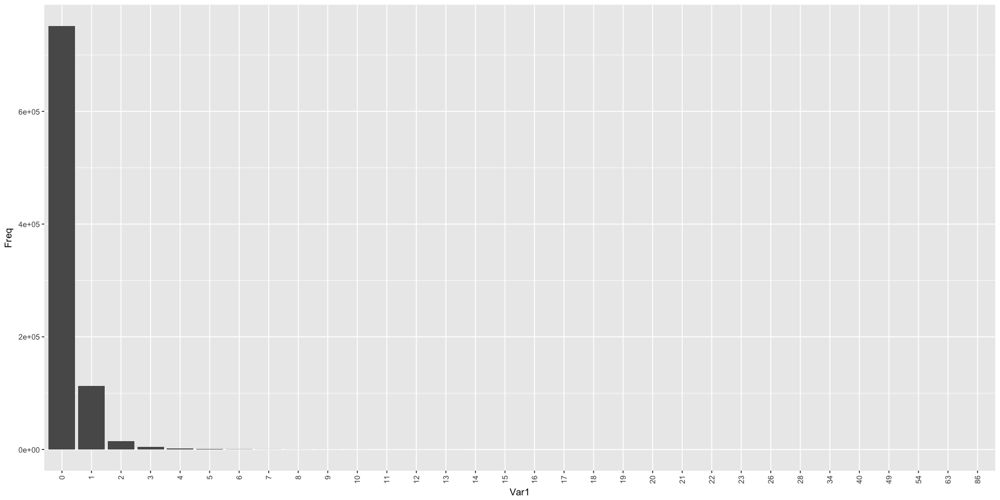

In [162]:
# barplot
options(repr.plot.width=16, repr.plot.height=8)
ggplot(as.data.frame(table(loan$pub_rec)), aes(x=Var1, y=Freq)) + 
geom_bar(stat="identity") + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

In [163]:
# annova
aov.res = aov(int_rate ~ factor(pub_rec), na.action = na.omit, data = loan, )
summary(aov.res)
tukey.res = TukeyHSD(aov.res, conf.level = 0.95)                   # find significance between groups
tukey.res
significant.groups = rownames(tukey.res[[1]])           
sort(significant.groups[tukey.res[[1]][, 4] < 0.05])   

                    Df   Sum Sq Mean Sq F value Pr(>F)    
factor(pub_rec)     31    71369  2302.2   120.4 <2e-16 ***
Residuals       887318 16966451    19.1                   
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1
29 observations deleted due to missingness

  Tukey multiple comparisons of means
    95% family-wise confidence level

Fit: aov(formula = int_rate ~ factor(pub_rec), data = loan, na.action = na.omit)

$`factor(pub_rec)`
               diff          lwr        upr     p adj
1-0     0.742928910   0.69024207  0.7956157 0.0000000
2-0     1.016129451   0.87916814  1.1530908 0.0000000
3-0     0.896805486   0.64930029  1.1443107 0.0000000
4-0     0.989656825   0.57124607  1.4080676 0.0000000
5-0     0.778558626   0.17746728  1.3796500 0.0004455
6-0     0.392388200  -0.45026845  1.2350449 0.9979260
7-0     0.247192631  -1.02073499  1.5151202 1.0000000
8-0     0.843991694  -0.71112590  2.3991093 0.9781720
9-0     0.900310278  -1.43744612  3.2380667 0.9999446
10-0   -0.382689722  -2.93337749  2.1679980 1.0000000
11-0    0.717527669  -2.72924418  4.1642995 1.0000000
12-0    0.567935278  -3.56457975  4.7004503 1.0000000
13-0   -1.606856389  -6.37866102  3.1649482 0.9999971
14-0   -0.637689722 -12.32609846 11.0507190 1.0000000
15-0   -1.636

[1] "1-0" "2-0" "2-1" "3-0" "4-0" "5-0"

In [164]:
# feature engineering: bin>0 = 1
loan$gen_pub_rec = loan$pub_rec
loan$gen_pub_rec[loan$pub_rec>0] = 1

In [165]:
# t-test on group means
t.test(int_rate ~ gen_pub_rec, data = loan, na.action = na.omit) # significant


	Welch Two Sample t-test

data:  int_rate by gen_pub_rec
t = -63.641, df = 197240, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -0.8028414 -0.7548683
sample estimates:
mean in group 0 mean in group 1 
       13.12769        13.90654 


##### 28. mths_since_last_major_derog with int_rate
mths_since_last_major_derog : Months since most recent 90-day or worse rating

In [166]:
# missing percentage
sum(is.na(loan$mths_since_last_major_derog))/dim(loan)[1]
# drop

[1] 0.7501597

##### 29. mths_since_last_record with int_rate
mths_since_last_record : The number of months since the last public record.

In [167]:
# missing percentage
sum(is.na(loan$mths_since_last_record))/dim(loan)[1]
# drop

[1] 0.845553

##### 30. il_util with int_rate
il_util : Ratio of total current balance to high credit/credit limit on all install acct 

In [168]:
# missing percentage
sum(is.na(loan$il_util))/dim(loan)[1]
# drop

[1] 0.9790202

##### 31.mths_since_rcnt_il with int_rate
mths_since_rcnt_il : Months since most recent installment accounts opened

In [169]:
# missing percentage
sum(is.na(loan$mths_since_rcnt_il))/dim(loan)[1]
# drop

[1] 0.9765489

##### 32.open_il_12m with int_rate
open_il_12m : Number of installment accounts opened in past 12 months


In [170]:
# missing percentage
sum(is.na(loan$open_il_12m))/dim(loan)[1]
# drop

[1] 0.9759156

##### 33.open_il_24m with int_rate
open_il_24m : Number of installment accounts opened in past 24 months



In [171]:
# missing percentage
sum(is.na(loan$open_il_12m))/dim(loan)[1]
# drop

[1] 0.9759156

##### 33.open_il_6m with int_rate
open_il_6m : Number of installment accounts opened in past 6 months

In [172]:
# missing percentage
sum(is.na(loan$open_il_6m))/dim(loan)[1]
# drop

[1] 0.9759156

##### 34.total_bal_il with int_rate
total_bal_il : Total current balance of all installment accounts

In [173]:
# missing percentage
sum(is.na(loan$total_bal_il))/dim(loan)[1]
# drop

[1] 0.9759156

##### 35.max_bal_bc with int_rate
max_bal_bc : Maximum current balance owed on all revolving accounts

In [174]:
# missing percentage
sum(is.na(loan$total_bal_il))/dim(loan)[1]
# drop

[1] 0.9759156

##### 36.open_rv_12m with int_rate
open_rv_12m : Number of revolving trades opened in past 12 months

In [175]:
# missing percentage
sum(is.na(loan$open_rv_12m))/dim(loan)[1]
# drop

[1] 0.9759156

##### 37.open_rv_24m with int_rate
open_rv_24m : Number of revolving trades opened in past 24 months

In [176]:
# missing percentage
sum(is.na(loan$open_rv_24m))/dim(loan)[1]
# drop

[1] 0.9759156

##### 38.revol_bal with int_rate
revol_bal : Total credit revolving balance

In [177]:
# missing percentage
sum(is.na(loan$revol_bal))/dim(loan)[1]


[1] 0

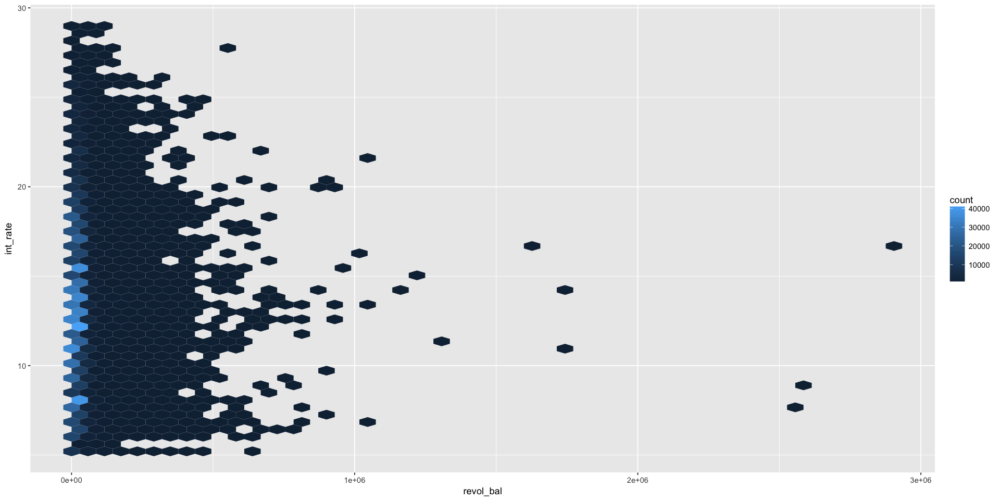

In [178]:
options(repr.plot.width=16, repr.plot.height=8)
ggplot(loan, aes(x=revol_bal, y=int_rate)) + geom_hex(bins=50)

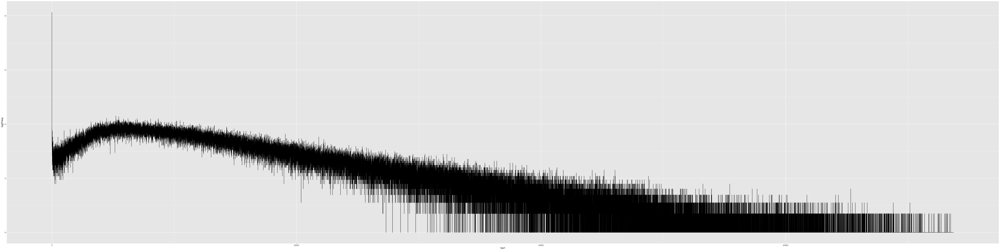

In [179]:
options(repr.plot.width=64, repr.plot.height=16)
revol_bal.data = as.data.frame(table(loan$revol_bal))
revol_bal.data = as.data.frame(sapply(revol_bal.data[, 1:2], as.numeric))
ggplot(revol_bal.data, aes(x=Var1, y=log(Freq))) + 
geom_line()

In [180]:
# log transformation
loan$gen_log_revol_bal = log(loan$revol_bal)

##### 39.revol_util with int_rate
revol_util : Revolving line utilization rate, or the amount of credit the borrower is using relative to all available revolving credit.


In [181]:
# missing percentage
sum(is.na(loan$revol_util))/dim(loan)[1]

[1] 0.0005657109

Warning message:
“Removed 502 rows containing non-finite values (stat_binhex).”

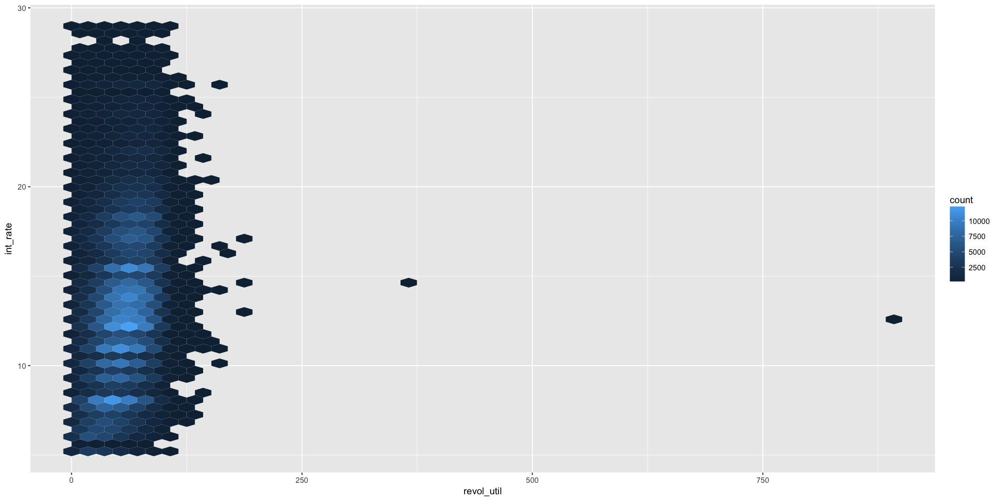

In [182]:
options(repr.plot.width=16, repr.plot.height=8)
ggplot(loan, aes(x=revol_util, y=int_rate)) + geom_hex(bins=50)

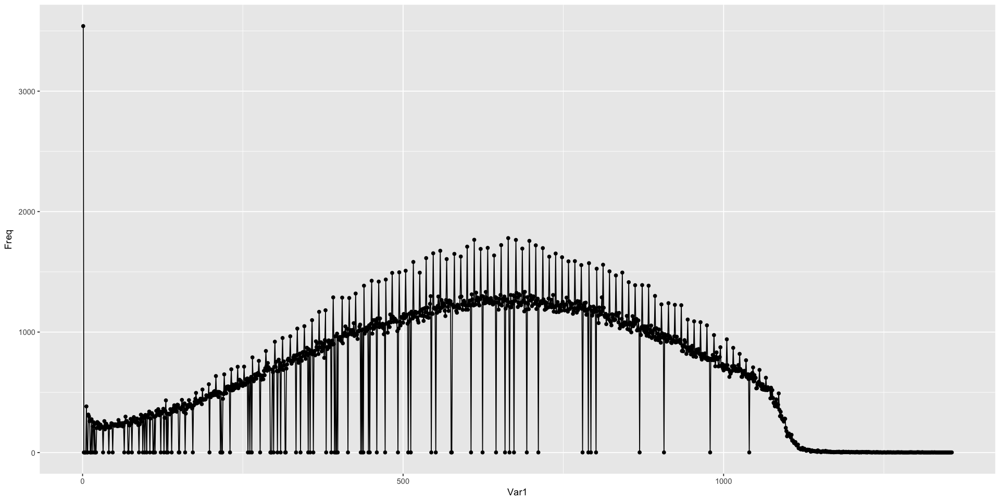

In [183]:
options(repr.plot.width=16, repr.plot.height=8)
revol_util.data = as.data.frame(table(loan$revol_util))
revol_util.data = as.data.frame(sapply(revol_util.data[, 1:2], as.numeric))
ggplot(revol_util.data, aes(x=Var1, y=Freq)) + 
geom_line() + geom_point()

##### 40.total_rev_hi_lim with int_rate
total_rev_hi_lim : Total revolving high credit/credit limit


In [184]:
# missing percentage
sum(is.na(loan$total_rev_hi_lim))/dim(loan)[1]

[1] 0.07919502

Warning message:
“Removed 70276 rows containing non-finite values (stat_binhex).”

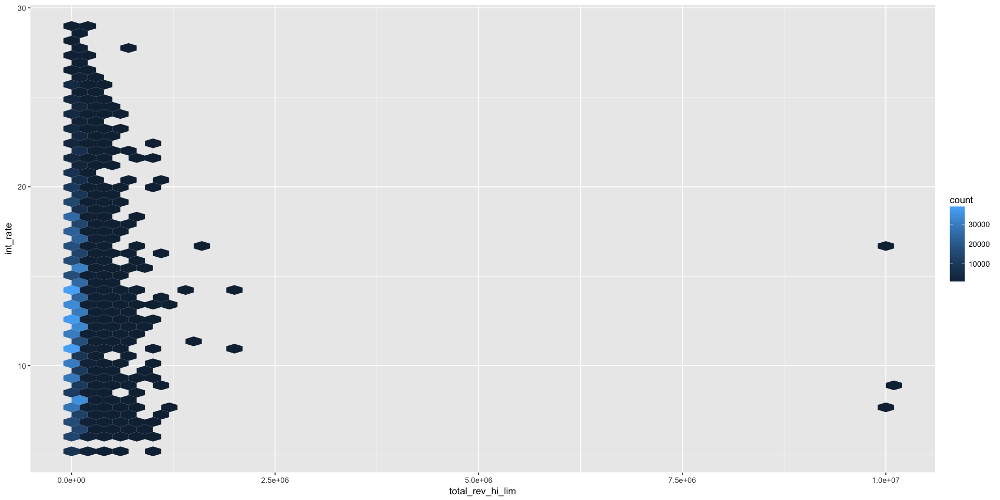

In [185]:
options(repr.plot.width=16, repr.plot.height=8)
ggplot(loan, aes(x= total_rev_hi_lim, y=int_rate)) + geom_hex(bins=50)

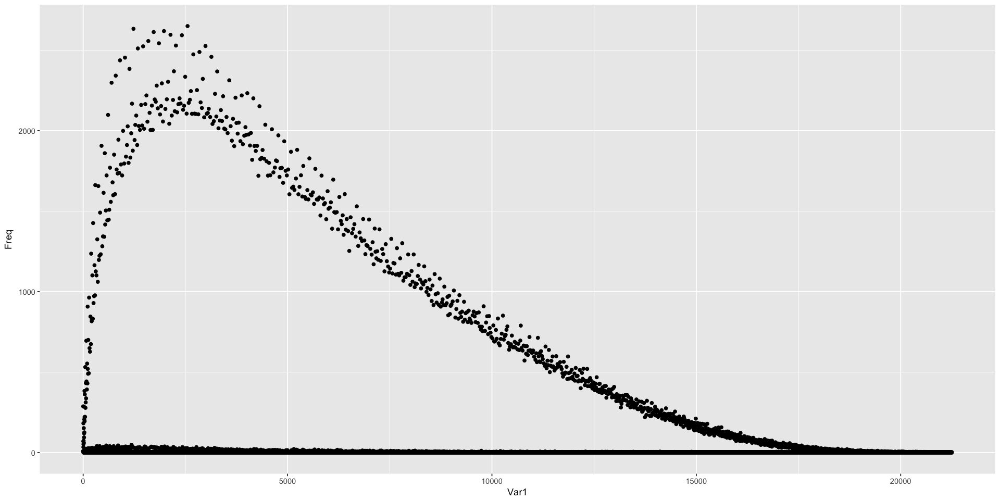

In [186]:
options(repr.plot.width=16, repr.plot.height=8)
total_rev_hi_lim.data = as.data.frame(table(loan$total_rev_hi_lim))
total_rev_hi_lim.data = as.data.frame(sapply(total_rev_hi_lim.data[, 1:2], as.numeric))
ggplot(total_rev_hi_lim.data, aes(x=Var1, y=Freq)) + 
geom_point()

In [187]:
# log transformation
loan$gen_log_total_rev_hi_lim = log(loan$total_rev_hi_lim)

##### 41.policy_code with int_rate
policy_code : publicly available policy_code=1

In [188]:
# missing percentage
sum(is.na(loan$policy_code))/dim(loan)[1]

[1] 0

In [189]:
# drop 
unique(loan$policy_code)

[1] 1

##### 42.url with int_rate
url : URL for the LC page with listing data.

In [190]:
# same as id, no use
loan$url[1:10]

[1] "https://www.lendingclub.com/browse/loanDetail.action?loan_id=1077501"
 [2] "https://www.lendingclub.com/browse/loanDetail.action?loan_id=1077430"
 [3] "https://www.lendingclub.com/browse/loanDetail.action?loan_id=1077175"
 [4] "https://www.lendingclub.com/browse/loanDetail.action?loan_id=1076863"
 [5] "https://www.lendingclub.com/browse/loanDetail.action?loan_id=1075358"
 [6] "https://www.lendingclub.com/browse/loanDetail.action?loan_id=1075269"
 [7] "https://www.lendingclub.com/browse/loanDetail.action?loan_id=1069639"
 [8] "https://www.lendingclub.com/browse/loanDetail.action?loan_id=1072053"
 [9] "https://www.lendingclub.com/browse/loanDetail.action?loan_id=1071795"
[10] "https://www.lendingclub.com/browse/loanDetail.action?loan_id=1071570"

##### 43.application_type with int_rate
application_type : Indicates whether the loan is an individual application or a joint application with two co-borrowers

In [191]:
# missing percentage
sum(is.na(loan$policy_code))/dim(loan)[1]

[1] 0

In [192]:
table(loan$application_type)


INDIVIDUAL      JOINT 
    886868        511 

In [193]:
511/dim(loan)[1]

[1] 0.0005758532

##### 44.desc with int_rate
desc : Loan description provided by the borrower

In [194]:
# need nlp
loan$desc[1:10]

[1] "  Borrower added on 12/22/11 > I need to upgrade my business technologies.<br>"                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                
 [2] "  Borrower added on 12/22/11 > I plan to use this money to finance the motorcycle i am looking at. I plan to have it paid off as soon as possible/when i sell my old bike. I only need this money because the deal im looking at is to good to pass up.<br><br>  Borrower added on 12/22/11 > I plan to use this money to finance the motorcycle i am looking at. I plan to have it paid off as soon as possible/when i sell my old bike.I only need this money because the deal im looking at is to good to pass up. I have finished college with an associates degree in business and its takingmeplaces<br>"
 [3] ""                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                              
 [4] "  Borrower added on 12/21/11 > to pay for property tax (borrow from friend, need to pay back) & central A/C need to be replace. I'm very sorry to let my loan expired last time.<br>"                                                                                                                                                                                                                                                                                                                                                                                                                          
 [5] "  Borrower added on 12/21/11 > I plan on combining three large interest bills together and freeing up some extra each month to pay toward other bills.  I've always been a good payor but have found myself needing to make adjustments to my budget due to a medical scare. My job is very stable, I love it.<br>"                                                                                                                                                                                                                                                                                            
 [6] ""                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                              
 [7] "  Borrower added on 12/18/11 > I am planning on using the funds to pay off two retail credit cards with 24.99% interest rates, as well as a major bank credit card with a 18.99% rate.  I pay all my bills on time, looking for a lower combined payment and lower monthly payment.<br>"                                                                                                                               

##### 45.id with int_rate
id : A unique LC assigned ID for the loan listing.

In [195]:
#unique,no use

##### 46.purpose with int_rate
purpose : A category provided by the borrower for the loan request.



In [196]:
# missing percentage
sum(is.na(loan$purpose))/dim(loan)[1]

[1] 0

In [197]:
table(loan$purpose)


               car        credit_card debt_consolidation        educational 
              8863             206182             524215                423 
  home_improvement              house     major_purchase            medical 
             51829               3707              17277               8540 
            moving              other   renewable_energy     small_business 
              5414              42894                575              10377 
          vacation            wedding 
              4736               2347 

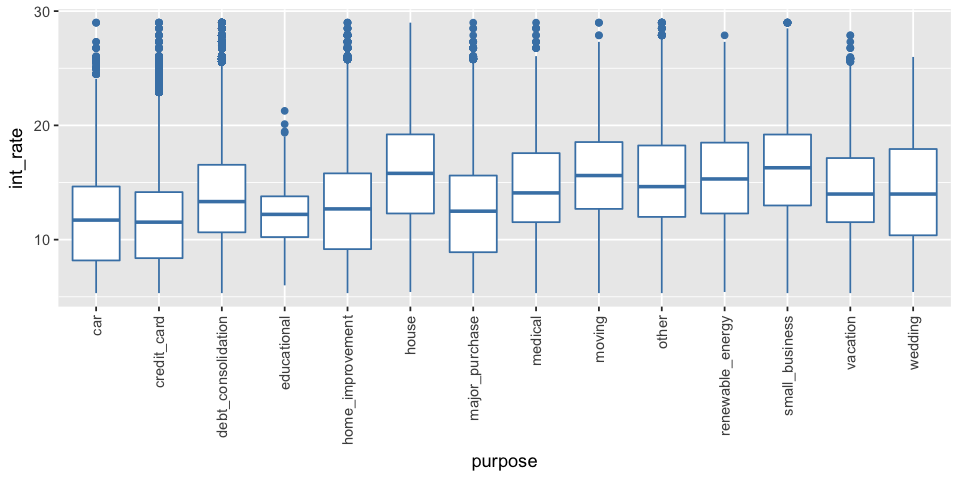

In [198]:
# boxplot
options(repr.plot.width=8, repr.plot.height=4)
ggplot(loan, aes(x=factor(purpose), y=int_rate)) + 
geom_boxplot(color='steelblue') + labs(x='purpose') + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

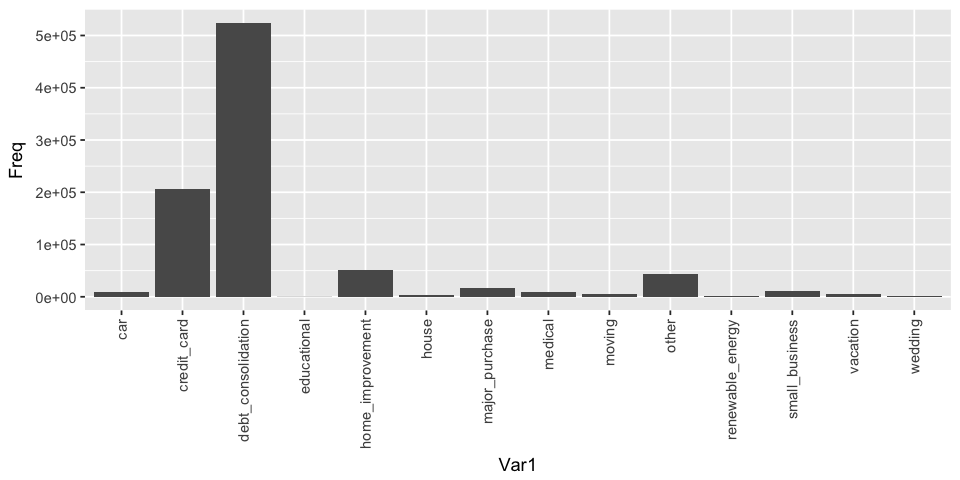

In [199]:
# barplot
options(repr.plot.width=8, repr.plot.height=4)
ggplot(as.data.frame(table(loan$purpose)), aes(x=Var1, y=Freq)) + 
geom_bar(stat="identity") + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

##### 46.title with int_rate
title : The loan title provided by the borrower

In [200]:
# missing percentage
sum(is.na(loan$title))

[1] 0

In [201]:
# display top ten emp_title
loan$title = tolower(loan$title)            # convert all string to lowercase
sort(table(loan$title), decreasing = T)[1:50]   # possible text processing, na exists as a level

ERROR: Error in tolower(loan$title): invalid multibyte string 17935


In [ ]:
loan$title[17935]

In [202]:
loan$title = tolower(stri_unescape_unicode(loan$title))
sort(table(loan$title), decreasing = T)[1:100]


            debt consolidation        credit card refinancing 
                        435239                         164717 
              home improvement                          other 
                         42663                          31978 
                major purchase                  consolidation 
                         12346                           7740 
                      business               medical expenses 
                          6823                           6782 
                 car financing        debt consolidation loan 
                          5591                           4683 
                      vacation          moving and relocation 
                          3993                           3929 
     credit card consolidation                  personal loan 
                          3509                           3313 
            consolidation loan             credit card payoff 
                          2597                        

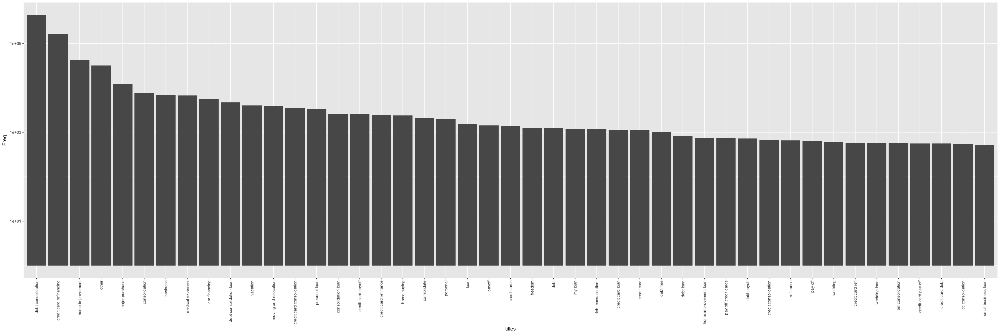

In [203]:
# bar plot 
title.pop = sort(table(loan$title)[which(table(loan$title)>500)], decreasing = T)
title.pop = as.data.frame(title.pop)

options(repr.plot.width=30, repr.plot.height=10)
ggplot(data = title.pop, aes(x=Var1, y=Freq)) + 
  geom_bar(stat="identity") + 
   scale_y_log10() + 
    scale_x_discrete(name ="titles", 
                     limits=title.pop$Var1)+
  theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

In [204]:
# group it to decrease the number of levels


##### 47.term with int_rate
term : The number of payments on the loan. Values are in months and can be either 36 or 60.



In [205]:
# missing percentage
sum(is.na(loan$term))/dim(loan)[1]

[1] 0

In [206]:
t.test(int_rate ~ term, data = loan, na.action = na.omit) # significant


	Welch Two Sample t-test

data:  int_rate by term
t = -431.12, df = 467040, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 -4.111525 -4.074310
sample estimates:
mean in group  36 months mean in group  60 months 
                12.01868                 16.11160 


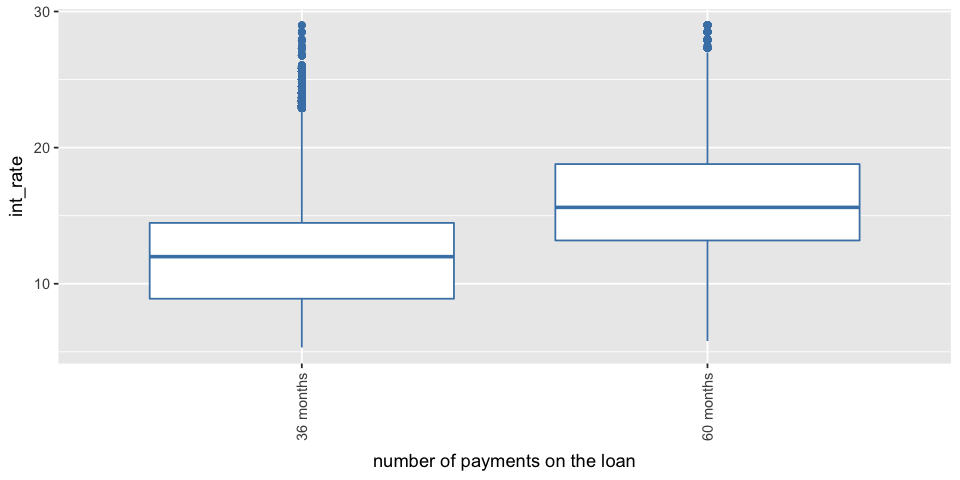

In [207]:
# boxplot
options(repr.plot.width=8, repr.plot.height=4)
ggplot(loan, aes(x=factor(term), y=int_rate)) + 
geom_boxplot(color='steelblue') + labs(x='number of payments on the loan') + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

##### 48.issue_d with int_rate
issue_d : The month which the loan was funded

In [208]:
# missing percentage
sum(is.na(loan$issue_d))/dim(loan)[1]

[1] 0

In [209]:
library(zoo)
loan$issue_d_date = as.Date(as.yearmon(loan$issue_d, "%b-%Y"))

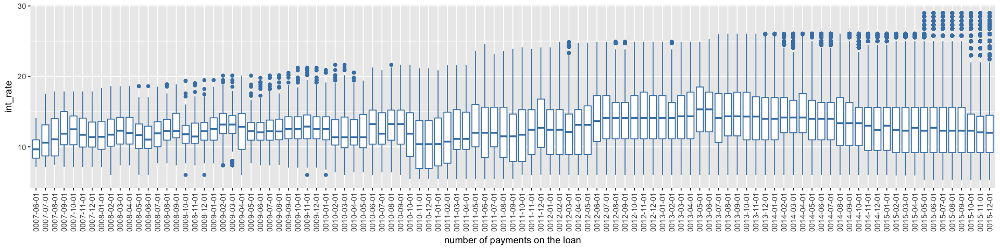

In [210]:
# boxplot
options(repr.plot.width=16, repr.plot.height=4)
ggplot(loan, aes(x=factor(issue_d_date), y=int_rate)) + 
geom_boxplot(color='steelblue') + labs(x='number of payments on the loan') + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

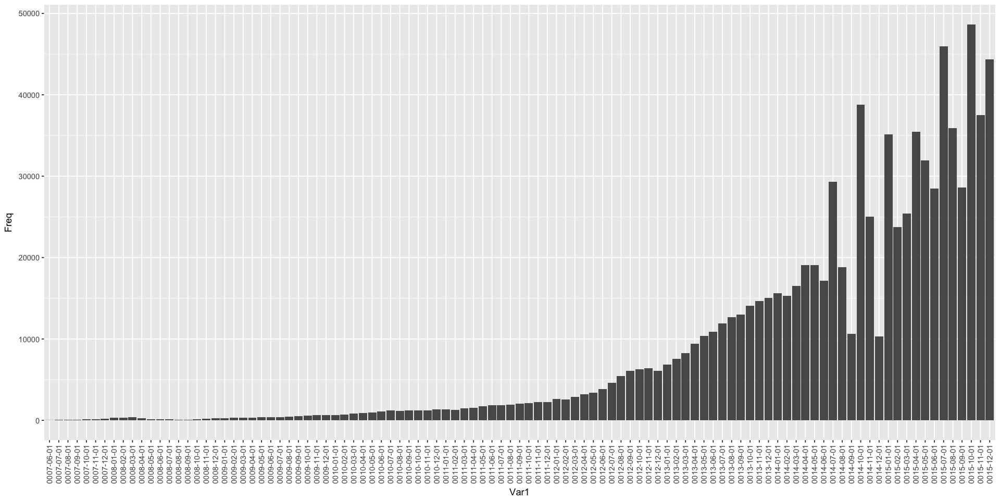

In [211]:
# barplot
options(repr.plot.width=16, repr.plot.height=8)
ggplot(as.data.frame(table(loan$issue_d_date)), aes(x=Var1, y=Freq)) + 
geom_bar(stat="identity") + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

In [212]:
# generate feature issue_d, issue_year, issue_mon
loan$gen_issue_d <- as.Date(as.yearmon(loan$issue_d, "%b-%Y"))
loan$gen_issue_year <- as.character(format(loan$gen_issue_d, "%Y"))
loan$gen_issue_mon <- as.character(format(loan$gen_issue_d, "%m"))

##### 49.initial_list_status with int_rate
initial_list_status : The initial listing status of the loan. Possible values are – W, F

In [213]:
# missing percentage
sum(is.na(loan$initial_list_status))/dim(loan)[1]

[1] 0

In [214]:
t.test(int_rate ~ initial_list_status, data = loan, na.action = na.omit) # significant


	Welch Two Sample t-test

data:  int_rate by initial_list_status
t = 109.03, df = 885520, p-value < 2.2e-16
alternative hypothesis: true difference in means is not equal to 0
95 percent confidence interval:
 0.9895826 1.0258105
sample estimates:
mean in group f mean in group w 
       13.73565        12.72795 


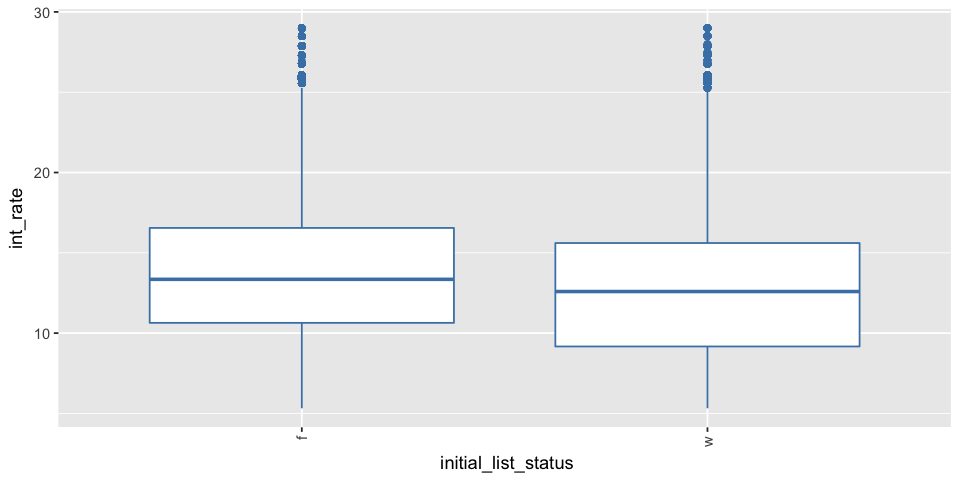

In [215]:
# boxplot
options(repr.plot.width=8, repr.plot.height=4)
ggplot(loan, aes(x=factor(initial_list_status), y=int_rate)) + 
geom_boxplot(color='steelblue') + labs(x=' initial_list_status') + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

##### 50.loan_amnt with int_rate
loan_amnt : The listed amount of the loan applied for by the borrower. If at some point in time, the credit department reduces the loan amount, then it will be reflected in this value.



In [216]:
# missing percentage
sum(is.na(loan$loan_amnt))/dim(loan)[1]

[1] 0

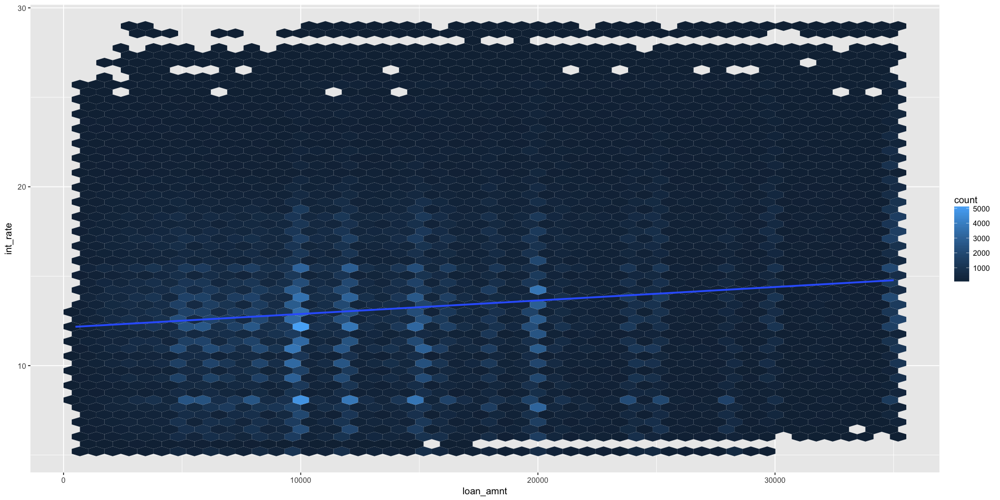

In [217]:
options(repr.plot.width=16, repr.plot.height=8)
ggplot(loan, aes(x= loan_amnt, y=int_rate)) + geom_hex(bins=50) + stat_smooth(method=lm)

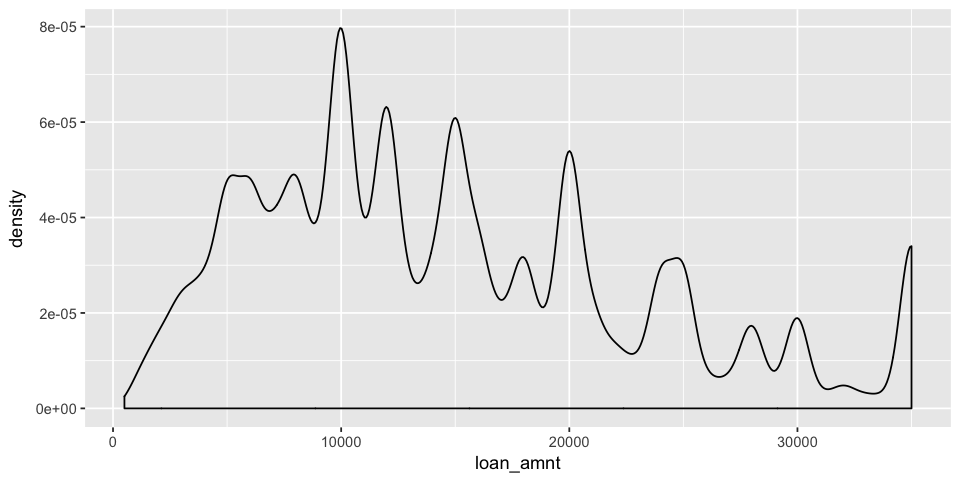

In [218]:
options(repr.plot.width=8, repr.plot.height=4)
ggplot(loan, aes(x=loan_amnt, y= ..density..)) + 
geom_density()

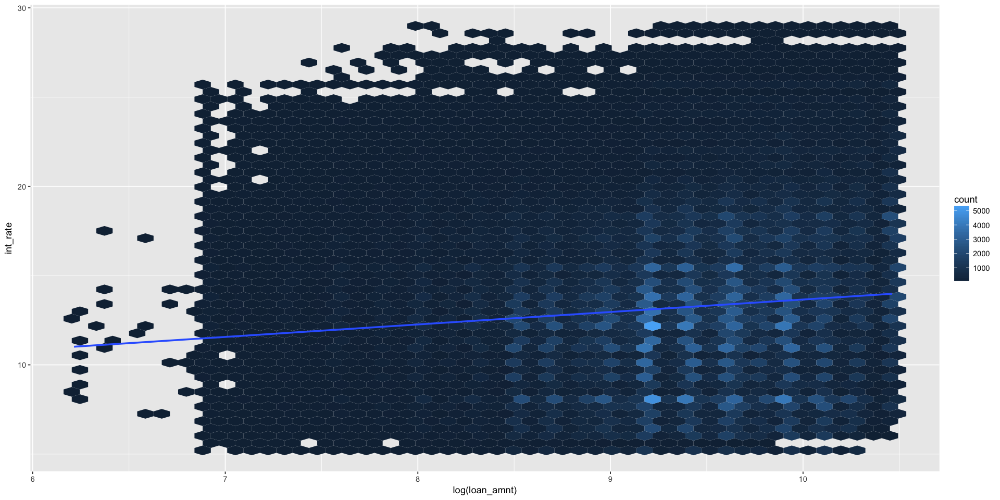

In [219]:
options(repr.plot.width=16, repr.plot.height=8)
ggplot(loan, aes(x= log(loan_amnt), y=int_rate)) + geom_hex(bins=50) + stat_smooth(method=lm)

In [220]:
loan$gen_log_loan_amnt = log(loan$loan_amnt)

##### 51.installment with int_rate
installment : The monthly payment owed by the borrower if the loan originates.

In [221]:
# missing percentage
sum(is.na(loan$installment))/dim(loan)[1]

[1] 0

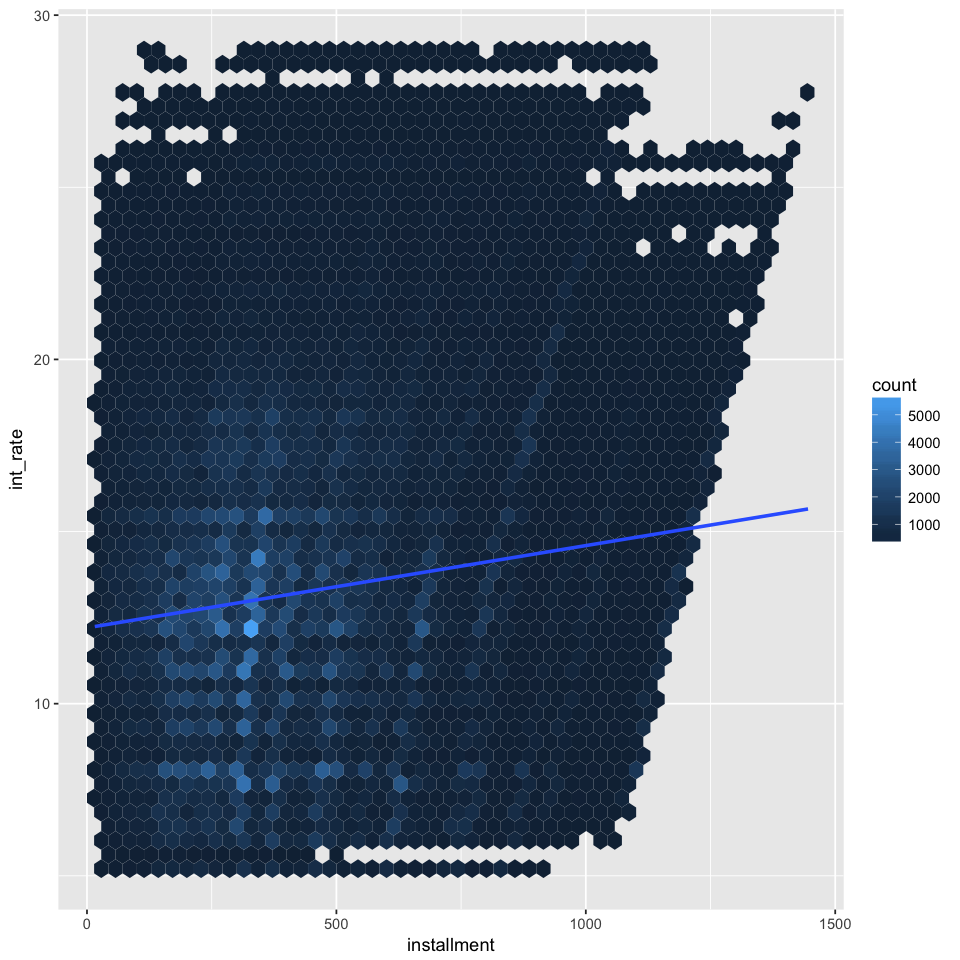

In [222]:
options(repr.plot.width=8, repr.plot.height=8)
ggplot(loan, aes(x= installment, y=int_rate)) + geom_hex(bins=50) + stat_smooth(method=lm)

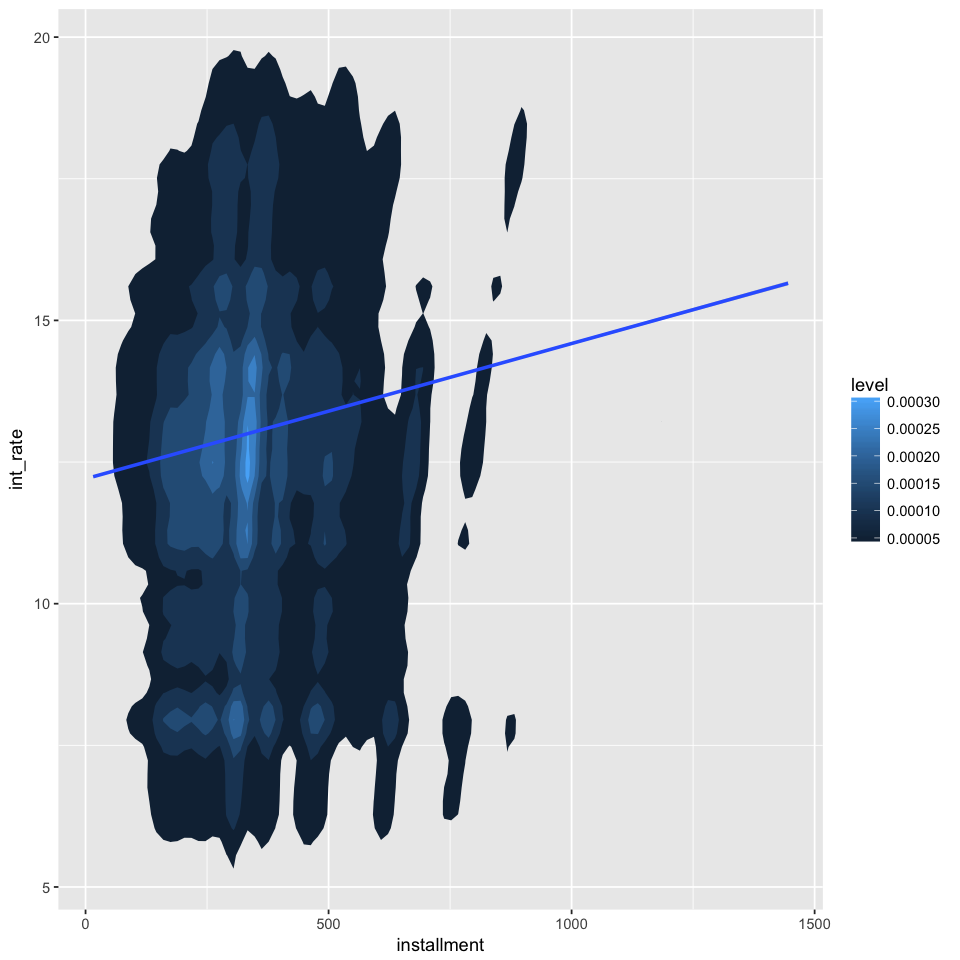

In [223]:
ggplot(loan, aes(x= installment, y=int_rate)) + 
stat_density_2d(aes(fill = ..level..), geom = "polygon") + 
stat_smooth(method=lm)

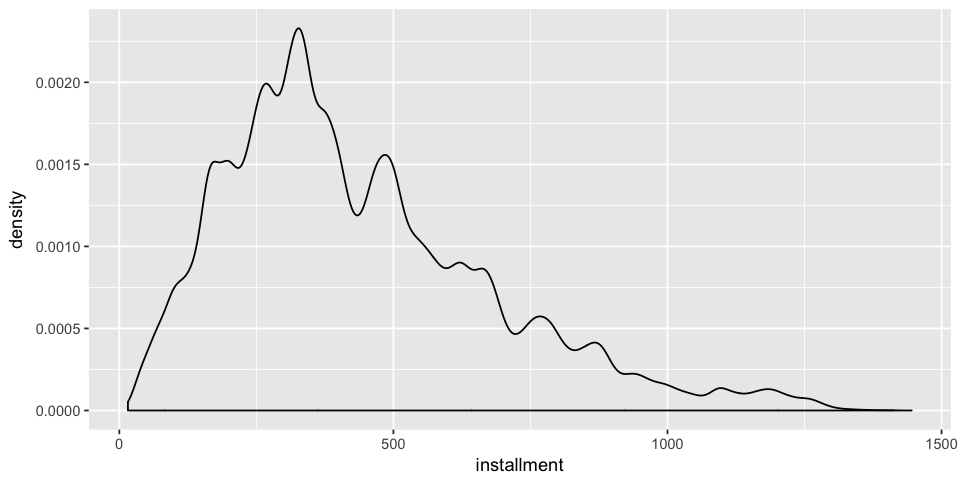

In [224]:
options(repr.plot.width=8, repr.plot.height=4)
ggplot(loan, aes(x=installment, y= ..density..)) + 
geom_density()

In [225]:
# log transormation
loan$gen_log_installment = log(loan$installment)

##### 52.funded_amnt with int_rate
funded_amnt : The total amount committed to that loan at that point in time.


In [226]:
# missing percentage
sum(is.na(loan$funded_amnt))/dim(loan)[1]

[1] 0

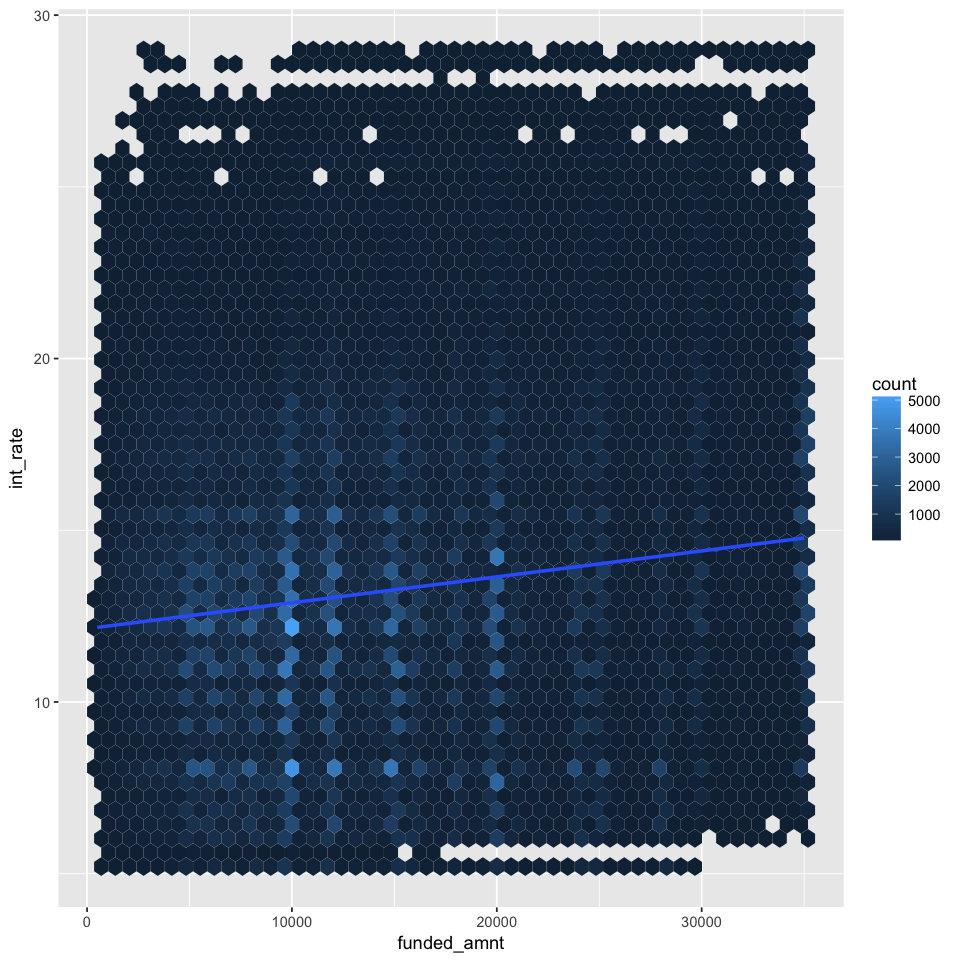

In [227]:
options(repr.plot.width=8, repr.plot.height=8)
ggplot(loan, aes(x= funded_amnt, y=int_rate)) + geom_hex(bins=50) + stat_smooth(method=lm)

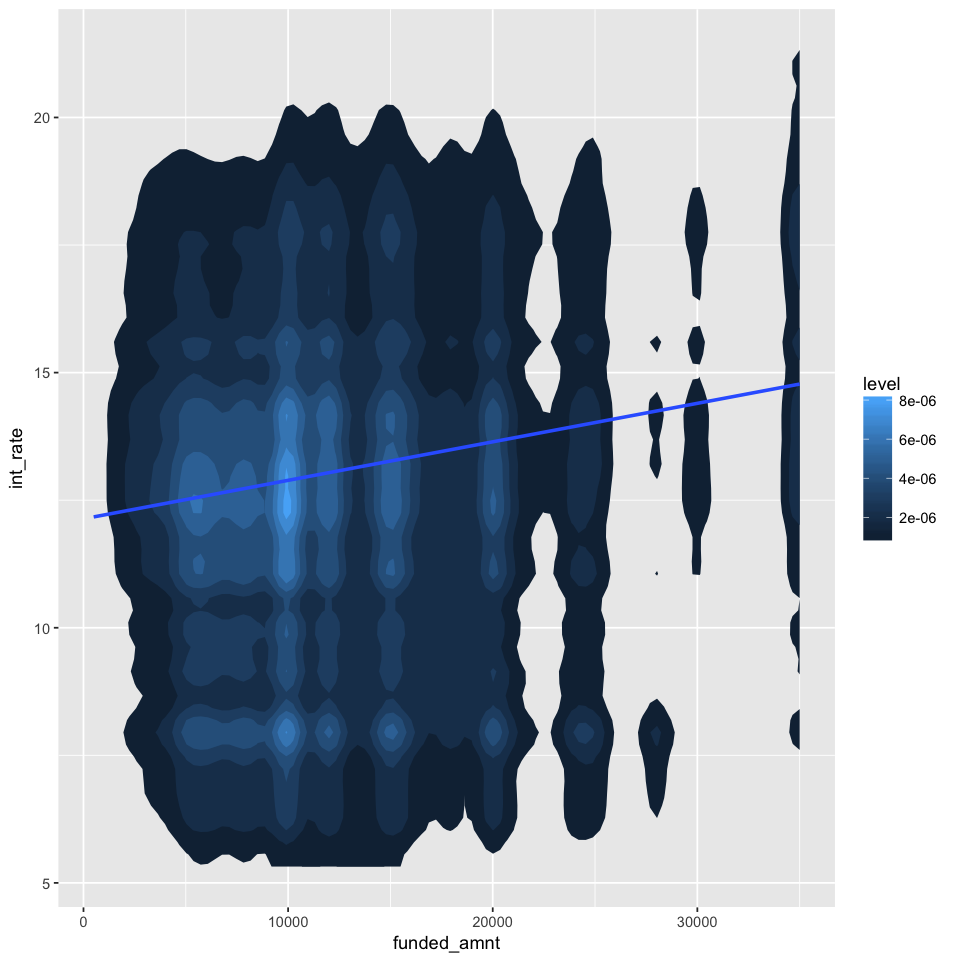

In [228]:
ggplot(loan, aes(x= funded_amnt, y=int_rate)) + 
stat_density_2d(aes(fill = ..level..), geom = "polygon") + 
stat_smooth(method=lm)

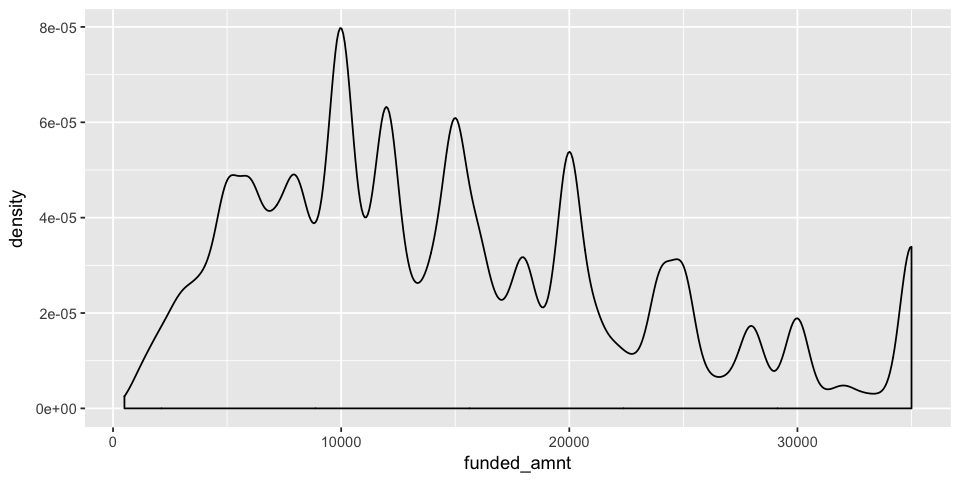

In [229]:
options(repr.plot.width=8, repr.plot.height=4)
ggplot(loan, aes(x=funded_amnt, y= ..density..)) + 
geom_density()

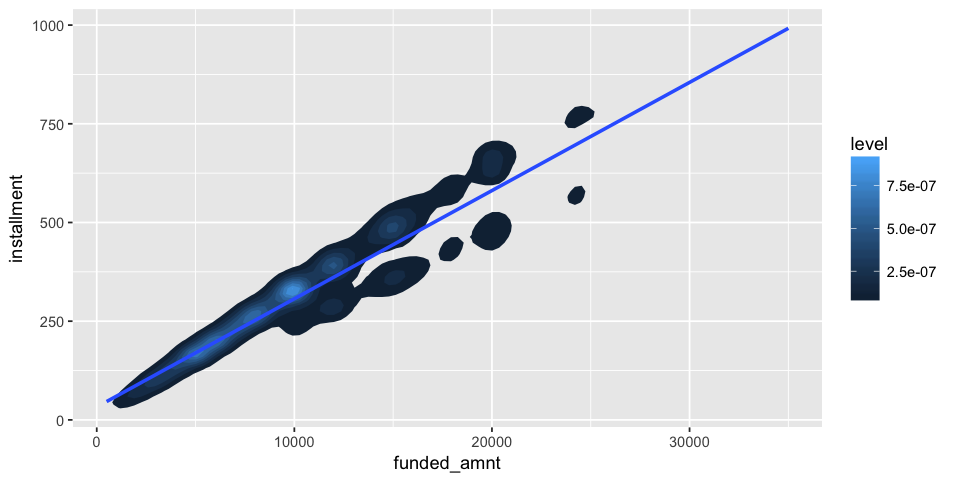

In [230]:
ggplot(loan, aes(x= funded_amnt, y=installment)) + 
stat_density_2d(aes(fill = ..level..), geom = "polygon") + 
stat_smooth(method=lm)

In [231]:
loan$gen_log_funded_amnt = log(loan$funded_amnt)

In [232]:
# only keep one is enough
cor(loan$funded_amnt, loan$installment)

[1] 0.9460049

##### 53.funded_amnt_inv with int_rate
funded_amnt_inv : The total amount committed by investors for that loan at that point in time.

In [233]:
# missing percentage
sum(is.na(loan$funded_amnt_inv))/dim(loan)[1]

[1] 0

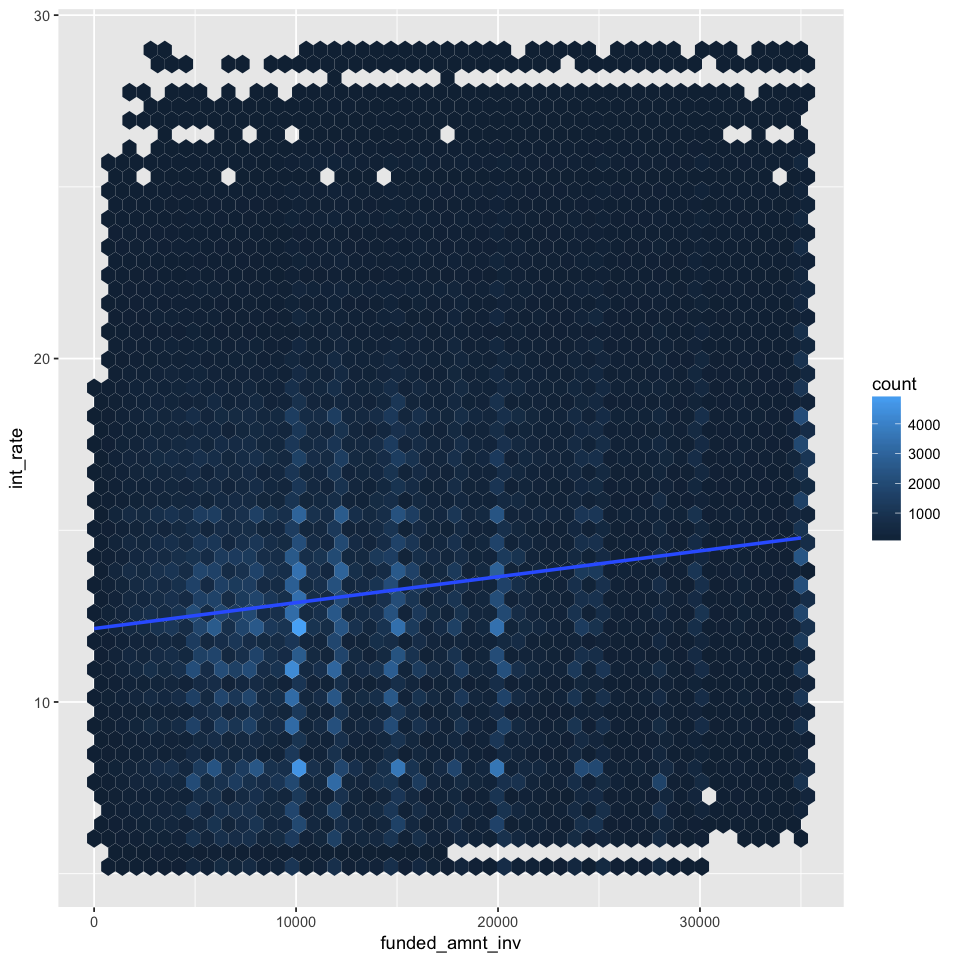

In [234]:
options(repr.plot.width=8, repr.plot.height=8)
ggplot(loan, aes(x= funded_amnt_inv, y=int_rate)) + geom_hex(bins=50) + stat_smooth(method=lm)

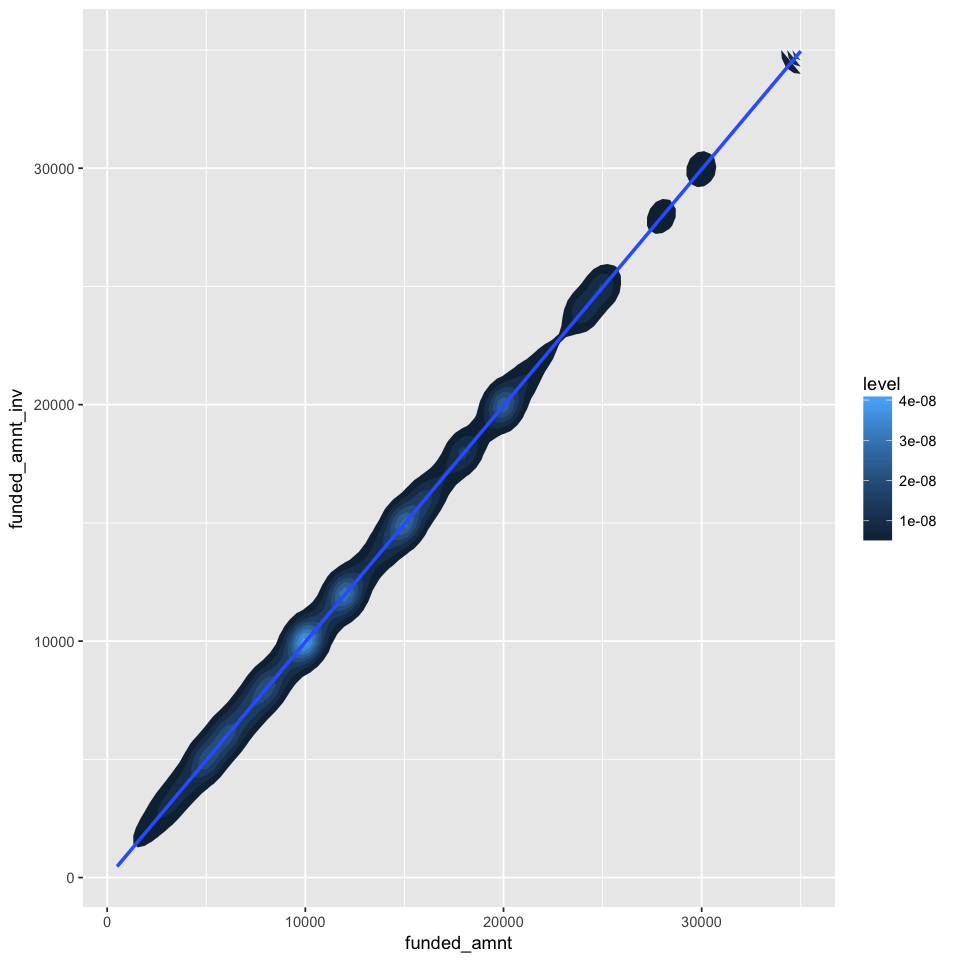

In [235]:
ggplot(loan, aes(x= funded_amnt, y=funded_amnt_inv)) + 
stat_density_2d(aes(fill = ..level..), geom = "polygon") + 
stat_smooth(method=lm)

In [236]:
loan$gen_log_funded_amnt_inv = log(loan$funded_amnt_inv)

In [237]:
# only keep one is enough
cor(loan$funded_amnt, loan$funded_amnt_inv)

[1] 0.9980251

##### 54.last_pymnt_amnt with int_rate
last_pymnt_amnt : Last total payment amount received.


In [238]:
# missing percentage
sum(is.na(loan$last_pymnt_amnt))/dim(loan)[1]

[1] 0

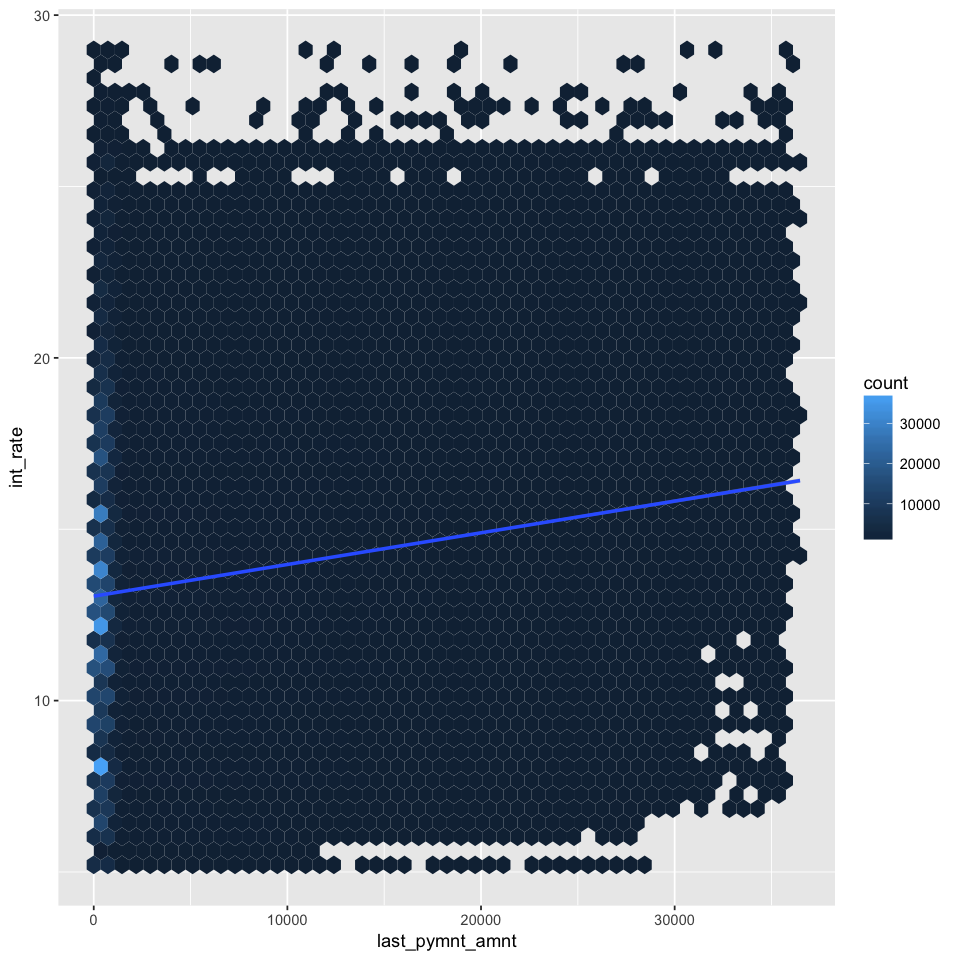

In [239]:
options(repr.plot.width=8, repr.plot.height=8)
ggplot(loan, aes(x= last_pymnt_amnt, y=int_rate)) + geom_hex(bins=50) + stat_smooth(method=lm)

geom_smooth: na.rm = FALSE
stat_smooth: method = function (formula, data, subset, weights, na.action, method = "qr", model = TRUE, x = FALSE, y = FALSE, qr = TRUE, singular.ok = TRUE, contrasts = NULL, offset, ...) 
{
    ret.x <- x
    ret.y <- y
    cl <- match.call()
    mf <- match.call(expand.dots = FALSE)
    m <- match(c("formula", "data", "subset", "weights", "na.action", "offset"), names(mf), 0)
    mf <- mf[c(1, m)]
    mf$drop.unused.levels <- TRUE
    mf[[1]] <- quote(stats::model.frame)
    mf <- eval(mf, parent.frame())
    if (method == "model.frame") 
        return(mf)
    else if (method != "qr") 
        warning(gettextf("method = '%s' is not supported. Using 'qr'", method), domain = NA)
    mt <- attr(mf, "terms")
    y <- model.response(mf, "numeric")
    w <- as.vector(model.weights(mf))
    if (!is.null(w) && !is.numeric(w)) 
        stop("'weights' must be a numeric vector")
    offset <- as.vector(model.offset(mf))
    if (!is.null(offset)) {
        if (length

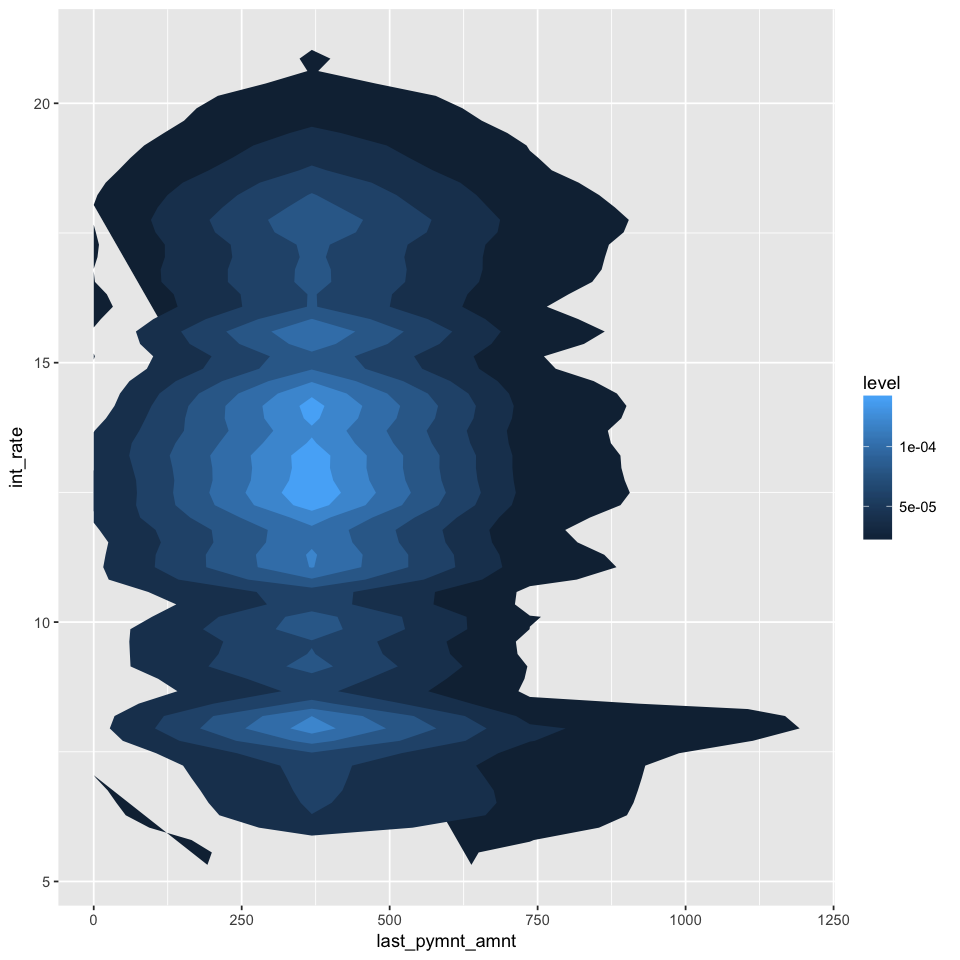

In [240]:
ggplot(loan, aes(x= last_pymnt_amnt, y=int_rate)) + 
stat_density_2d(aes(fill = ..level..), geom = "polygon") 
stat_smooth(method=lm)

In [241]:
# this feature is not very related with int_rate

##### 55.last_pymnt_d with int_rate
last_pymnt_d : Last month payment was received

In [242]:
#  transform to date
loan$last_pymnt_d_date = as.Date(as.yearmon(loan$last_pymnt_d, "%b-%Y"))

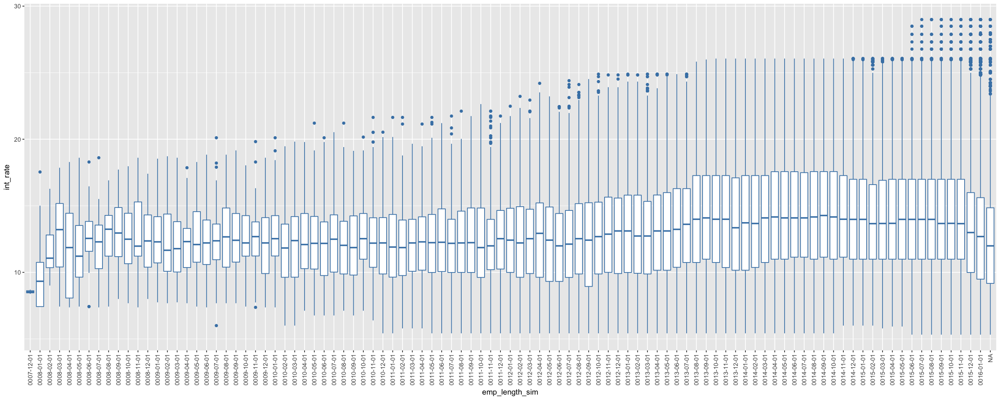

In [243]:
options(repr.plot.width=20, repr.plot.height=8)
ggplot(loan, aes(x=factor(last_pymnt_d_date), y=int_rate)) + 
geom_boxplot(color='steelblue') + labs(x='emp_length_sim') + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

##### 56.next_pymnt_d with int_rate
next_pymnt_d : Next scheduled payment date

In [244]:
loan$next_pymnt_d_date = as.Date(as.yearmon(loan$next_pymnt_d, "%b-%Y"))

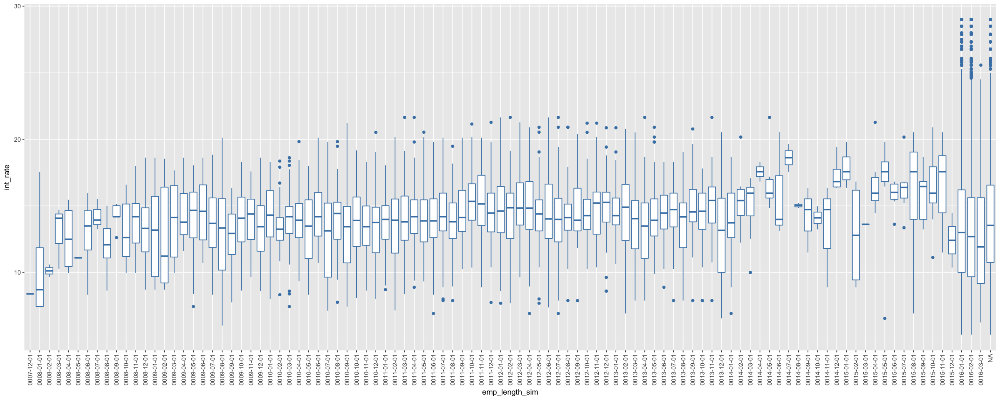

In [245]:
# boxplot
options(repr.plot.width=20, repr.plot.height=8)
ggplot(loan, aes(x=factor(next_pymnt_d_date), y=int_rate)) + 
geom_boxplot(color='steelblue') + labs(x='emp_length_sim') + 
theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none")

In [246]:
# possible feature engineering: day to next payment

##### 57.pymnt_plan with int_rate
pymnt_plan : Indicates if a payment plan has been put in place for the loan

In [247]:
# basic no use
table(loan$pymnt_plan)


     n      y 
887369     10 

##### 58.recoveries with int_rate
recoveries : post charge off gross recovery


In [248]:
sum(is.na(loan$recoveries))/dim(loan)[1]

[1] 0

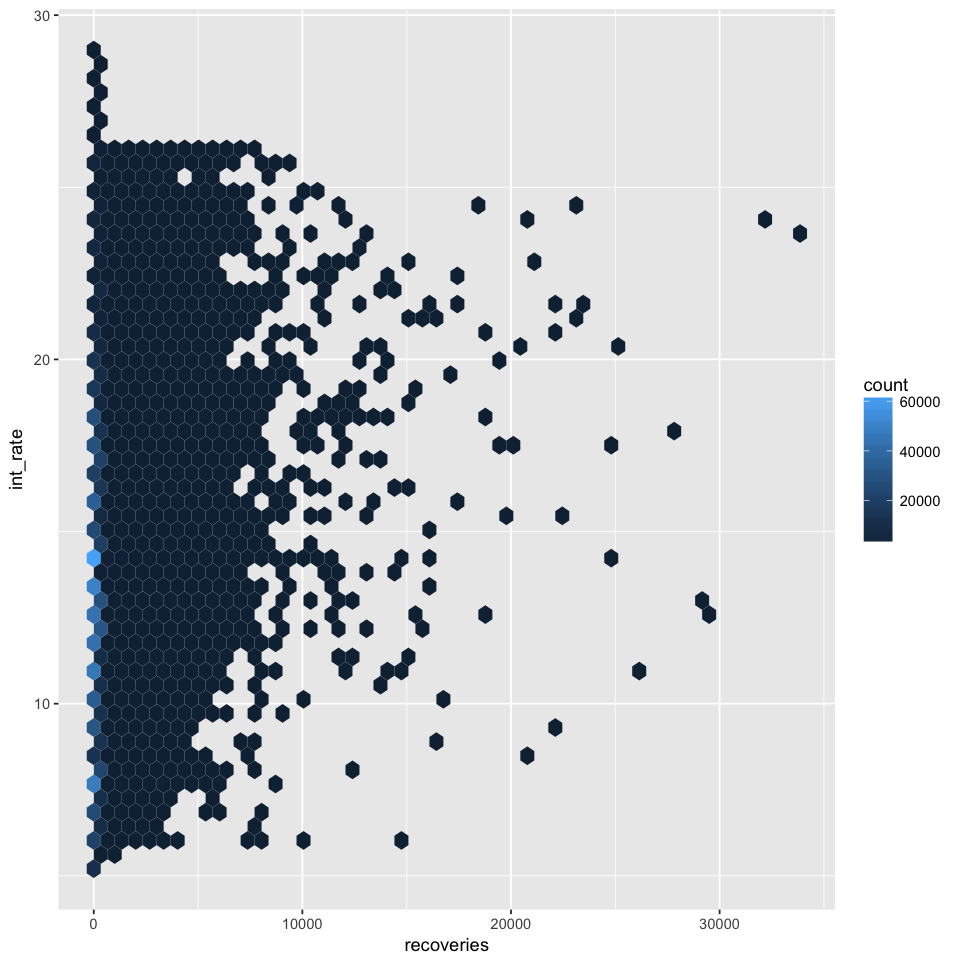

In [249]:
options(repr.plot.width=8, repr.plot.height=8)
ggplot(loan, aes(x=recoveries, y=int_rate)) + geom_hex(bins=50) #+ stat_smooth(method=lm)

##### 59.total_pymnt with int_rate
total_pymnt : Payments received to date for total amount funded

In [250]:
sum(is.na(loan$total_pymnt))/dim(loan)[1]

[1] 0

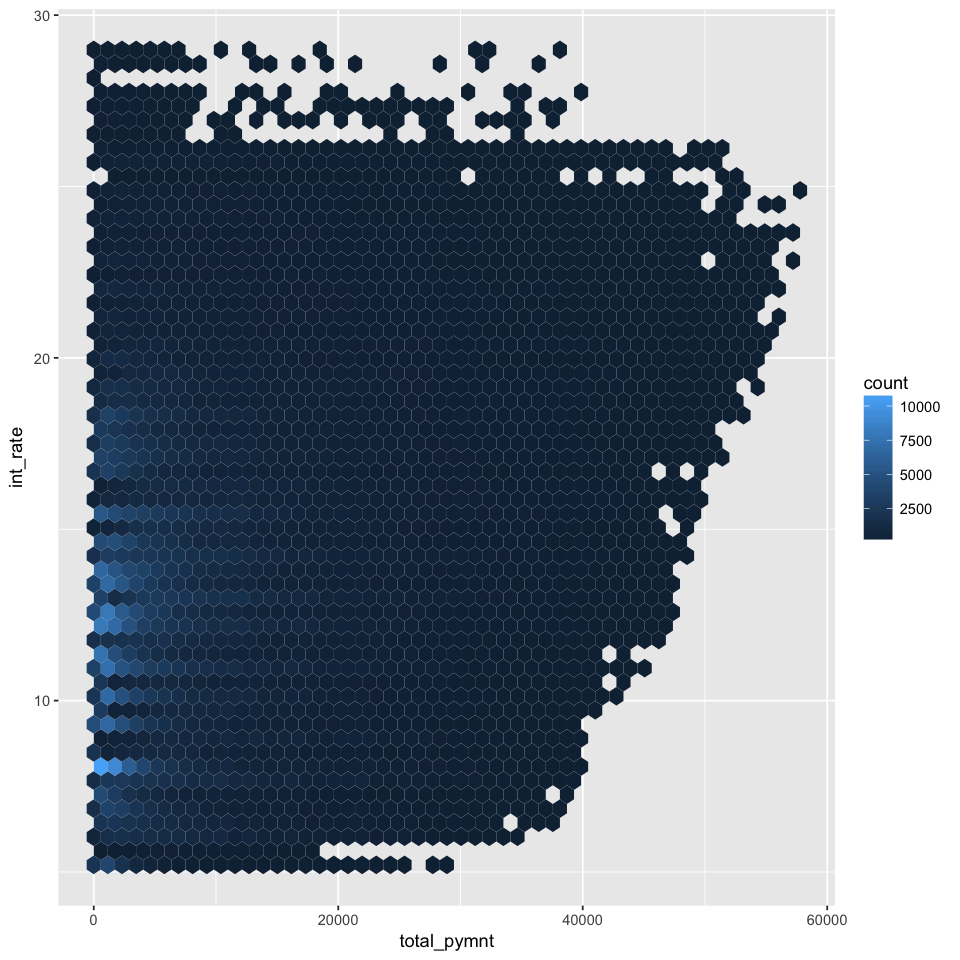

In [251]:
options(repr.plot.width=8, repr.plot.height=8)
ggplot(loan, aes(x=total_pymnt, y=int_rate)) + geom_hex(bins=50) #+ stat_smooth(method=lm)

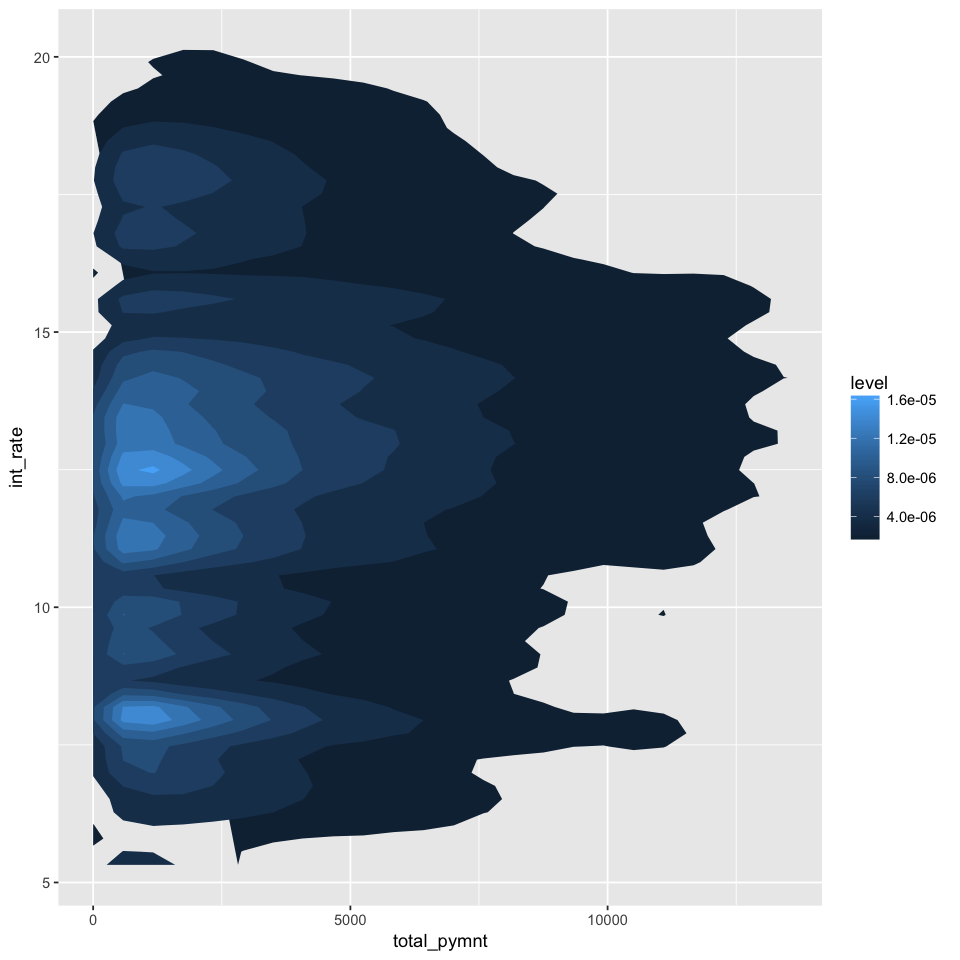

In [252]:
ggplot(loan, aes(x= total_pymnt, y=int_rate)) + 
stat_density_2d(aes(fill = ..level..), geom = "polygon") 

##### 60.total_pymnt_invwith int_rate
total_pymnt_inv : Payments received to date for portion of total amount funded by investors

In [253]:
sum(is.na(loan$total_pymnt_inv))/dim(loan)[1]

[1] 0

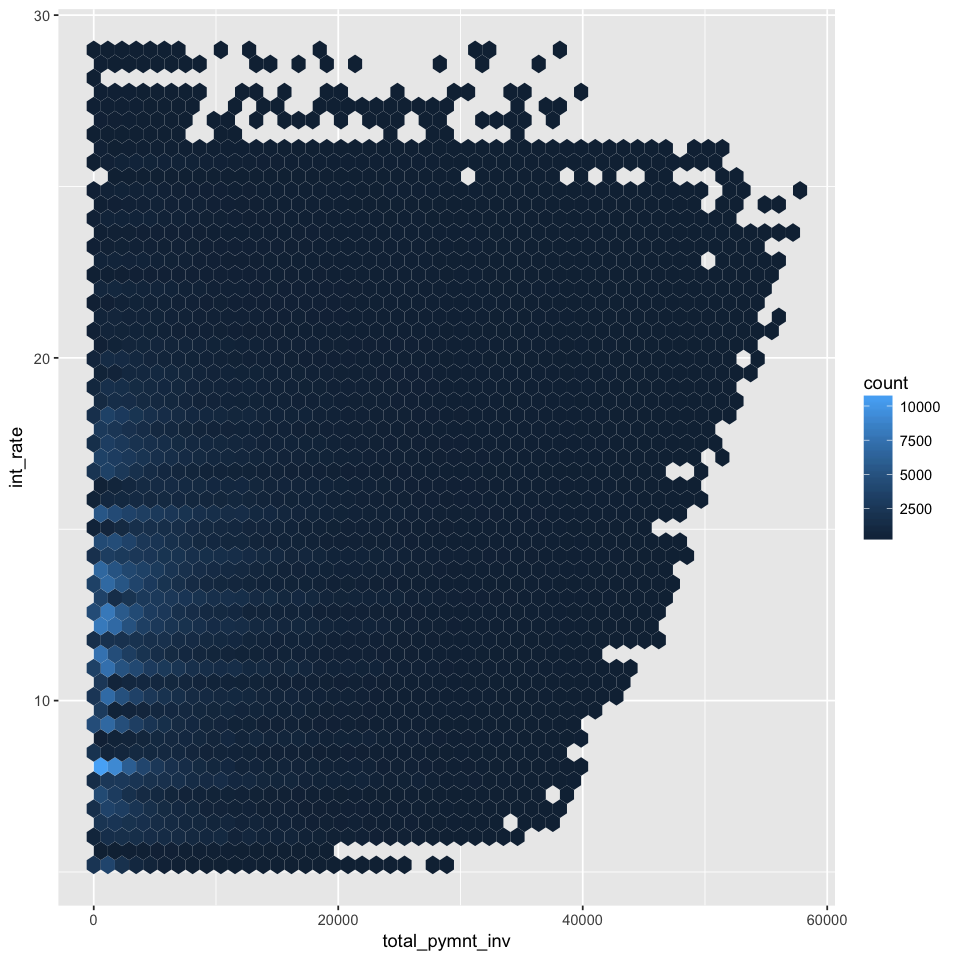

In [254]:
options(repr.plot.width=8, repr.plot.height=8)
ggplot(loan, aes(x=total_pymnt_inv, y=int_rate)) + geom_hex(bins=50) #+ stat_smooth(method=lm)

In [255]:
# only keep one is enough
cor(loan$total_pymnt, loan$total_pymnt_inv)

[1] 0.9975923

##### 61.total_rec_int with int_rate
total_rec_int : Interest received to date


In [256]:
sum(is.na(loan$total_rec_int))/dim(loan)[1]

[1] 0

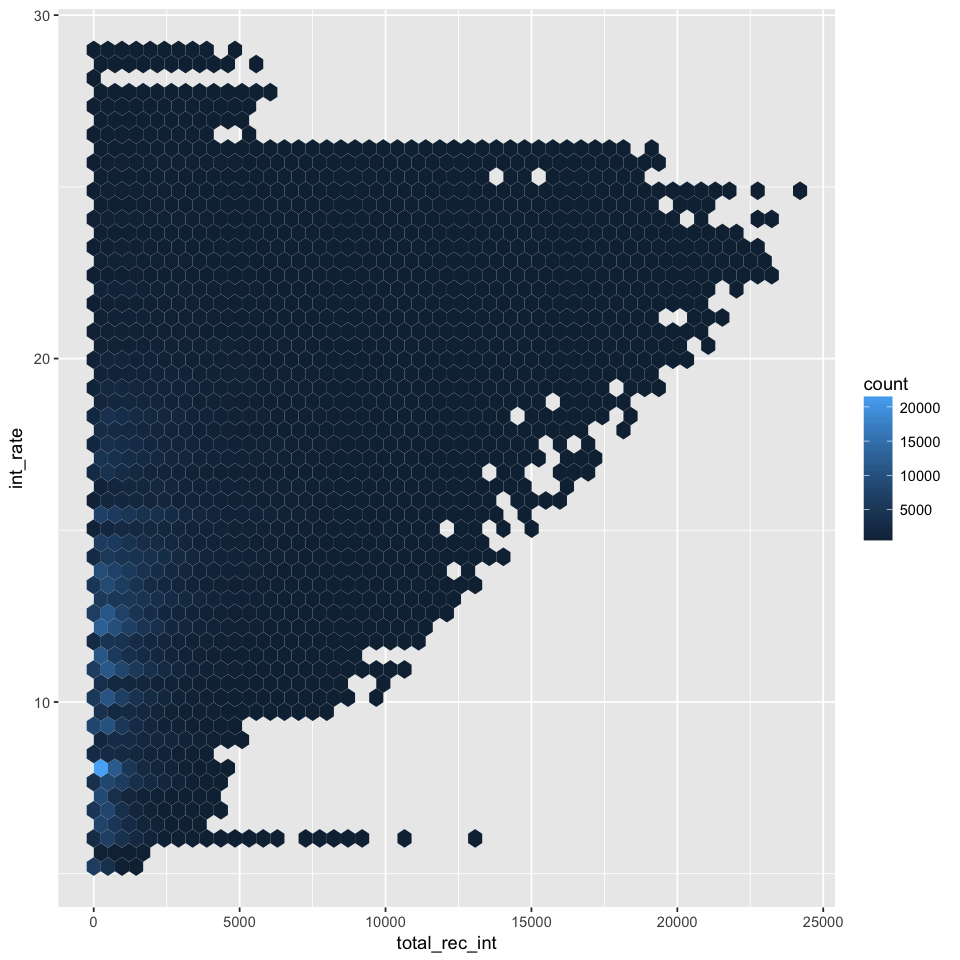

In [257]:
options(repr.plot.width=8, repr.plot.height=8)
ggplot(loan, aes(x=total_rec_int, y=int_rate)) + geom_hex(bins=50) #+ stat_smooth(method=lm)

In [258]:
cor(loan$total_rec_int, loan$int_rate)

[1] 0.4456788

##### 62.total_rec_int with int_rate
total_rec_late_fee : Late fees received to date


In [259]:
sum(is.na(loan$total_rec_late_fee))/dim(loan)[1]

[1] 0

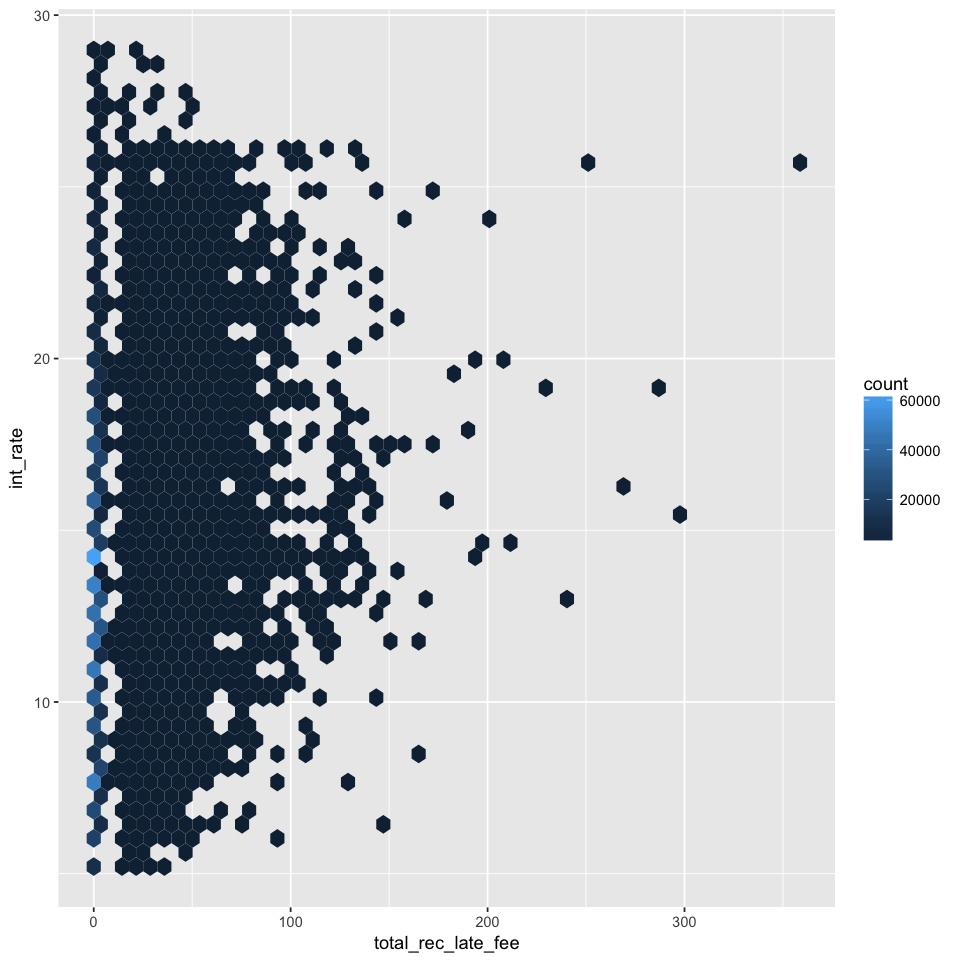

In [260]:
options(repr.plot.width=8, repr.plot.height=8)
ggplot(loan, aes(x=total_rec_late_fee, y=int_rate)) + geom_hex(bins=50) #+ stat_smooth(method=lm)

In [261]:
cor(loan$total_rec_late_fee, loan$int_rate)

[1] 0.05715012

##### 63.total_rec_prnc with int_rate
total_rec_prncp : Principal received to date

In [262]:
sum(is.na(loan$total_rec_prncp))/dim(loan)[1]

[1] 0

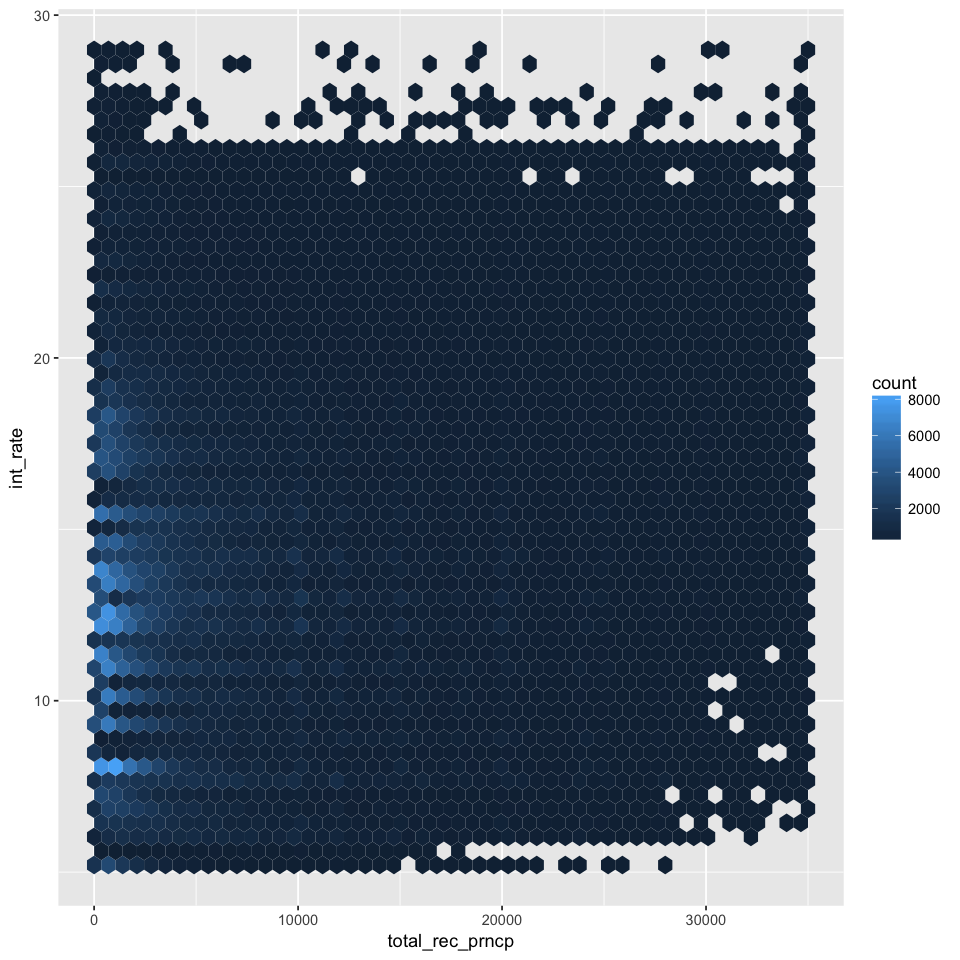

In [263]:
options(repr.plot.width=8, repr.plot.height=8)
ggplot(loan, aes(x=total_rec_prncp, y=int_rate)) + geom_hex(bins=50) #+ stat_smooth(method=lm)

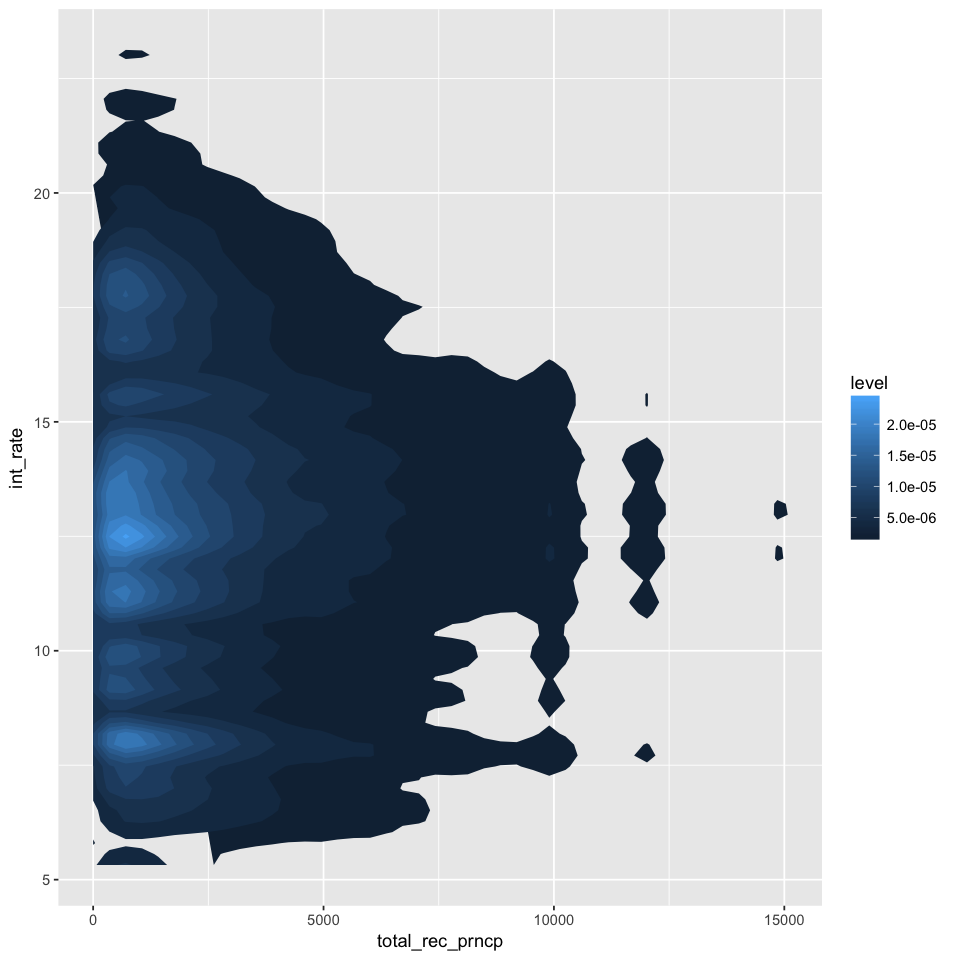

In [264]:
ggplot(loan, aes(x= total_rec_prncp, y=int_rate)) + 
stat_density_2d(aes(fill = ..level..), geom = "polygon") 

##### 64.collection_recovery_fee with int_rate
collection_recovery_fee : post charge off collection fee

In [265]:
sum(is.na(loan$collection_recovery_fee))/dim(loan)[1]

[1] 0

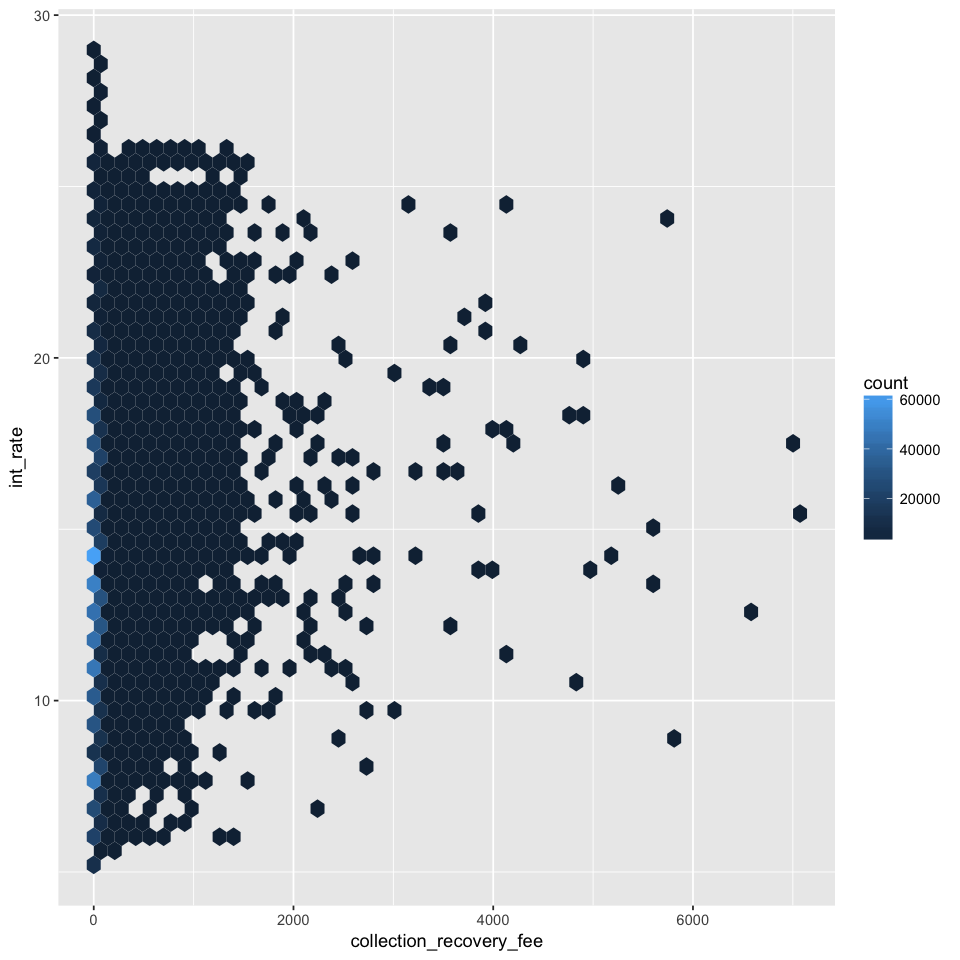

In [266]:
options(repr.plot.width=8, repr.plot.height=8)
ggplot(loan, aes(x=collection_recovery_fee, y=int_rate)) + geom_hex(bins=50) #+ stat_smooth(method=lm)

##### 65.out_prncp with int_rate
out_prncp : Remaining outstanding principal for total amount funded

In [267]:
sum(is.na(loan$out_prncp))/dim(loan)[1]

[1] 0

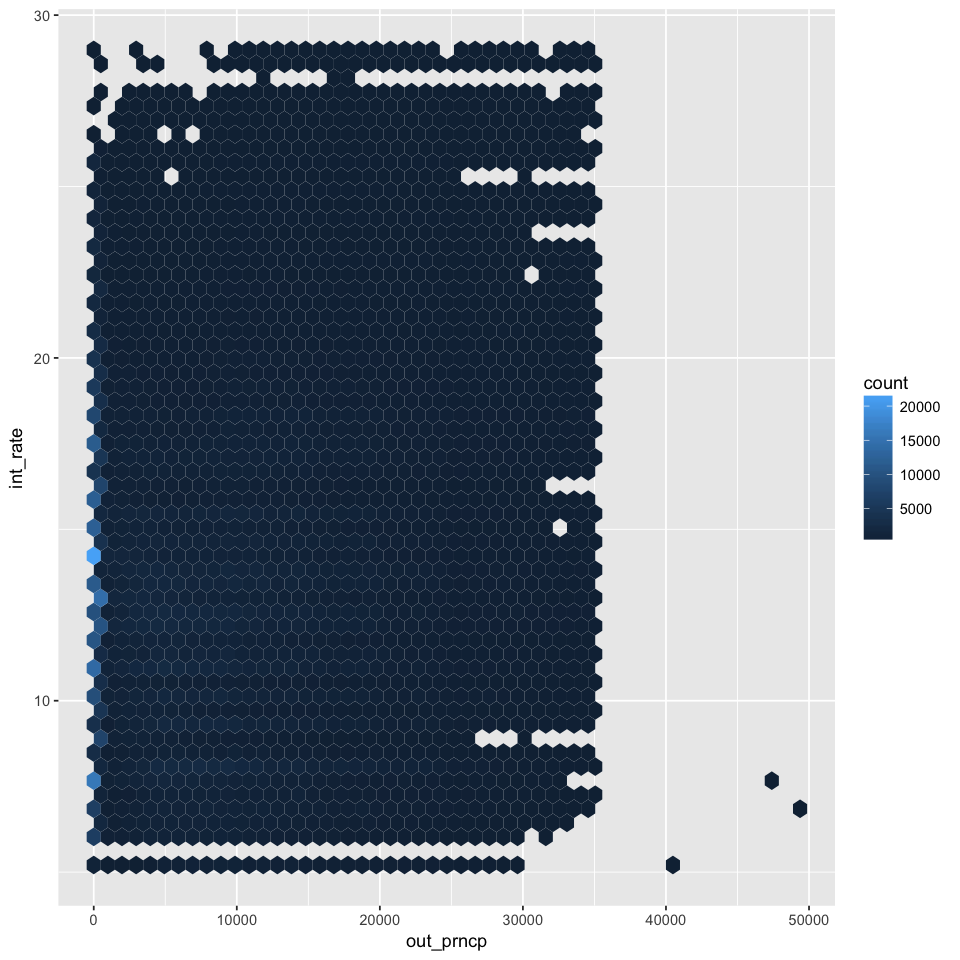

In [268]:
options(repr.plot.width=8, repr.plot.height=8)
ggplot(loan, aes(x=out_prncp, y=int_rate)) + geom_hex(bins=50) #+ stat_smooth(method=lm)

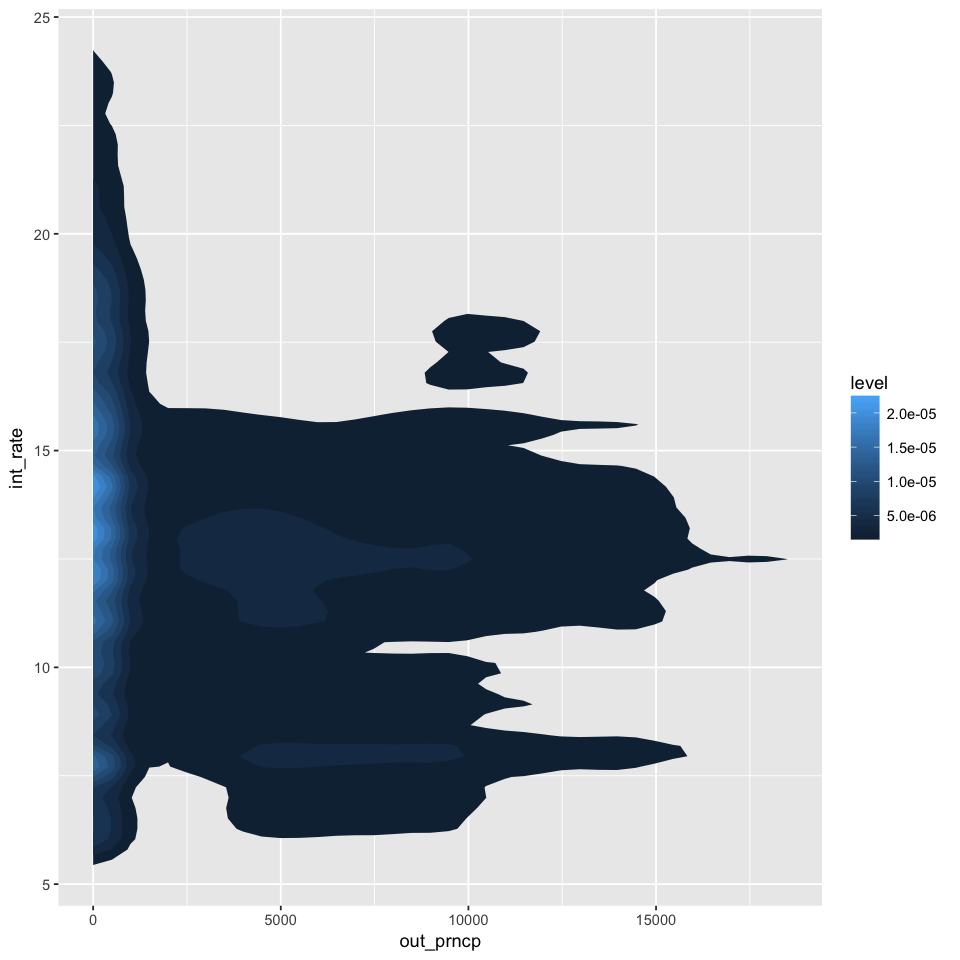

In [269]:
ggplot(loan, aes(x=out_prncp, y=int_rate)) + 
stat_density_2d(aes(fill = ..level..), geom = "polygon") 

##### 66.out_prncp_inv with int_rate
out_prncp_inv : Remaining outstanding principal for portion of total amount funded by investors

In [270]:
# keep one is enough
cor(loan$out_prncp, loan$out_prncp_inv)

[1] 0.9999972

### NA imputation

In [271]:
colnames(loan)

[1] "id"                          "member_id"                  
  [3] "loan_amnt"                   "funded_amnt"                
  [5] "funded_amnt_inv"             "term"                       
  [7] "int_rate"                    "installment"                
  [9] "grade"                       "sub_grade"                  
 [11] "emp_title"                   "emp_length"                 
 [13] "home_ownership"              "annual_inc"                 
 [15] "verification_status"         "issue_d"                    
 [17] "loan_status"                 "pymnt_plan"                 
 [19] "url"                         "desc"                       
 [21] "purpose"                     "title"                      
 [23] "zip_code"                    "addr_state"                 
 [25] "dti"                         "delinq_2yrs"                
 [27] "earliest_cr_line"            "inq_last_6mths"             
 [29] "mths_since_last_delinq"      "mths_since_last_record"     
 [31] "open_acc"                    "pub_rec"                    
 [33] "revol_bal"                   "revol_util"                 
 [35] "total_acc"                   "initial_list_status"        
 [37] "out_prncp"                   "out_prncp_inv"              
 [39] "total_pymnt"                 "total_pymnt_inv"            
 [41] "total_rec_prncp"             "total_rec_int"              
 [43] "total_rec_late_fee"          "recoveries"                 
 [45] "collection_recovery_fee"     "last_pymnt_d"               
 [47] "last_pymnt_amnt"             "next_pymnt_d"               
 [49] "last_credit_pull_d"          "collections_12_mths_ex_med" 
 [51] "mths_since_last_major_derog" "policy_code"                
 [53] "application_type"            "annual_inc_joint"           
 [55] "dti_joint"                   "verification_status_joint"  
 [57] "acc_now_delinq"              "tot_coll_amt"               
 [59] "tot_cur_bal"                 "open_acc_6m"                
 [61] "open_il_6m"                  "open_il_12m"                
 [63] "open_il_24m"                 "mths_since_rcnt_il"         
 [65] "total_bal_il"                "il_util"                    
 [67] "open_rv_12m"                 "open_rv_24m"                
 [69] "max_bal_bc"                  "all_util"                   
 [71] "total_rev_hi_lim"            "inq_fi"                     
 [73] "total_cu_tl"                 "inq_last_12m"               
 [75] "emp_length_sim"              "gen_emp_title_avg_rate"     
 [77] "gen_home_ownership"          "gen_add_state_zip"          
 [79] "gen_add_state_zip_ave_rate"  "gen_log_annual_inc"         
 [81] "dti_group"                   "earliest_cr_line_date"      
 [83] "gen_inq_last_6mths"          "last_credit_pull_d_date"    
 [85] "gen_log_tot_cur_bal"         "gen_acc_now_delinq"         
 [87] "gen_delinq_2yrs"             "gen_log_tot_coll_amt"       
 [89] "gen_pub_rec"                 "gen_log_revol_bal"          
 [91] "gen_log_total_rev_hi_lim"    "issue_d_date"               
 [93] "gen_issue_d"                 "gen_issue_year"             
 [95] "gen_issue_mon"               "gen_log_loan_amnt"          
 [97] "gen_log_installment"         "gen_log_funded_amnt"        
 [99] "gen_log_funded_amnt_inv"     "last_pymnt_d_date"          
[101] "next_pymnt_d_date"

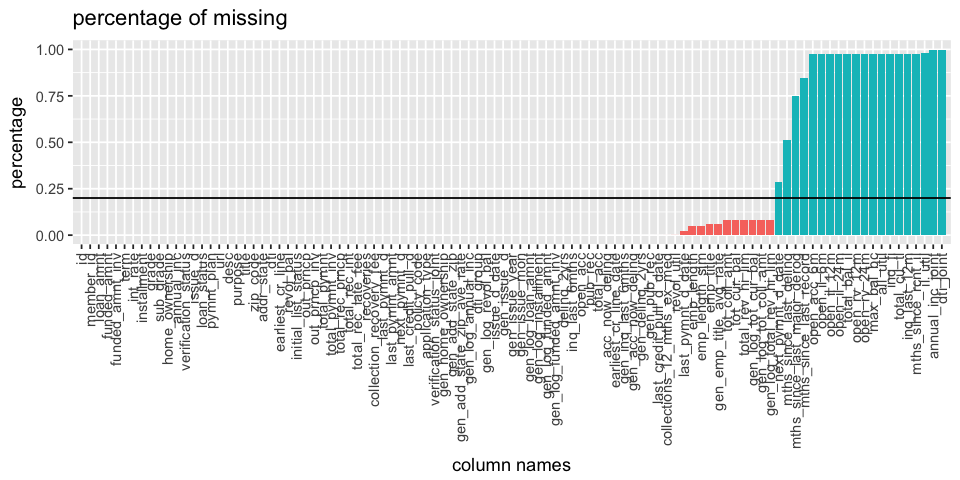

In [273]:


num.NA <- sort(colSums(sapply(loan, is.na)))

dfnum.NA <- data.frame(ind = c(1:length(num.NA)),
                       percentage = num.NA/nrow(loan),
                       per80 = num.NA/nrow(loan)>=0.2,
                           name = names(num.NA),
                       row.names = NULL) # convert to data.frame

options(repr.plot.width=8, repr.plot.height=4)
ggplot(data = dfnum.NA, aes(x=ind, y=percentage)) + 
  geom_bar(aes(fill=per80), stat="identity") + 
  scale_x_discrete(name ="column names", 
                   limits=dfnum.NA$name)+
  theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none") +
  geom_hline(yintercept = 0.2) + 
  ggtitle("percentage of missing")

In [274]:
dfnum.NA

ind,percentage,per80,name
1,0,FALSE,id
2,0,FALSE,member_id
3,0,FALSE,loan_amnt
4,0,FALSE,funded_amnt
5,0,FALSE,funded_amnt_inv
6,0,FALSE,term
7,0,FALSE,int_rate
8,0,FALSE,installment
9,0,FALSE,grade
10,0,FALSE,sub_grade


In [275]:
# drop missing > 80%
dfnum.NA$name[dfnum.NA$per80]

[1] next_pymnt_d_date           mths_since_last_delinq     
 [3] mths_since_last_major_derog mths_since_last_record     
 [5] open_acc_6m                 open_il_6m                 
 [7] open_il_12m                 open_il_24m                
 [9] total_bal_il                open_rv_12m                
[11] open_rv_24m                 max_bal_bc                 
[13] all_util                    inq_fi                     
[15] total_cu_tl                 inq_last_12m               
[17] mths_since_rcnt_il          il_util                    
[19] annual_inc_joint            dti_joint                  
101 Levels: acc_now_delinq addr_state all_util annual_inc ... zip_code

In [276]:
loan[, as.character(dfnum.NA$name[dfnum.NA$per80])] <- NULL

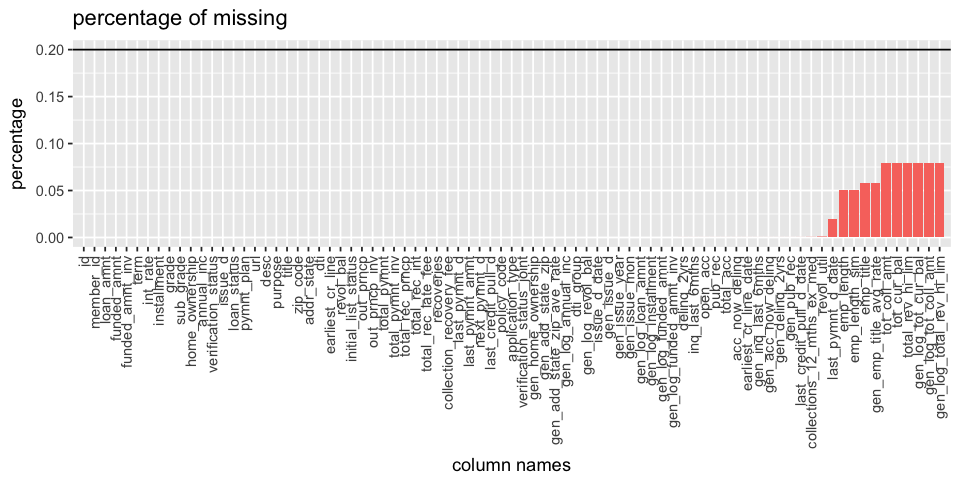

In [277]:
num.NA <- sort(colSums(sapply(loan, is.na)))

dfnum.NA <- data.frame(ind = c(1:length(num.NA)),
                       percentage = num.NA/nrow(loan),
                       per80 = num.NA/nrow(loan)>=0.2,
                           name = names(num.NA),
                       row.names = NULL) # convert to data.frame

options(repr.plot.width=8, repr.plot.height=4)
ggplot(data = dfnum.NA, aes(x=ind, y=percentage)) + 
  geom_bar(aes(fill=per80), stat="identity") + 
  scale_x_discrete(name ="column names", 
                   limits=dfnum.NA$name)+
  theme(axis.text.x = element_text(angle=90, hjust=1, vjust=.5),
        legend.position = "none") +
  geom_hline(yintercept = 0.2) + 
  ggtitle("percentage of missing")

### Feature Selection

In [278]:
apply(loan, 2, function(x){length(unique(x))})

id                  member_id 
                    887379                     887379 
                 loan_amnt                funded_amnt 
                      1372                       1372 
           funded_amnt_inv                       term 
                      9728                          2 
                  int_rate                installment 
                       542                      68711 
                     grade                  sub_grade 
                         7                         35 
                 emp_title                 emp_length 
                    261558                         12 
            home_ownership                 annual_inc 
                         6                      49384 
       verification_status                    issue_d 
                         3                        103 
               loan_status                 pymnt_plan 
                        10                          2 
                       url                       desc 
                    887379                     124471 
                   purpose                      title 
                        14                      53271 
                  zip_code                 addr_state 
                       935                         51 
                       dti                delinq_2yrs 
                      4086                         30 
          earliest_cr_line             inq_last_6mths 
                       698                         29 
                  open_acc                    pub_rec 
                        78                         33 
                 revol_bal                 revol_util 
                     73740                       1357 
                 total_acc        initial_list_status 
                       136                          2 
                 out_prncp              out_prncp_inv 
                    248332                     266244 
               total_pymnt            total_pymnt_inv 
                    503824                     506616 
           total_rec_prncp              total_rec_int 
                    260227                     324635 
        total_rec_late_fee                 recoveries 
                      6114                      23055 
   collection_recovery_fee               last_pymnt_d 
                     20414                         99 
           last_pymnt_amnt               next_pymnt_d 
                    232451                        101 
        last_credit_pull_d collections_12_mths_ex_med 
                       104                         13 
               policy_code           application_type 
                         1                          2 
 verification_status_joint             acc_now_delinq 
                         4                          9 
              tot_coll_amt                tot_cur_bal 
                     10326                     327343 
          total_rev_hi_lim             emp_length_sim 
                     21252                          3 
    gen_emp_title_avg_rate         gen_home_ownership 
                      2901                          4 
         gen_add_state_zip gen_add_state_zip_ave_rate 
                      1985                        353 
        gen_log_annual_inc                  dti_group 
                     49249                          3 
     earliest_cr_line_date         gen_inq_last_6mths 
                       698                          7 
   last_credit_pull_d_date        gen_log_tot_cur_bal 
                       104                     327343 
        gen_acc_now_delinq            gen_delinq_2yrs 
                         3                          4 
      gen_log_tot_coll_amt                gen_pub_rec 
                     10326                          3 
         gen_log_revol_bal   gen_log_total_rev_hi_lim 
                     73740                      21252 
              issue_d_date                gen_issue_d 
         

In [279]:
# remove all unique and single
loan[, c("id", "member_id", "url", "desc")] <- NULL

In [280]:
# drop loan payment features
# the problem is to predict int_rate given personal info, the payment is decided after interest rate is decided, 
#  so we don't use any information related with payment.
loan[, c("installment", "funded_amnt", "funded_amnt_inv",
         "last_pymnt_amnt", "last_pymnt_d", "next_pymnt_d", 'gen_add_state_zip',
         "pymnt_plan", "recoveries", "total_pymnt", "verification_status", 'verification_status_joint',
         "total_pymnt_inv", "total_rec_int", "total_rec_late_fee",
         "total_rec_prncp", "collection_recovery_fee", "out_prncp", "out_prncp_inv")] <- NULL

In [281]:
# drop potential response variables
loan[, c("grade", "sub_grade", "loan_status")] <- NULL

In [282]:
colnames(loan)

[1] "loan_amnt"                  "term"                      
 [3] "int_rate"                   "emp_title"                 
 [5] "emp_length"                 "home_ownership"            
 [7] "annual_inc"                 "issue_d"                   
 [9] "purpose"                    "title"                     
[11] "zip_code"                   "addr_state"                
[13] "dti"                        "delinq_2yrs"               
[15] "earliest_cr_line"           "inq_last_6mths"            
[17] "open_acc"                   "pub_rec"                   
[19] "revol_bal"                  "revol_util"                
[21] "total_acc"                  "initial_list_status"       
[23] "last_credit_pull_d"         "collections_12_mths_ex_med"
[25] "policy_code"                "application_type"          
[27] "acc_now_delinq"             "tot_coll_amt"              
[29] "tot_cur_bal"                "total_rev_hi_lim"          
[31] "emp_length_sim"             "gen_emp_title_avg_rate"    
[33] "gen_home_ownership"         "gen_add_state_zip_ave_rate"
[35] "gen_log_annual_inc"         "dti_group"                 
[37] "earliest_cr_line_date"      "gen_inq_last_6mths"        
[39] "last_credit_pull_d_date"    "gen_log_tot_cur_bal"       
[41] "gen_acc_now_delinq"         "gen_delinq_2yrs"           
[43] "gen_log_tot_coll_amt"       "gen_pub_rec"               
[45] "gen_log_revol_bal"          "gen_log_total_rev_hi_lim"  
[47] "issue_d_date"               "gen_issue_d"               
[49] "gen_issue_year"             "gen_issue_mon"             
[51] "gen_log_loan_amnt"          "gen_log_installment"       
[53] "gen_log_funded_amnt"        "gen_log_funded_amnt_inv"   
[55] "last_pymnt_d_date"

In [283]:
# drop "zip_code", "addr_state", "earliest_cr_line", "policy_code"
loan[, c("zip_code", "addr_state", "earliest_cr_line", "policy_code")] <- NULL

In [284]:
colnames(loan)

[1] "loan_amnt"                  "term"                      
 [3] "int_rate"                   "emp_title"                 
 [5] "emp_length"                 "home_ownership"            
 [7] "annual_inc"                 "issue_d"                   
 [9] "purpose"                    "title"                     
[11] "dti"                        "delinq_2yrs"               
[13] "inq_last_6mths"             "open_acc"                  
[15] "pub_rec"                    "revol_bal"                 
[17] "revol_util"                 "total_acc"                 
[19] "initial_list_status"        "last_credit_pull_d"        
[21] "collections_12_mths_ex_med" "application_type"          
[23] "acc_now_delinq"             "tot_coll_amt"              
[25] "tot_cur_bal"                "total_rev_hi_lim"          
[27] "emp_length_sim"             "gen_emp_title_avg_rate"    
[29] "gen_home_ownership"         "gen_add_state_zip_ave_rate"
[31] "gen_log_annual_inc"         "dti_group"                 
[33] "earliest_cr_line_date"      "gen_inq_last_6mths"        
[35] "last_credit_pull_d_date"    "gen_log_tot_cur_bal"       
[37] "gen_acc_now_delinq"         "gen_delinq_2yrs"           
[39] "gen_log_tot_coll_amt"       "gen_pub_rec"               
[41] "gen_log_revol_bal"          "gen_log_total_rev_hi_lim"  
[43] "issue_d_date"               "gen_issue_d"               
[45] "gen_issue_year"             "gen_issue_mon"             
[47] "gen_log_loan_amnt"          "gen_log_installment"       
[49] "gen_log_funded_amnt"        "gen_log_funded_amnt_inv"   
[51] "last_pymnt_d_date"

In [285]:
# drop all features with 'inv'
loan[, 'gen_log_funded_amnt_inv'] <- NULL

In [286]:
# add payment info 
loan[, c('gen_log_installment','gen_log_funded_amnt','last_pymnt_d_date')] <- NULL

In [287]:
colnames(loan)

[1] "loan_amnt"                  "term"                      
 [3] "int_rate"                   "emp_title"                 
 [5] "emp_length"                 "home_ownership"            
 [7] "annual_inc"                 "issue_d"                   
 [9] "purpose"                    "title"                     
[11] "dti"                        "delinq_2yrs"               
[13] "inq_last_6mths"             "open_acc"                  
[15] "pub_rec"                    "revol_bal"                 
[17] "revol_util"                 "total_acc"                 
[19] "initial_list_status"        "last_credit_pull_d"        
[21] "collections_12_mths_ex_med" "application_type"          
[23] "acc_now_delinq"             "tot_coll_amt"              
[25] "tot_cur_bal"                "total_rev_hi_lim"          
[27] "emp_length_sim"             "gen_emp_title_avg_rate"    
[29] "gen_home_ownership"         "gen_add_state_zip_ave_rate"
[31] "gen_log_annual_inc"         "dti_group"                 
[33] "earliest_cr_line_date"      "gen_inq_last_6mths"        
[35] "last_credit_pull_d_date"    "gen_log_tot_cur_bal"       
[37] "gen_acc_now_delinq"         "gen_delinq_2yrs"           
[39] "gen_log_tot_coll_amt"       "gen_pub_rec"               
[41] "gen_log_revol_bal"          "gen_log_total_rev_hi_lim"  
[43] "issue_d_date"               "gen_issue_d"               
[45] "gen_issue_year"             "gen_issue_mon"             
[47] "gen_log_loan_amnt"

In [288]:
# drop the original feature, leave the generate one
loan_new = loan
loan_new[,c('annual_inc','dti','inq_last_6mths','last_credit_pull_d','tot_cur_bal','acc_now_delinq','delinq_2yrs',
            'tot_coll_amnt','pub_rec','revol_bal','total_rev_hi_lim','emp_length','issue_d_date','loan_amnt')] <- NULL

### Build Models

#### 1. linear model using loan

In [289]:
# split data into train and test for model performance
set.seed(1)
loan.complete = loan[complete.cases(loan), ]
train.ind <- sample(1:dim(loan.complete)[1], 0.7 * dim(loan.complete)[1])
train <- loan.complete[train.ind, ]
test <- loan.complete[-train.ind, ]

In [290]:
colnames(loan)

[1] "loan_amnt"                  "term"                      
 [3] "int_rate"                   "emp_title"                 
 [5] "emp_length"                 "home_ownership"            
 [7] "annual_inc"                 "issue_d"                   
 [9] "purpose"                    "title"                     
[11] "dti"                        "delinq_2yrs"               
[13] "inq_last_6mths"             "open_acc"                  
[15] "pub_rec"                    "revol_bal"                 
[17] "revol_util"                 "total_acc"                 
[19] "initial_list_status"        "last_credit_pull_d"        
[21] "collections_12_mths_ex_med" "application_type"          
[23] "acc_now_delinq"             "tot_coll_amt"              
[25] "tot_cur_bal"                "total_rev_hi_lim"          
[27] "emp_length_sim"             "gen_emp_title_avg_rate"    
[29] "gen_home_ownership"         "gen_add_state_zip_ave_rate"
[31] "gen_log_annual_inc"         "dti_group"                 
[33] "earliest_cr_line_date"      "gen_inq_last_6mths"        
[35] "last_credit_pull_d_date"    "gen_log_tot_cur_bal"       
[37] "gen_acc_now_delinq"         "gen_delinq_2yrs"           
[39] "gen_log_tot_coll_amt"       "gen_pub_rec"               
[41] "gen_log_revol_bal"          "gen_log_total_rev_hi_lim"  
[43] "issue_d_date"               "gen_issue_d"               
[45] "gen_issue_year"             "gen_issue_mon"             
[47] "gen_log_loan_amnt"

In [291]:
# build linear model
# split data into train and test for model performance
mod <- lm(int_rate ~ gen_log_loan_amnt + term + gen_log_annual_inc + purpose + dti_group + gen_delinq_2yrs +
         inq_last_6mths + open_acc + gen_pub_rec + revol_bal + revol_util + total_acc +
          initial_list_status + collections_12_mths_ex_med + application_type + acc_now_delinq + 
          tot_coll_amt + tot_cur_bal + total_rev_hi_lim + emp_length_sim + 
          gen_home_ownership + gen_inq_last_6mths + 
          issue_d_date + gen_issue_year + gen_issue_mon + gen_add_state_zip_ave_rate
          ,data = train)
summary(mod)


Call:
lm(formula = int_rate ~ gen_log_loan_amnt + term + gen_log_annual_inc + 
    purpose + dti_group + gen_delinq_2yrs + inq_last_6mths + 
    open_acc + gen_pub_rec + revol_bal + revol_util + total_acc + 
    initial_list_status + collections_12_mths_ex_med + application_type + 
    acc_now_delinq + tot_coll_amt + tot_cur_bal + total_rev_hi_lim + 
    emp_length_sim + gen_home_ownership + gen_inq_last_6mths + 
    issue_d_date + gen_issue_year + gen_issue_mon + gen_add_state_zip_ave_rate, 
    data = train)

Residuals:
    Min      1Q  Median      3Q     Max 
-25.779  -2.255  -0.290   1.974 108.948 

Coefficients: (1 not defined because of singularities)
                             Estimate Std. Error  t value Pr(>|t|)    
(Intercept)                -8.246e+02  4.718e+01  -17.477  < 2e-16 ***
gen_log_loan_amnt           4.285e-01  8.792e-03   48.732  < 2e-16 ***
term 60 months              4.251e+00  1.054e-02  403.231  < 2e-16 ***
gen_log_annual_inc         -1.593e+00  1.138e-02 

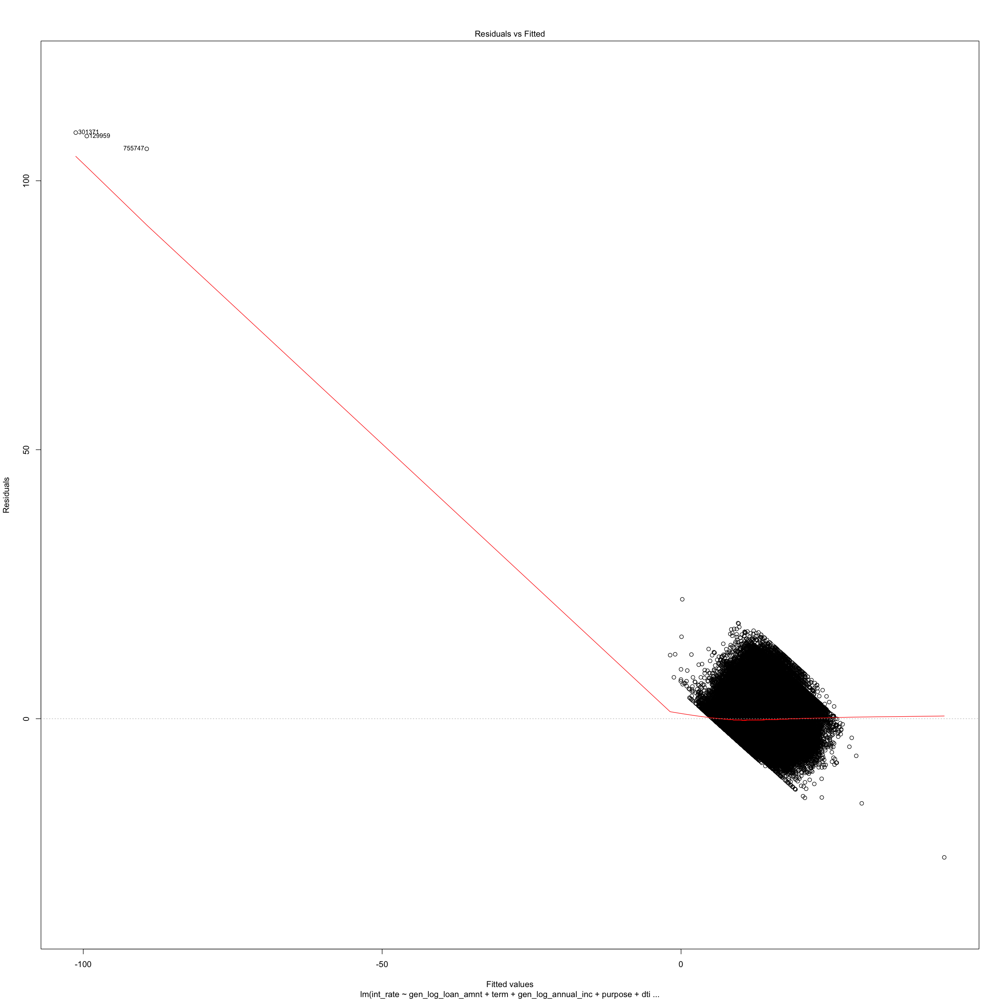

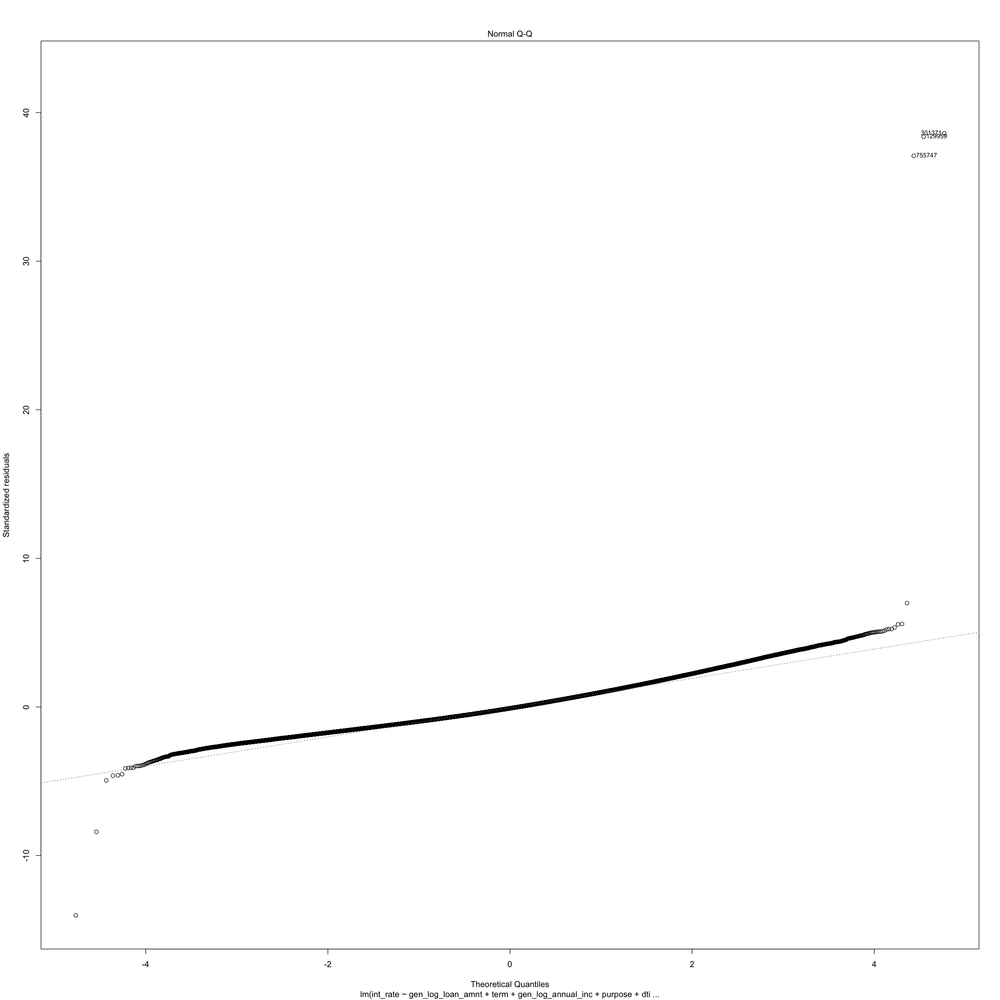

Warning message in sqrt(crit * p * (1 - hh)/hh):
“NaNs produced”Warning message in sqrt(crit * p * (1 - hh)/hh):
“NaNs produced”

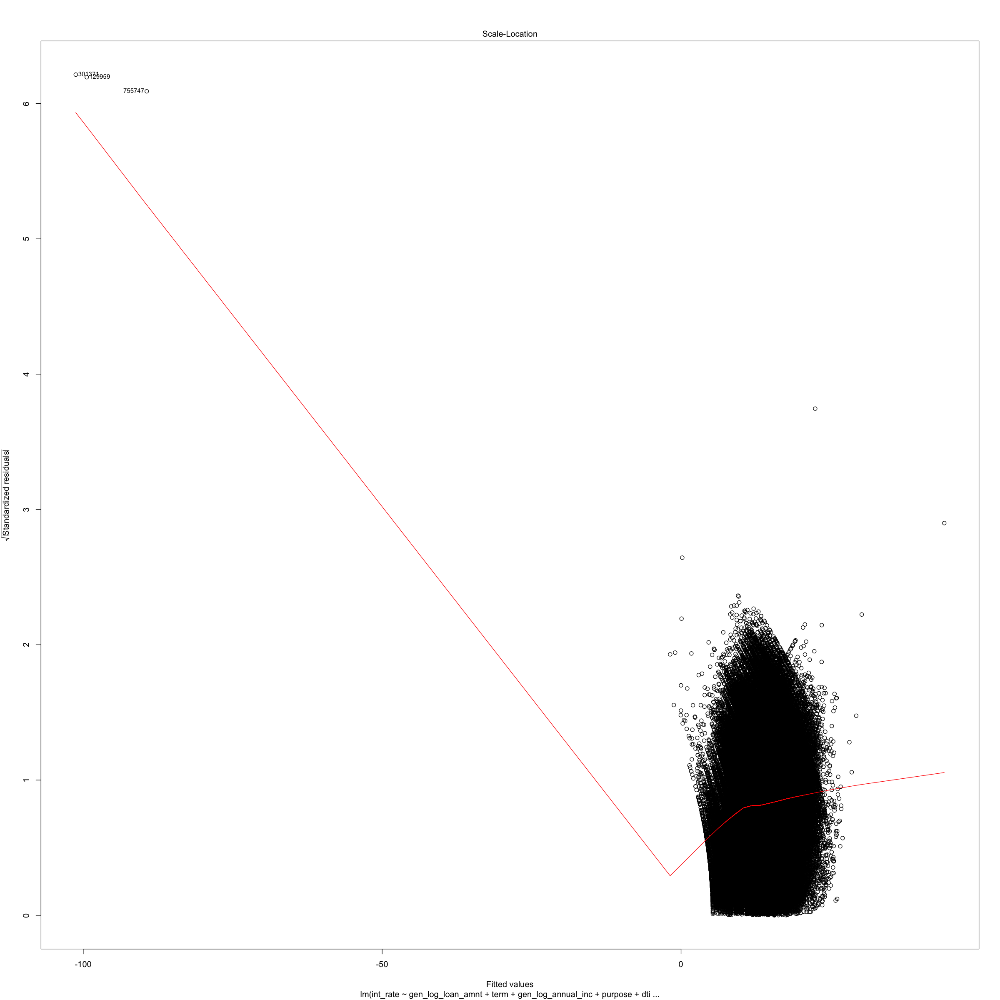

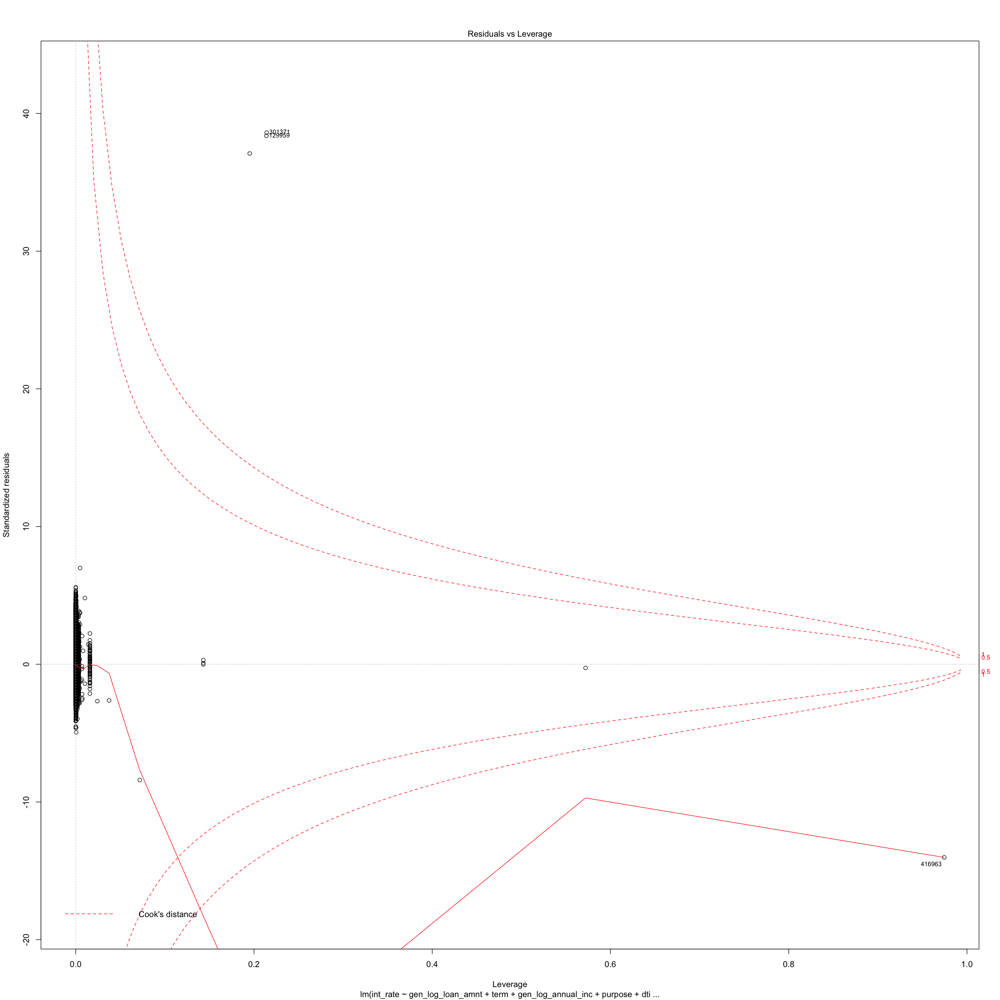

In [292]:
options(repr.plot.width = 20,repr.plot.height = 20)
plot(mod)

In [293]:
#remove outliers
train.sub = train[-which(rownames(train) %in% c(416963, 129959, 301371)), ]

In [296]:
mod2 = lm(int_rate ~ gen_log_loan_amnt + term + gen_log_annual_inc + purpose + dti_group + gen_delinq_2yrs +
         inq_last_6mths + open_acc + gen_pub_rec + revol_bal + revol_util + total_acc +
          initial_list_status + collections_12_mths_ex_med + application_type + acc_now_delinq + 
          tot_coll_amt + tot_cur_bal + total_rev_hi_lim + emp_length_sim + 
          gen_home_ownership + gen_inq_last_6mths + 
          issue_d_date + gen_issue_year + gen_issue_mon+ gen_add_state_zip_ave_rate
          ,data = train.sub)
summary(mod2)


Call:
lm(formula = int_rate ~ gen_log_loan_amnt + term + gen_log_annual_inc + 
    purpose + dti_group + gen_delinq_2yrs + inq_last_6mths + 
    open_acc + gen_pub_rec + revol_bal + revol_util + total_acc + 
    initial_list_status + collections_12_mths_ex_med + application_type + 
    acc_now_delinq + tot_coll_amt + tot_cur_bal + total_rev_hi_lim + 
    emp_length_sim + gen_home_ownership + gen_inq_last_6mths + 
    issue_d_date + gen_issue_year + gen_issue_mon + gen_add_state_zip_ave_rate, 
    data = train.sub)

Residuals:
    Min      1Q  Median      3Q     Max 
-25.459  -2.246  -0.283   1.965 182.570 

Coefficients: (1 not defined because of singularities)
                             Estimate Std. Error  t value Pr(>|t|)    
(Intercept)                -8.203e+02  4.700e+01  -17.454  < 2e-16 ***
gen_log_loan_amnt           4.708e-01  8.782e-03   53.613  < 2e-16 ***
term 60 months              4.233e+00  1.050e-02  402.939  < 2e-16 ***
gen_log_annual_inc         -1.552e+00  1.135e

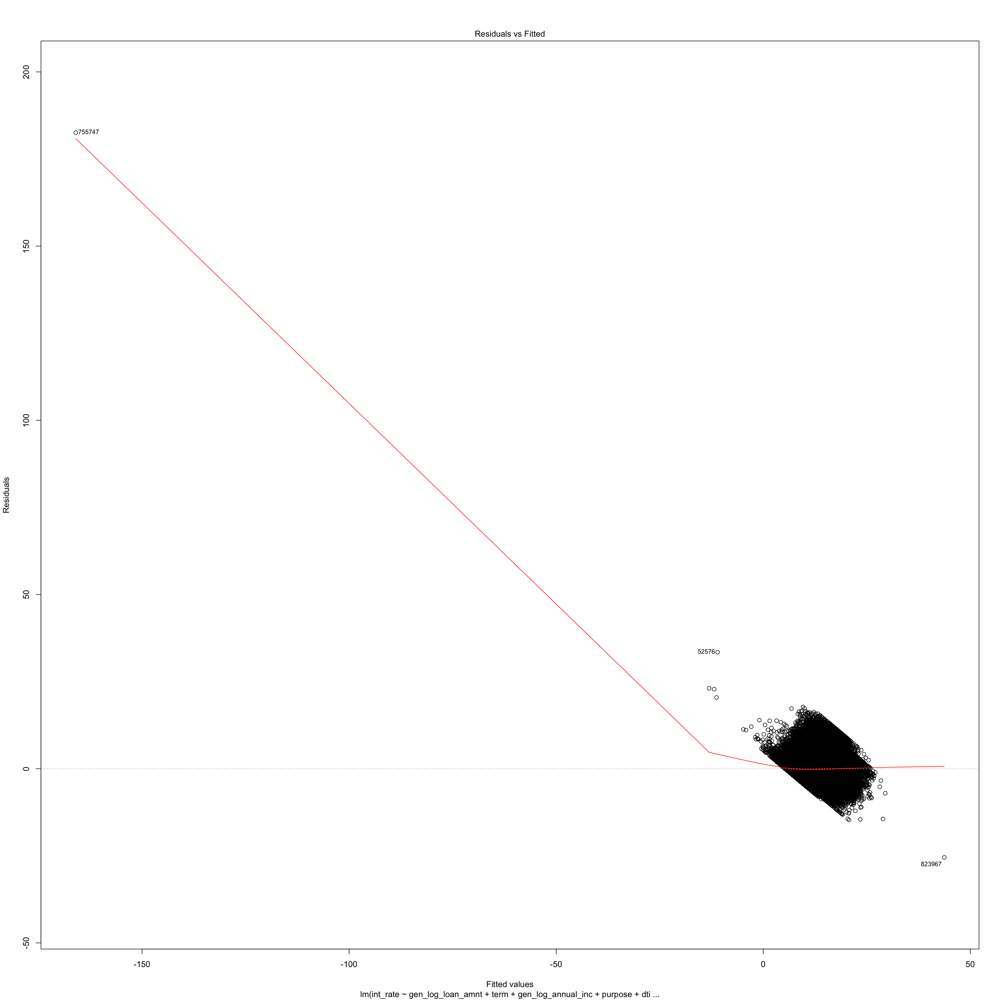

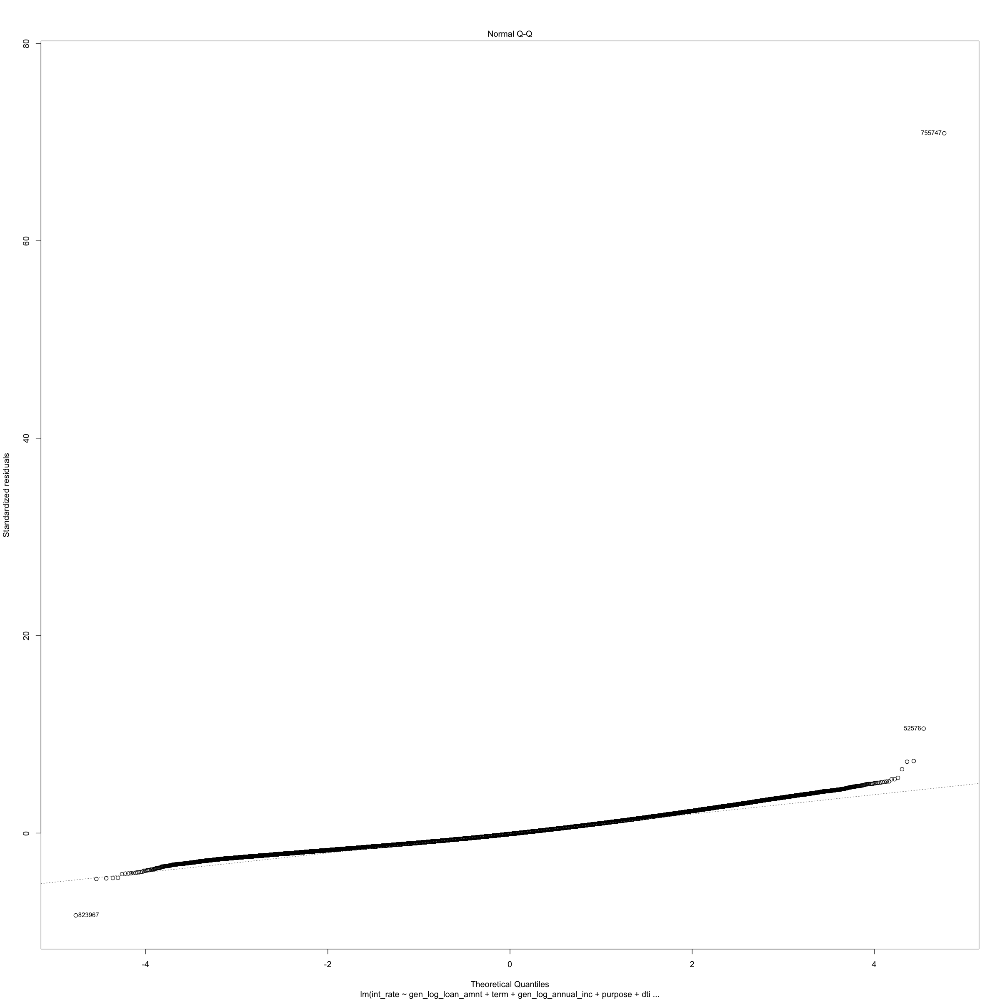

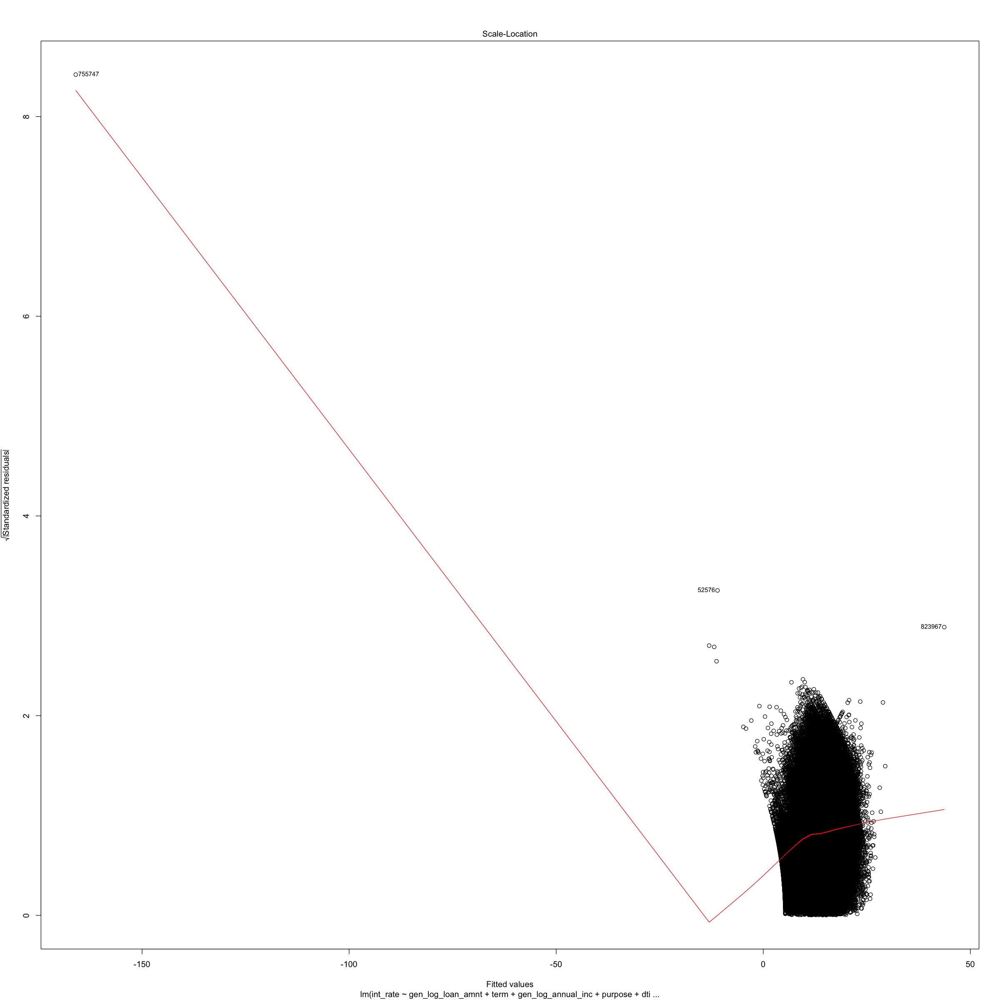

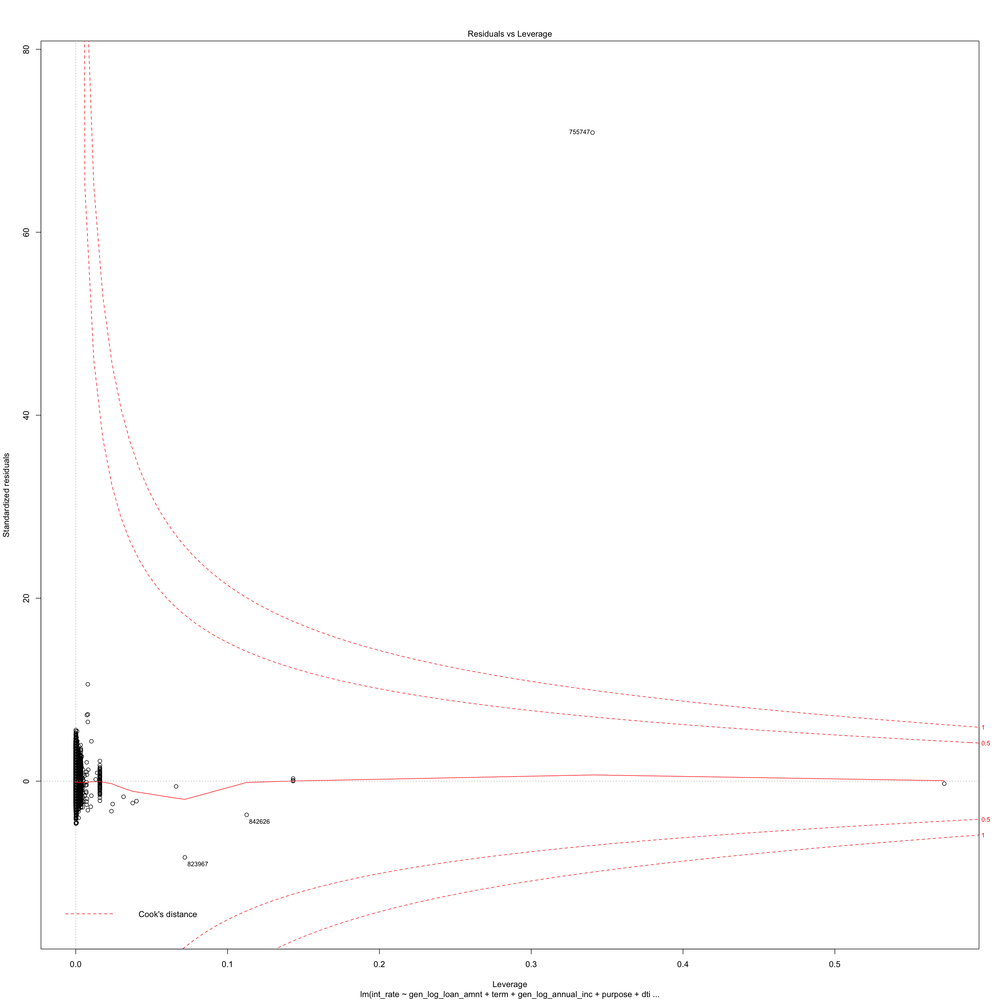

In [297]:
options(repr.plot.width = 20,repr.plot.height = 20)
plot(mod2)

In [298]:
train.sub2 = train.sub[-which(rownames(train.sub) %in% 755747),]

In [299]:
mod3 = lm(int_rate ~ gen_log_loan_amnt + term + gen_log_annual_inc + purpose + dti_group + gen_delinq_2yrs +
          open_acc + gen_pub_rec + revol_bal + revol_util + total_acc +
          initial_list_status + collections_12_mths_ex_med + application_type + acc_now_delinq + 
          tot_coll_amt + tot_cur_bal + total_rev_hi_lim + emp_length_sim + 
          gen_home_ownership + issue_d_date + I(loan_amnt^2) + sqrt(annual_inc) + 
          gen_inq_last_6mths + gen_add_state_zip_ave_rate
          ,data = train.sub2)
summary(mod3)


Call:
lm(formula = int_rate ~ gen_log_loan_amnt + term + gen_log_annual_inc + 
    purpose + dti_group + gen_delinq_2yrs + open_acc + gen_pub_rec + 
    revol_bal + revol_util + total_acc + initial_list_status + 
    collections_12_mths_ex_med + application_type + acc_now_delinq + 
    tot_coll_amt + tot_cur_bal + total_rev_hi_lim + emp_length_sim + 
    gen_home_ownership + issue_d_date + I(loan_amnt^2) + sqrt(annual_inc) + 
    gen_inq_last_6mths + gen_add_state_zip_ave_rate, data = train.sub2)

Residuals:
    Min      1Q  Median      3Q     Max 
-25.607  -2.158  -0.257   1.898  47.649 

Coefficients:
                             Estimate Std. Error  t value Pr(>|t|)    
(Intercept)                -1.339e+03  1.030e+01 -130.046  < 2e-16 ***
gen_log_loan_amnt          -7.762e-01  1.222e-02  -63.534  < 2e-16 ***
term 60 months              4.166e+00  1.023e-02  407.226  < 2e-16 ***
gen_log_annual_inc         -3.373e+00  3.322e-02 -101.542  < 2e-16 ***
purposecredit_card         -1.304

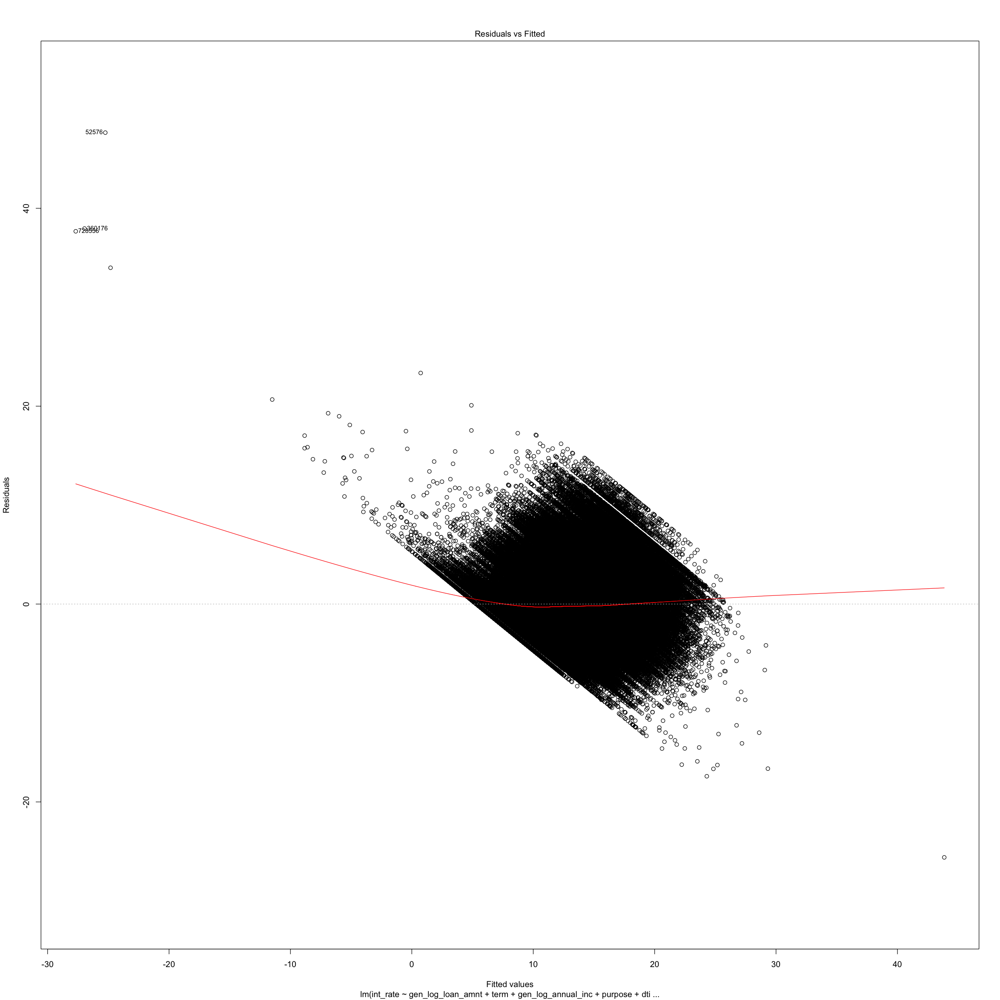

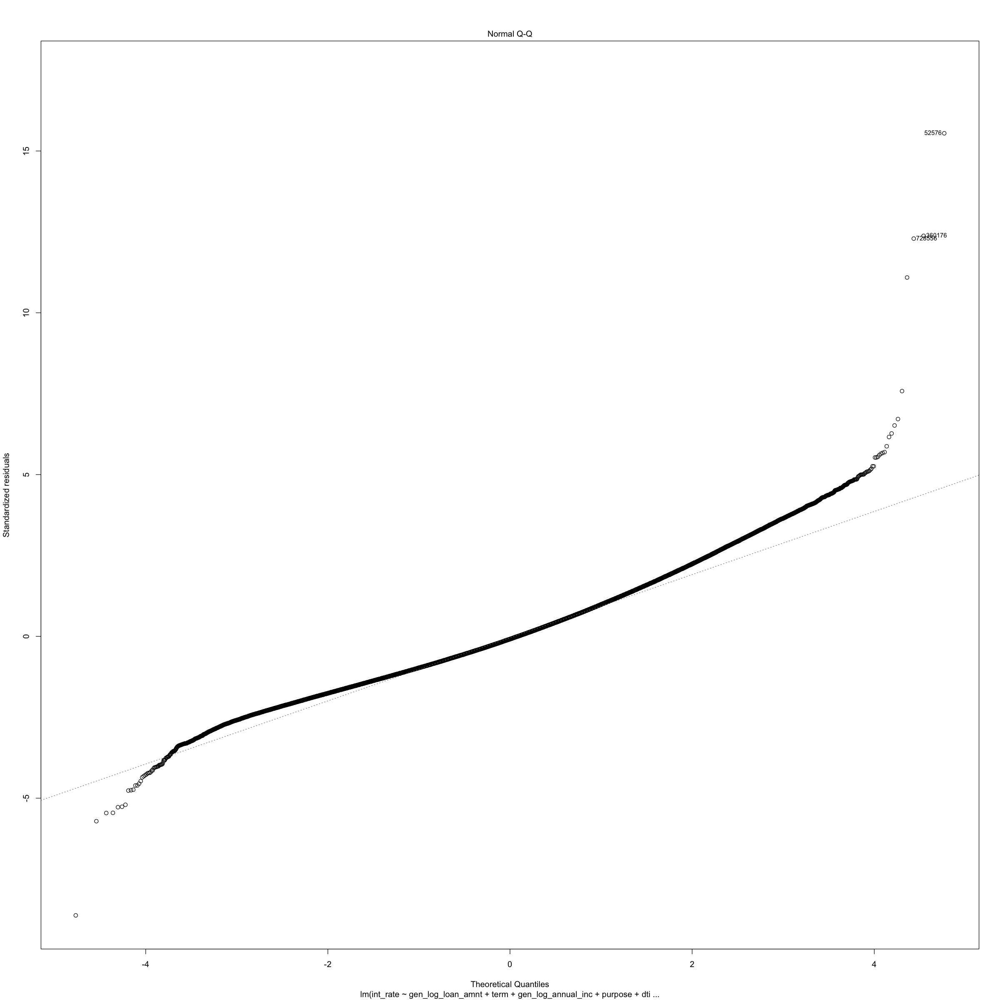

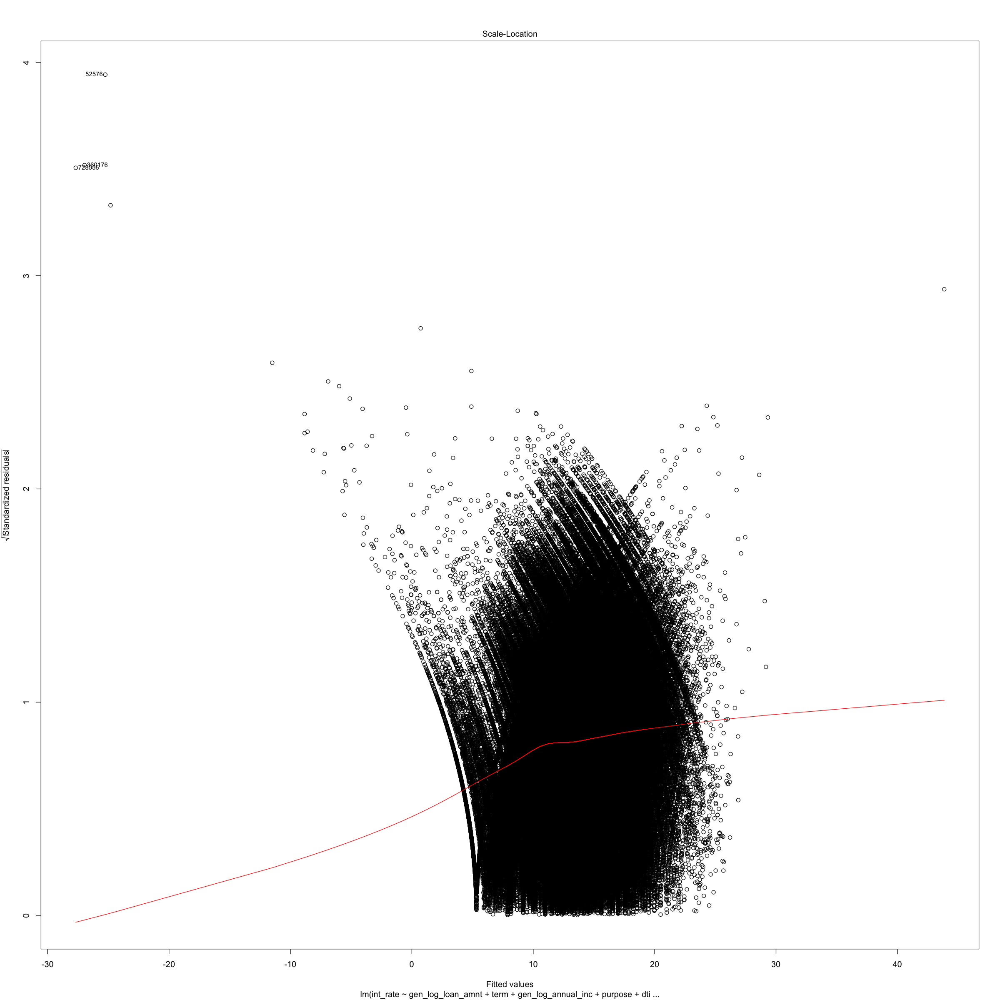

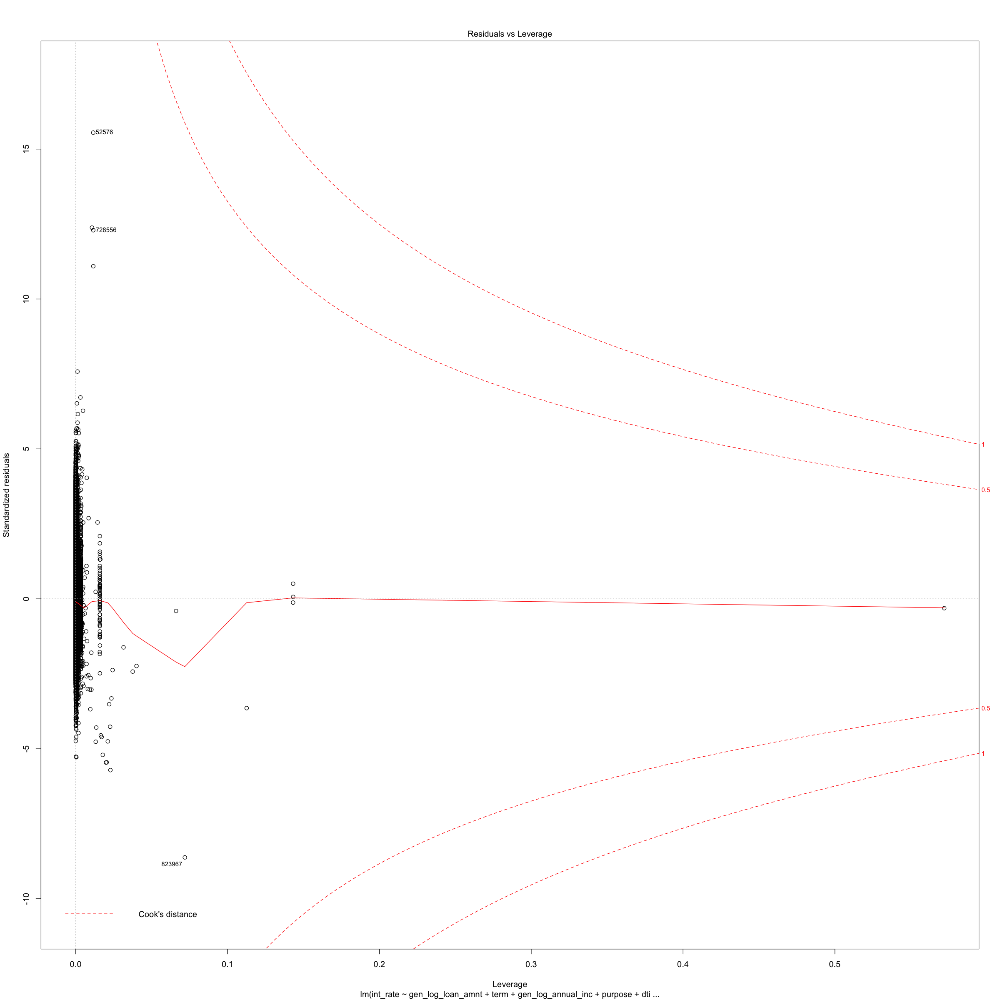

In [300]:
options(repr.plot.width = 20,repr.plot.height = 20)
plot(mod3)

In [301]:
library(car)
vif(mod3)

,GVIF,Df,GVIF^(1/(2*Df))
gen_log_loan_amnt,3.589043,1,1.894477
term,1.275455,1,1.129361
gen_log_annual_inc,16.410794,1,4.051024
purpose,1.208361,12,1.007917
dti_group,1.011712,1,1.005839
gen_delinq_2yrs,1.065740,1,1.032347
open_acc,2.153887,1,1.467613
gen_pub_rec,1.081663,1,1.040030
revol_bal,6.054864,1,2.460663
revol_util,1.830582,1,1.352990


In [302]:
# remove feature that vif > 5:
mod4 = lm(int_rate ~ gen_log_loan_amnt + term + gen_log_annual_inc + purpose + dti_group + gen_delinq_2yrs +
          open_acc + gen_pub_rec +  revol_util + total_acc +
          initial_list_status + collections_12_mths_ex_med + application_type + acc_now_delinq + 
          tot_coll_amt + tot_cur_bal + total_rev_hi_lim + emp_length_sim + 
          gen_home_ownership + issue_d_date + I(loan_amnt^2) + 
          gen_inq_last_6mths + gen_add_state_zip_ave_rate
          ,data = train.sub2)
summary(mod4)


Call:
lm(formula = int_rate ~ gen_log_loan_amnt + term + gen_log_annual_inc + 
    purpose + dti_group + gen_delinq_2yrs + open_acc + gen_pub_rec + 
    revol_util + total_acc + initial_list_status + collections_12_mths_ex_med + 
    application_type + acc_now_delinq + tot_coll_amt + tot_cur_bal + 
    total_rev_hi_lim + emp_length_sim + gen_home_ownership + 
    issue_d_date + I(loan_amnt^2) + gen_inq_last_6mths + gen_add_state_zip_ave_rate, 
    data = train.sub2)

Residuals:
     Min       1Q   Median       3Q      Max 
-25.6940  -2.1827  -0.2721   1.9099  30.7018 

Coefficients:
                             Estimate Std. Error  t value Pr(>|t|)    
(Intercept)                -1.339e+03  1.039e+01 -128.891  < 2e-16 ***
gen_log_loan_amnt          -9.062e-01  1.222e-02  -74.171  < 2e-16 ***
term 60 months              4.168e+00  1.031e-02  404.289  < 2e-16 ***
gen_log_annual_inc         -1.792e+00  1.129e-02 -158.679  < 2e-16 ***
purposecredit_card         -1.341e+00  4.766e-02  -28.

In [303]:
vif(mod4)

,GVIF,Df,GVIF^(1/(2*Df))
gen_log_loan_amnt,3.525664,1,1.877675
term,1.272951,1,1.128251
gen_log_annual_inc,1.863632,1,1.365149
purpose,1.207416,12,1.007884
dti_group,1.011533,1,1.005750
gen_delinq_2yrs,1.064304,1,1.031651
open_acc,2.127601,1,1.458630
gen_pub_rec,1.074770,1,1.036711
revol_util,1.159476,1,1.076790
total_acc,2.154059,1,1.467671


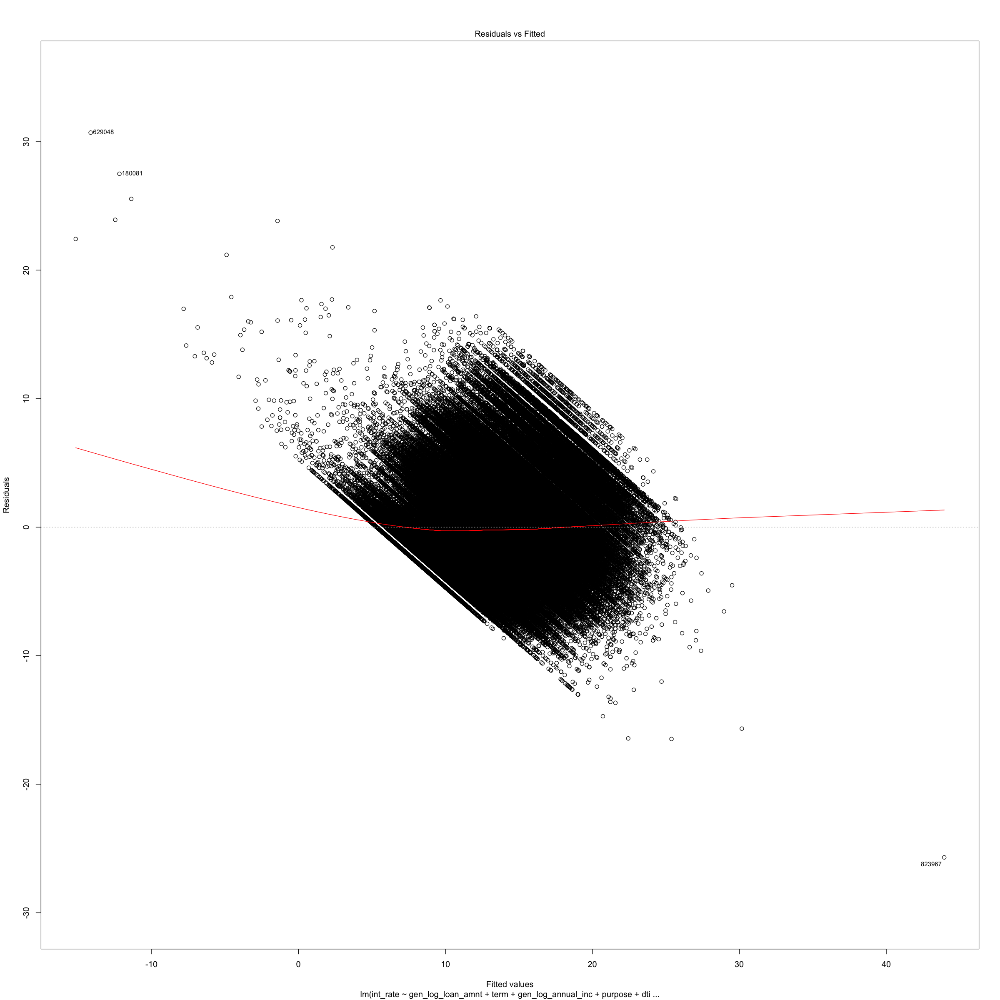

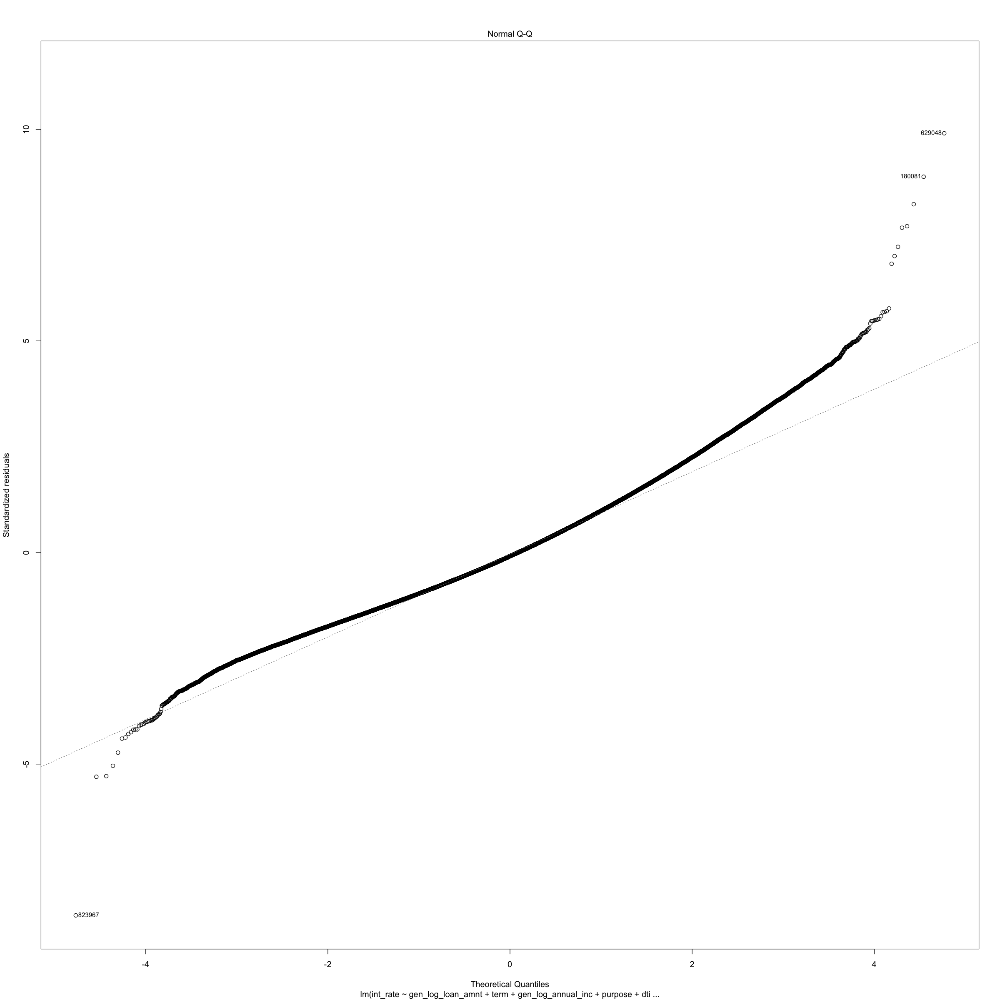

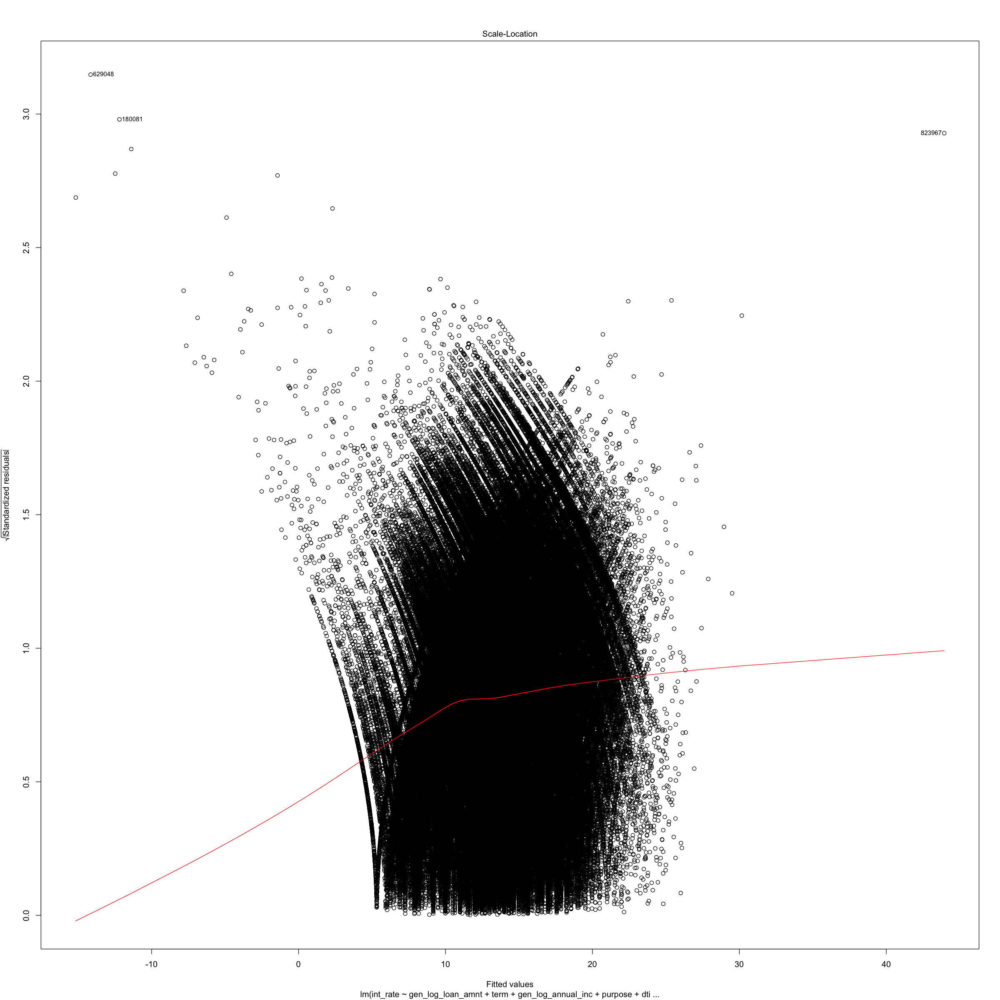

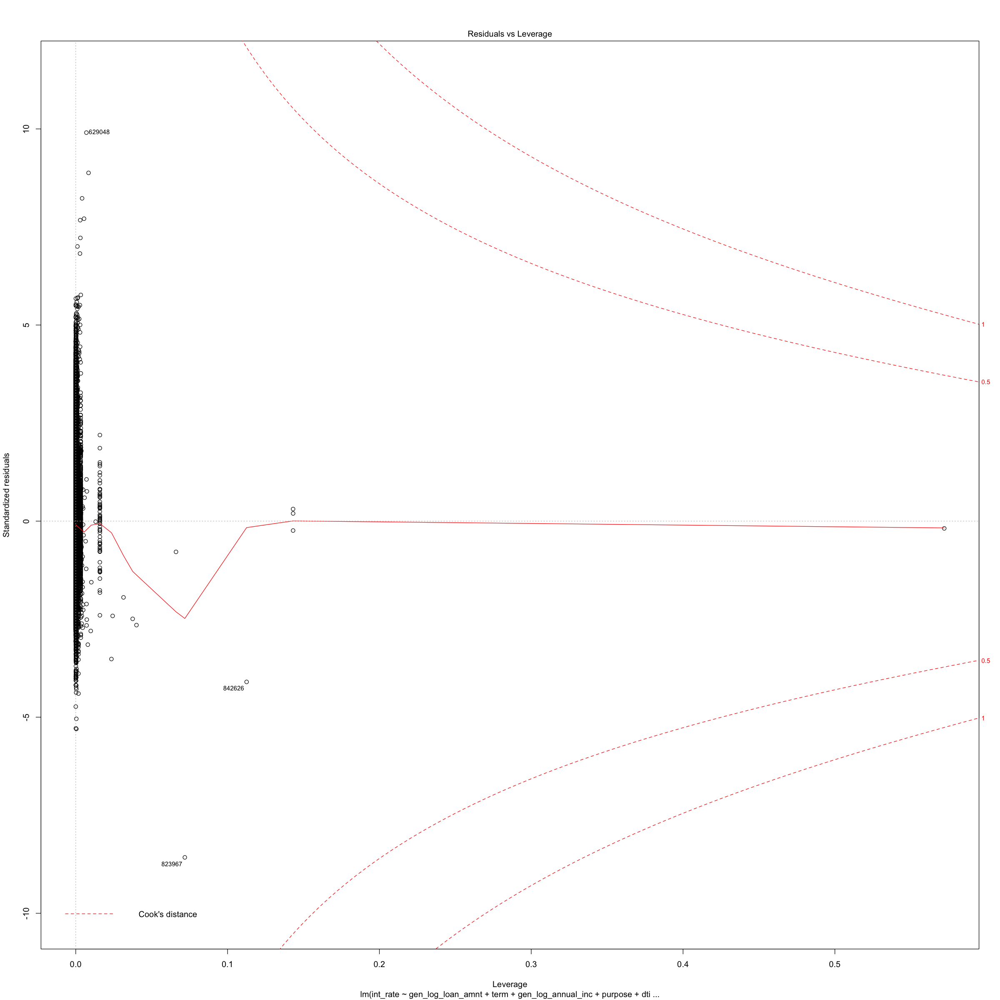

In [304]:
options(repr.plot.width = 20,repr.plot.height = 20)
plot(mod4)

### Validation:
rough ideas:

1. evaluate model on unseen data
2. evaluate model with different algorithms
3. evaluate model with different parameters



In [307]:
# process data again
# generate nonlinear features
loan.complete$gen_loan_amnt_square = loan.complete$loan_amnt^2

# using selected numerical features
selected_features = c("gen_log_loan_amnt", "gen_log_annual_inc", "open_acc",
                      "revol_util", "total_acc", "gen_add_state_zip_ave_rate",
                      "tot_coll_amt", "tot_cur_bal", "total_rev_hi_lim", "int_rate", "gen_loan_amnt_square")



In [308]:
# generate dummy variables
dummy.variable = model.matrix(~term + purpose+ dti_group+ gen_delinq_2yrs+gen_pub_rec+initial_list_status+
                              collections_12_mths_ex_med + application_type + acc_now_delinq +emp_length_sim + 
                              gen_home_ownership + issue_d_date + gen_inq_last_6mths  - 1, loan.complete)

In [309]:
# numerical variable
num.variable = as.matrix(loan.complete[, selected_features])

In [310]:
# combine dummy with loan data
loan.sim = cbind(num.variable, dummy.variable)

In [312]:
# split train test
train <- loan.sim[train.ind, ]
test <- loan.sim[-train.ind, ]

### using elastic net to train glm

In [313]:
library(glmnet)

Loading required package: Matrix
Loading required package: foreach
Loaded glmnet 2.0-5



In [314]:
which(colnames(train) == 'int_rate')

[1] 10

In [315]:
train.feature = train[,-10]
train.label = train[,10]
test.feature = train[,-10]
test.label = train[,10]



In [322]:
save(train.feature,file =  'train_feature.Rdata')
save(train.label,file =  'train_label.Rdata')

save(test.feature,file =  'test_feature.Rdata')

save(test.label,file =  'test_label.Rdata')


In [323]:
colnames(train.feature)

[1] "gen_log_loan_amnt"          "gen_log_annual_inc"        
 [3] "open_acc"                   "revol_util"                
 [5] "total_acc"                  "gen_add_state_zip_ave_rate"
 [7] "tot_coll_amt"               "tot_cur_bal"               
 [9] "total_rev_hi_lim"           "gen_loan_amnt_square"      
[11] "term 36 months"             "term 60 months"            
[13] "purposecredit_card"         "purposedebt_consolidation" 
[15] "purposeeducational"         "purposehome_improvement"   
[17] "purposehouse"               "purposemajor_purchase"     
[19] "purposemedical"             "purposemoving"             
[21] "purposeother"               "purposerenewable_energy"   
[23] "purposesmall_business"      "purposevacation"           
[25] "purposewedding"             "dti_group"                 
[27] "gen_delinq_2yrs"            "gen_pub_rec"               
[29] "initial_list_statusw"       "collections_12_mths_ex_med"
[31] "application_typeJOINT"      "acc_now_delinq"            
[33] "emp_length_sim>= 5"         "gen_home_ownershipothers"  
[35] "gen_home_ownershipOWN"      "gen_home_ownershipRENT"    
[37] "issue_d_date"               "gen_inq_last_6mths"

In [324]:
# train.feature = load('train_feature.Rdata')
# train.label = load('train_label.Rdata')
# test.feature = load('test_feature.Rdata')
# test.label = load('test_label.Rdata')

In [325]:
# mod.glmnet <- glmnet(x=train.feature, y=train.label)

In [326]:
cvfit <- cv.glmnet(train.feature, train.label,type.measure='mse')
# plot(cvfit)

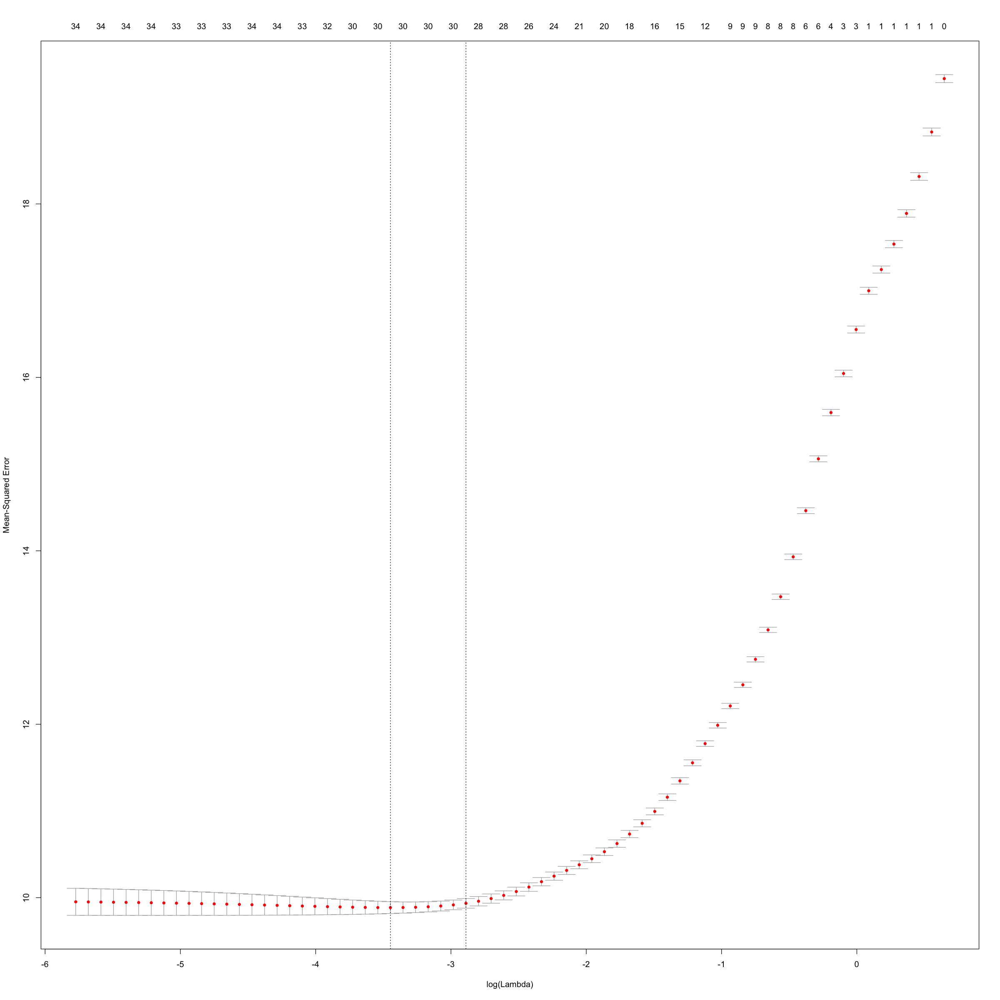

In [327]:
plot(cvfit)

In [331]:
# predict result with minimum mean cross-validated error
glm.pred = predict(cvfit, newx = test.feature, s = "lambda.min")

In [332]:
# cross validation result : root mean square error

mean((glm.pred - test.label)^2)^0.5

[1] 3.132355

### Nonlinear model --- random forest

In [3]:
library(randomForest)

randomForest 4.6-12
Type rfNews() to see new features/changes/bug fixes.


In [335]:
# convert categorical data to factor
loan.complete$purpose = as.factor(loan.complete$purpose)
loan.complete$term = as.factor(loan.complete$term)
loan.complete$dti_group = as.factor(loan.complete$dti_group)
loan.complete$gen_delinq_2yrs = as.factor(loan.complete$gen_delinq_2yrs)
loan.complete$gen_pub_rec = as.factor(loan.complete$gen_pub_rec)
loan.complete$initial_list_status = as.factor(loan.complete$initial_list_status)
loan.complete$application_type = as.factor(loan.complete$application_typ)
loan.complete$issue_d_date = as.factor(loan.complete$issue_d_date)
loan.complete$gen_inq_last_6mths = as.factor(loan.complete$gen_inq_last_6mths)
loan.complete$gen_home_ownership = as.factor(loan.complete$gen_home_ownership)
loan.complete$collections_12_mths_ex_med = as.factor(loan.complete$collections_12_mths_ex_med)
loan.complete$acc_now_delinq = as.factor(loan.complete$acc_now_delinq)
loan.complete$emp_length_sim = as.factor(loan.complete$emp_length_sim)

In [336]:
selected_features = c("gen_log_loan_amnt", "gen_log_annual_inc", "open_acc",
                      "revol_util", "total_acc", "gen_add_state_zip_ave_rate",
                      "tot_coll_amt", "tot_cur_bal", "total_rev_hi_lim", "int_rate", "gen_loan_amnt_square",
                      "term", "purpose", "dti_group", "gen_delinq_2yrs", "gen_pub_rec", "initial_list_status", 
                      "collections_12_mths_ex_med", "application_type", "acc_now_delinq", "emp_length_sim", 
                      "gen_home_ownership", "issue_d_date", "gen_inq_last_6mths")



In [337]:
# random forest can handle categorical data
train.rf <- loan.complete[train.ind, selected_features]
test.rf <- loan.complete[-train.ind, selected_features]

save(train.rf, file = "train_rf.Rdata")
save(test.rf, file = "test_rf.Rdata")

In [338]:
which(colnames(train.rf) == "int_rate")

[1] 10

In [345]:
rf <- randomForest(x = train.rf[, -10],
                   y = train.rf[, 10], 
                   xtest = test.rf[, -10],
                   ytest = test.rf[, 10],
                   do.trace = T,
                   nodesize = 5000, ntree = 50)

     |      Out-of-bag   |       Test set    |
Tree |      MSE  %Var(y) |      MSE  %Var(y) |
   1 |    11.72    60.25 |    11.85    60.79 |
   2 |    11.65    59.89 |    11.27    57.80 |
   3 |    11.47    58.98 |    10.89    55.88 |
   4 |    11.27    57.94 |    10.76    55.18 |
   5 |     11.2    57.59 |    10.73    55.04 |
   6 |    11.14    57.30 |    10.69    54.83 |
   7 |    11.03    56.73 |    10.62    54.47 |
   8 |    10.96    56.35 |     10.6    54.37 |
   9 |     10.9    56.04 |    10.59    54.32 |
  10 |    10.86    55.82 |    10.58    54.30 |
  11 |    10.81    55.56 |    10.57    54.23 |
  12 |    10.75    55.26 |    10.53    54.04 |
  13 |    10.71    55.06 |    10.52    53.96 |
  14 |    10.68    54.90 |     10.5    53.86 |
  15 |    10.65    54.77 |    10.49    53.82 |
  16 |    10.63    54.65 |    10.49    53.79 |
  17 |    10.61    54.54 |    10.48    53.77 |
  18 |    10.58    54.42 |    10.47    53.72 |
  19 |    10.56    54.33 |    10.46    53.66 |
  20 |    10.

In [2]:
load("train_rf.Rdata")
load("test_rf.Rdata")

In [4]:
# combine 2 forest
print('start')
rf1 <- randomForest(x = train.rf[, -10], y = train.rf[, 10],nodesize = 5000, ntree=50)


[1] "start"


In [5]:
print(1)
rf2 <- randomForest(x = train.rf[, -10], y = train.rf[, 10], nodesize = 5000,ntree=50)


[1] 1


In [6]:
print(2)
rf.comb <- combine(rf1, rf2)



[1] 2


In [8]:
# random forest prediction
rf.pred = predict(rf.comb, test.rf[, -10])

# test rmse
mean((rf.pred - test.rf[,10])^2)^0.5

[1] 3.219994

In [340]:
save(loan.complete, file = "loan_complete.Rdata")

In [1]:
library(catboost)

In [3]:
# catboost: convert to catboost data, where numerical variable has to be numeric, categorical variable has to be factor
train_pool = catboost.load_pool(data=train.rf[, -10], label = train.rf[, 10])
test_pool = catboost.load_pool(data=test.rf[, -10], label = test.rf[, 10])

In [4]:
ave_error = 0
m = 2
# 
for(i in c(1:m))
{
#  list of parameters
  fit_params <- list(iterations = 200,
                     loss_function = 'RMSE',
                     depth = 6,
                     learning_rate = 0.3,
                     l2_leaf_reg = 3)
  # train model
  model <- catboost.train(train_pool, test_pool, fit_params)
  # prediction
  prediction <- catboost.predict(model, test_pool)
  # current error
  current_error = mean((prediction - test.rf[, 21])^2)
  print(current_error)
  ave_error = ave_error + current_error
}

ave_error/m

0:	learn: 10.1498038	test: 10.1542297	best: 10.1542297 (0)	total: 1.83s	remaining: 6m 3s
1:	learn: 7.5525079	test: 7.5580319	best: 7.5580319 (1)	total: 3.29s	remaining: 5m 26s
2:	learn: 5.8638916	test: 5.8705782	best: 5.8705782 (2)	total: 4.64s	remaining: 5m 4s
3:	learn: 4.7679108	test: 4.7765961	best: 4.7765961 (3)	total: 6.32s	remaining: 5m 9s
4:	learn: 4.1101804	test: 4.1202183	best: 4.1202183 (4)	total: 7.63s	remaining: 4m 57s
5:	learn: 3.6864500	test: 3.6945995	best: 3.6945995 (5)	total: 8.96s	remaining: 4m 49s
6:	learn: 3.4280681	test: 3.4375001	best: 3.4375001 (6)	total: 10.1s	remaining: 4m 37s
7:	learn: 3.2868313	test: 3.2955332	best: 3.2955332 (7)	total: 11.2s	remaining: 4m 29s
8:	learn: 3.2018355	test: 3.2102999	best: 3.2102999 (8)	total: 13.1s	remaining: 4m 37s
9:	learn: 3.1512329	test: 3.1569772	best: 3.1569772 (9)	total: 14.7s	remaining: 4m 38s
10:	learn: 3.1159511	test: 3.1214782	best: 3.1214782 (10)	total: 16.4s	remaining: 4m 41s
11:	learn: 3.0891567	test: 3.0955957	best

Warning message in Ops.factor(prediction, test.rf[, 21]):
“‘-’ not meaningful for factors”

[1] NA
0:	learn: 10.1500067	test: 10.1546558	best: 10.1546558 (0)	total: 1.92s	remaining: 6m 22s
1:	learn: 7.5511073	test: 7.5567346	best: 7.5567346 (1)	total: 3.3s	remaining: 5m 27s
2:	learn: 5.8608100	test: 5.8677668	best: 5.8677668 (2)	total: 4.75s	remaining: 5m 12s
3:	learn: 4.7715652	test: 4.7795609	best: 4.7795609 (3)	total: 6.44s	remaining: 5m 15s
4:	learn: 4.1101398	test: 4.1196214	best: 4.1196214 (4)	total: 7.85s	remaining: 5m 6s
5:	learn: 3.6814418	test: 3.6903782	best: 3.6903782 (5)	total: 9.23s	remaining: 4m 58s
6:	learn: 3.4241858	test: 3.4313703	best: 3.4313703 (6)	total: 10.8s	remaining: 4m 56s
7:	learn: 3.2818434	test: 3.2887607	best: 3.2887607 (7)	total: 12.2s	remaining: 4m 53s
8:	learn: 3.2003081	test: 3.2072256	best: 3.2072256 (8)	total: 13.6s	remaining: 4m 48s
9:	learn: 3.1480064	test: 3.1537162	best: 3.1537162 (9)	total: 15.2s	remaining: 4m 48s
10:	learn: 3.1118524	test: 3.1183093	best: 3.1183093 (10)	total: 16.8s	remaining: 4m 48s
11:	learn: 3.0858968	test: 3.0922

Warning message in Ops.factor(prediction, test.rf[, 21]):
“‘-’ not meaningful for factors”

[1] NA


[1] NA

### Nonlinear Model --- xgboost

In [5]:
library(xgboost) 

In [6]:
# load data
load("train_feature.Rdata")
load("train_label.Rdata")
load("test_feature.Rdata")
load("test_label.Rdata")

In [343]:
gbt <- xgboost(data =  train.feature, 
               label = train.label, 
               max_depth = 8, # for each tree, how deep it goes
               nround = 20, # number of trees
               objective = "reg:linear",
               nthread = 3,
               verbose = 1)

[1]	train-rmse:9.760099 
[2]	train-rmse:7.208740 
[3]	train-rmse:5.531706 
[4]	train-rmse:4.464177 
[5]	train-rmse:3.816569 
[6]	train-rmse:3.433899 
[7]	train-rmse:3.217284 
[8]	train-rmse:3.089106 
[9]	train-rmse:3.014040 
[10]	train-rmse:2.967330 
[11]	train-rmse:2.930646 
[12]	train-rmse:2.910577 
[13]	train-rmse:2.890104 
[14]	train-rmse:2.875127 
[15]	train-rmse:2.863580 
[16]	train-rmse:2.848190 
[17]	train-rmse:2.835520 
[18]	train-rmse:2.830219 
[19]	train-rmse:2.822546 
[20]	train-rmse:2.814432 


In [7]:
# grid searching for parameters.
all_param = NULL
all_test_rmse = NULL
all_train_rmse = NULL

for (iter in 1:2) {
  print(iter)
  param <- list(objective = "reg:linear",
                max_depth = sample(5:12, 1), 
                subsample = runif(1, .6, .9)
                #   eta = runif(1, .01, .3)
                #  gamma = runif(1, 0.0, 0.2),
                #  colsample_bytree = runif(1, .5, .8), 
                #  min_child_weight = sample(1:40, 1),
                #  max_delta_step = sample(1:10, 1)
  )
  cv.nround = 10
  cv.nfold = 5
  set.seed(iter)
  mdcv <- xgb.cv(data=train.feature, label = train.label, params = param, 
                 nfold=cv.nfold, nrounds=cv.nround,
                 verbose = T, early_stop_round=8, 
                 maximize = FALSE)
  min_train_rmse = min(mdcv$evaluation_log$train_rmse_mean)
  min_test_rmse = min(mdcv$evaluation_log$test_rmse_mean)
  
  all_param <- rbind(all_param, unlist(param)[-1])
  all_train_rmse <- c(all_train_rmse, min_train_rmse)
  all_test_rmse <- c(all_test_rmse, min_test_rmse)
    
  print(iter)
}

[1] 1
[1]	train-rmse:9.783849+0.001097	test-rmse:9.784419+0.010947 
[2]	train-rmse:7.256552+0.000918	test-rmse:7.258186+0.009795 
[3]	train-rmse:5.597276+0.001007	test-rmse:5.600551+0.008689 
[4]	train-rmse:4.547073+0.003966	test-rmse:4.551853+0.009497 
[5]	train-rmse:3.911773+0.003232	test-rmse:3.918239+0.008562 
[6]	train-rmse:3.539022+0.005655	test-rmse:3.547625+0.008468 
[7]	train-rmse:3.320520+0.002024	test-rmse:3.330705+0.005848 
[8]	train-rmse:3.193911+0.005105	test-rmse:3.205764+0.005957 
[9]	train-rmse:3.117307+0.004337	test-rmse:3.130642+0.004416 
[10]	train-rmse:3.068193+0.006509	test-rmse:3.082499+0.002664 
[1] 1
[1] 2
[1]	train-rmse:9.784075+0.001691	test-rmse:9.784840+0.008580 
[2]	train-rmse:7.256610+0.001333	test-rmse:7.258360+0.007522 
[3]	train-rmse:5.597819+0.002191	test-rmse:5.600960+0.004792 
[4]	train-rmse:4.548954+0.002603	test-rmse:4.554080+0.005098 
[5]	train-rmse:3.911591+0.002320	test-rmse:3.918863+0.005495 
[6]	train-rmse:3.538678+0.001548	test-rmse:3.547243